# DCGAN

### ToDo
* DCGAN
    * MNIST 에 맞게 구현하였는데 실제로 논문에서는 어떻게?
    * keras MNIST 데이터셋 체크
    * Adam-a/b, init 등 다른 파라메터 체크
* Tensorboard with summary
* 모델이 잘 작동하는지 확인해보고싶다.
    * 특히, BN 의 모멘텀을 확인해 볼 수 있나?
* Other datasets
    * Keras 에서 다른 데이터셋도 지원하는듯?
* Refactoring with model.py (ipynb 에 몰빵한걸 분리)

### Default
* 기본적으로 이미지를 [-1, 1] 로 normalize

### Discriminator
![discriminator](http://bamos.github.io/data/2016-08-09/discrim-architecture.png)

* Activation function: Leaky ReLU
* BN 은 첫번째 layer 에는 붙지 않음
    * Generator 가 생성한 sample 의 statistics 를 잘 학습하기 위함이라고 함

### Generator
![generator](http://bamos.github.io/data/2016-08-09/gen-architecture.png)

* Activation function: ReLU / 마지막 레이어만 tanh
    * 기본적으로 이미지를 [-1, 1] 로 normalize 하기때문에 tanh results 가 바로 output 이 됨
* z_dim 은 기본적으로는 100인듯. 첫번째에서는 FC 로 차원수를 알맞게 늘린 후 reshape.
* BN 은 output layer 에는 붙지 않음 & FC layer 로 project 할때도 붙지 않음

In [1]:
import tensorflow as tf
from tensorflow.examples.tutorials.mnist import input_data
import numpy as np

In [2]:
mnist = input_data.read_data_sets("../MNIST_data/", one_hot=True)

Extracting ../MNIST_data/train-images-idx3-ubyte.gz
Extracting ../MNIST_data/train-labels-idx1-ubyte.gz
Extracting ../MNIST_data/t10k-images-idx3-ubyte.gz
Extracting ../MNIST_data/t10k-labels-idx1-ubyte.gz


## DCGAN for MNIST

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

In [4]:
def plot(samples):
    fig = plt.figure(figsize=(4, 4))
    gs = gridspec.GridSpec(4, 4)
    gs.update(wspace=0.05, hspace=0.05)
    
    for i, sample in enumerate(samples):
        ax = plt.subplot(gs[i])
        plt.axis=('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(sample.reshape(28, 28), cmap='Greys_r')
    
    return fig

In [5]:
def lrelu(x, leak=0.2):
    return tf.maximum(x, x*leak)

In [6]:
def discriminator(x, reuse=False):
    # x: [-1, 28, 28, 1]
    with tf.variable_scope("discriminator"):
        with tf.variable_scope("D_conv1"):
            h1_conv = tf.layers.conv2d(inputs=x, filters=64, kernel_size=[5, 5], strides=2, 
                                       padding='SAME', use_bias=True, reuse=reuse)
            h1 = lrelu(h1_conv) # [-1, 14, 14, 64]
        with tf.variable_scope("D_conv2"):
            h2_conv = tf.layers.conv2d(inputs=h1, filters=128, kernel_size=[5, 5], strides=2, 
                                       padding='SAME', use_bias=False, reuse=reuse)
            h2_bn = tf.layers.batch_normalization(h2_conv, training=training, reuse=reuse)
            h2 = lrelu(h2_bn) # [-1, 7, 7, 128]
        with tf.variable_scope("D_dense"):
            logits = tf.layers.dense(inputs=h2, units=1, name="D_logits", reuse=reuse)
            prob = tf.sigmoid(logits, "D_prob")
        
        return prob, logits

In [7]:
def generator(z):
    # z: [-1, 100]
    # 128 -> 64 -> output
    with tf.variable_scope("generator"):
        with tf.variable_scope("G_project_reshape"):
            h1_dense = tf.layers.dense(z, 128*7*7, activation=tf.nn.relu)
            h1 = tf.reshape(h1_dense, [-1, 7, 7, 128])
        with tf.variable_scope("G_conv_T1"): 
            h2_conv_T = tf.layers.conv2d_transpose(h1, 64, [5,5], strides=2, padding='SAME', use_bias=False)
            h2_bn = tf.layers.batch_normalization(h2_conv_T, training=training)
            h2 = tf.nn.relu(h2_bn) # [-1, 14, 14, 64]
        with tf.variable_scope("G_conv_T2"): 
            h3_conv_T = tf.layers.conv2d_transpose(h2, 1, [5,5], strides=2, padding='SAME', use_bias=False)
#             h3_bn = tf.layers.batch_normalization(h3_conv_T, training=training)
#             h3 = tf.nn.tanh(h3_conv_T) # [-1, 28, 28, 1]
            h3 = tf.nn.sigmoid(h3_conv_T)
            # mnist dataset 은 0~1 이므로, tanh 에 맞춰주기 위해 초기 normalization 을 해주기로 하자.
            # 라고 생각했지만 귀찮아서 그냥 시그모이드로 해주기로 하자.
            
        return h3

In [8]:
def Z_sampler(m, n):
    # 가우시안이 더 좋다고 함
    return np.random.uniform(-1., 1., size=[m, n])
#     return tf.random_uniform([m, n], minval=-1., maxval=1.)

In [9]:
tf.reset_default_graph()

# placeholders
X = tf.placeholder(tf.float32, [None, 784], name='X')
Z = tf.placeholder(tf.float32, [None, 100], name='Z')
training = tf.placeholder(tf.bool, name='training')

# calc loss
G_sample = generator(Z)
X_img = tf.reshape(X, [-1, 28, 28, 1])
D_prob_real, D_logit_real = discriminator(X_img)
D_prob_fake, D_logit_fake = discriminator(G_sample, reuse=True)

D_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=D_logit_real, 
                                                                     labels=tf.ones_like(D_logit_real)))
D_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=D_logit_fake,
                                                                     labels=tf.zeros_like(D_logit_fake)))
D_loss = D_loss_real + D_loss_fake
G_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=D_logit_fake, 
                                                                labels=tf.ones_like(D_logit_fake)))
# solvers
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, scope='discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, scope='generator')

# TF 에서 batchnorm 을 쓰면 moving_mean / moving_variance 를 게산해야 함. 
# 이 두 변수를 업데이트하는 모멘텀 오퍼레이션이 GraphKeys.UPDATE_OPS 로 잡혀있대.
# 그래서 그냥 돌리면 학습과정에서 모멘텀 오퍼레이션이 작동을 안해서 업데이트가 안 됨. 
# 따라서, control_dependencies 를 사용해서 업데이트하도록 지정해 주어야 한다.
# 아래와 같이 control_dependencies 를 사용하면 D_solver 오퍼레이션이 작동하기 전에 D_update_ops 오퍼레이션이 먼저 작동하도록 지정해주는 것.
# https://www.facebook.com/groups/TensorFlowKR/permalink/447827285558335/
D_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS, scope='discriminator')
G_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS, scope='generator')
lr = 0.0002

with tf.control_dependencies(D_update_ops):
    D_solver = tf.train.AdamOptimizer(learning_rate=lr).minimize(D_loss, var_list=D_vars)
with tf.control_dependencies(G_update_ops):
    G_solver = tf.train.AdamOptimizer(learning_rate=lr).minimize(G_loss, var_list=G_vars)

In [10]:
mnist.validation.num_examples

5000

[1/500] D_loss: 1.1883 / G_loss: 0.7234


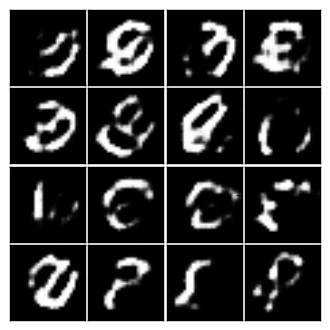

[2/500] D_loss: 1.3639 / G_loss: 1.3731


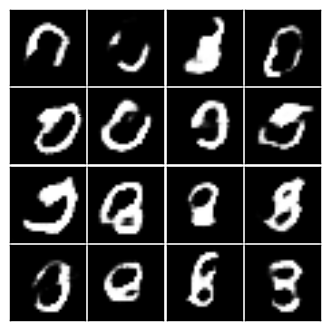

[3/500] D_loss: 1.3308 / G_loss: 0.5726


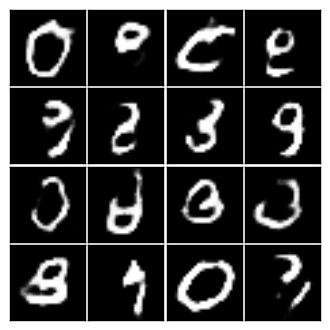

[4/500] D_loss: 1.3677 / G_loss: 0.9016


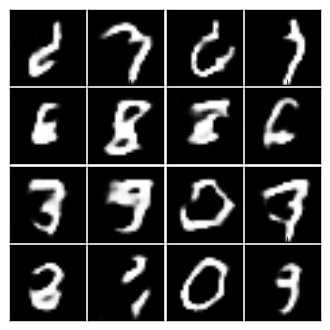

[5/500] D_loss: 1.2101 / G_loss: 1.0073


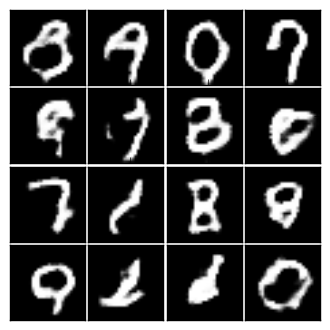

[6/500] D_loss: 1.3945 / G_loss: 0.8817


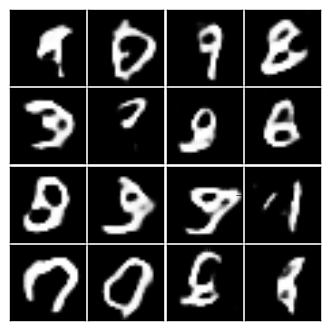

[7/500] D_loss: 1.4912 / G_loss: 0.3984


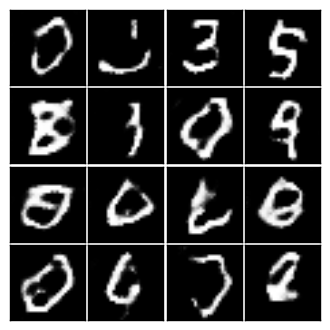

[8/500] D_loss: 1.3242 / G_loss: 0.9076


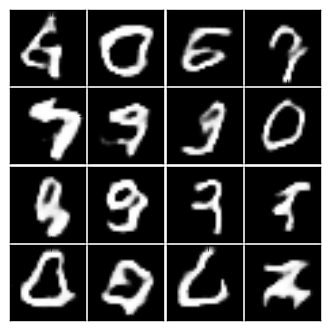

[9/500] D_loss: 1.3451 / G_loss: 0.6253


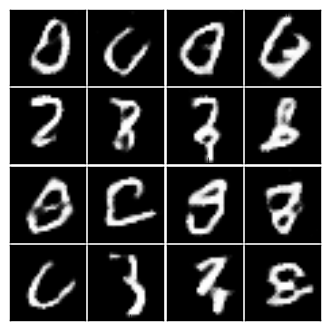

[10/500] D_loss: 1.3951 / G_loss: 0.8582


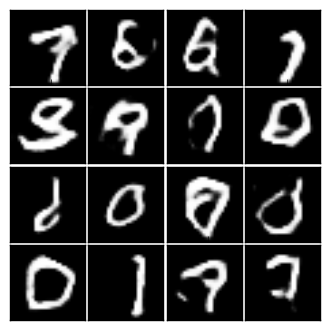

[11/500] D_loss: 1.4381 / G_loss: 1.3476


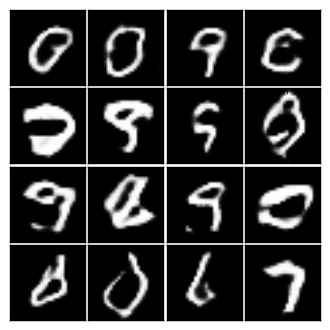

[12/500] D_loss: 1.2628 / G_loss: 0.7823


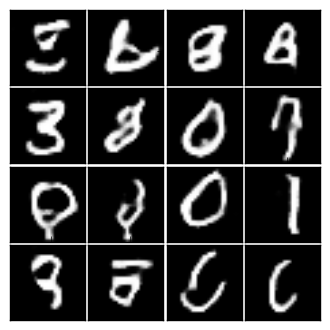

[13/500] D_loss: 1.3396 / G_loss: 0.5886


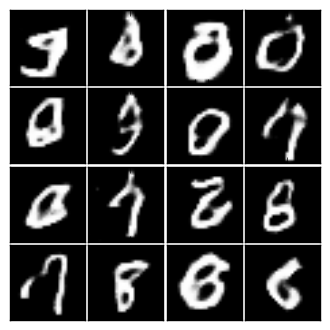

[14/500] D_loss: 1.3525 / G_loss: 0.8160


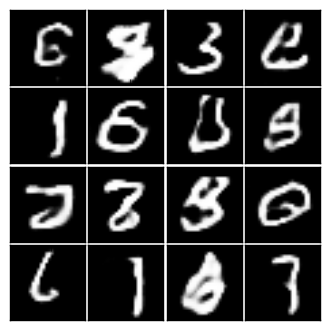

[15/500] D_loss: 1.1914 / G_loss: 0.9080


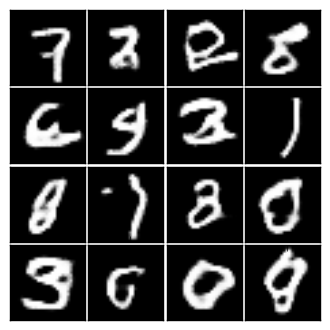

[16/500] D_loss: 1.2360 / G_loss: 0.8621


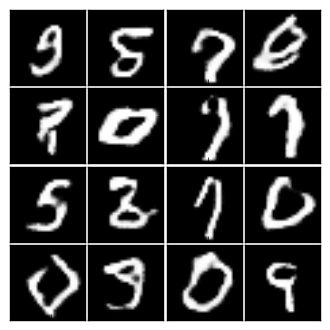

[17/500] D_loss: 1.2617 / G_loss: 1.1079


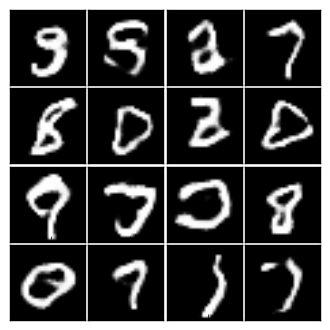

[18/500] D_loss: 1.3134 / G_loss: 0.6795


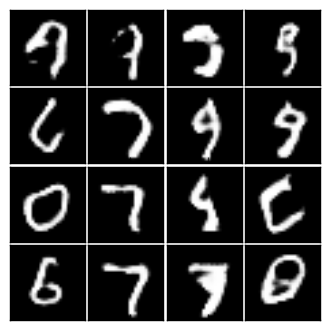

[19/500] D_loss: 1.6576 / G_loss: 0.3869


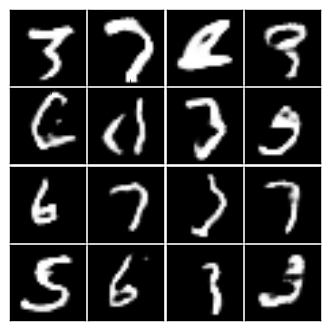

[20/500] D_loss: 1.3928 / G_loss: 0.6056


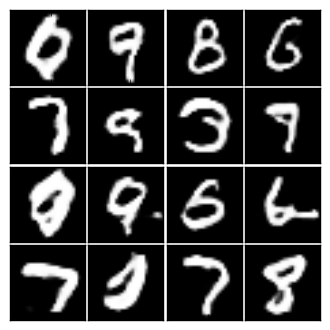

[21/500] D_loss: 1.3422 / G_loss: 0.6110


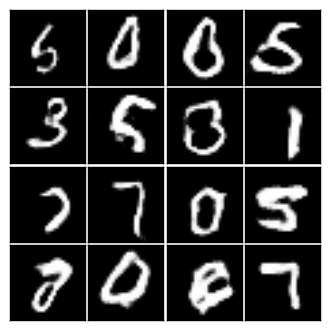

[22/500] D_loss: 1.2758 / G_loss: 0.8770


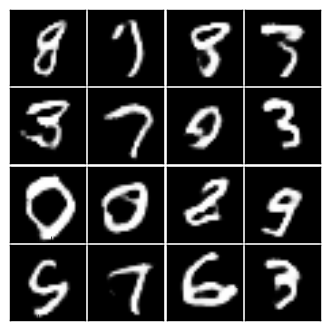

[23/500] D_loss: 1.3393 / G_loss: 1.2048


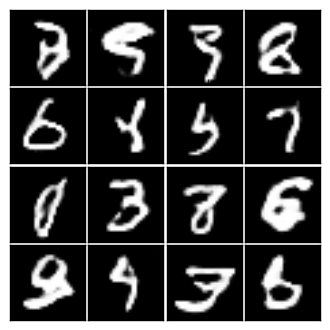

[24/500] D_loss: 1.3724 / G_loss: 0.8251


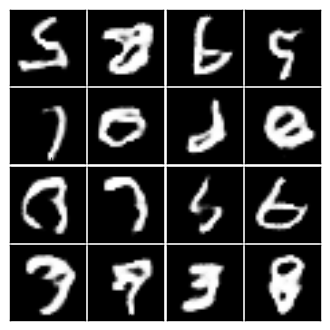

[25/500] D_loss: 1.3077 / G_loss: 0.9199


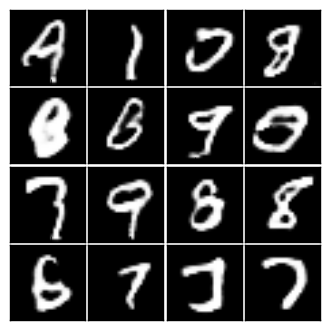

[26/500] D_loss: 1.2852 / G_loss: 0.8815


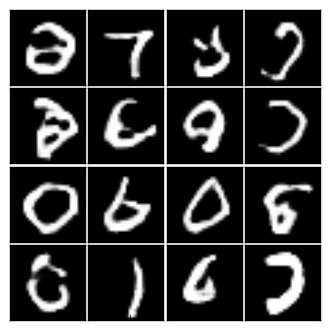

[27/500] D_loss: 1.3669 / G_loss: 0.6190


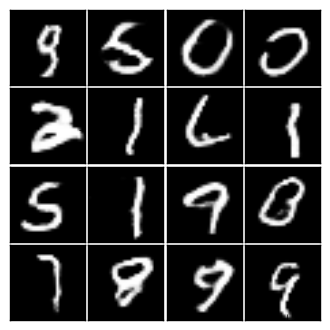

[28/500] D_loss: 1.2752 / G_loss: 0.6764


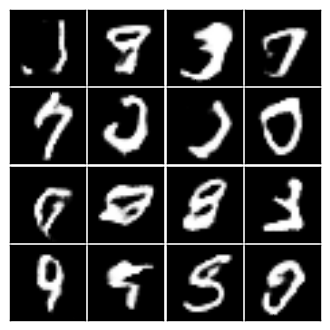

[29/500] D_loss: 1.3170 / G_loss: 0.8240


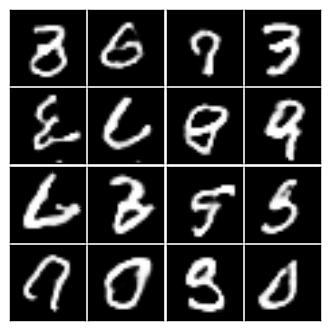

[30/500] D_loss: 1.3241 / G_loss: 0.9478


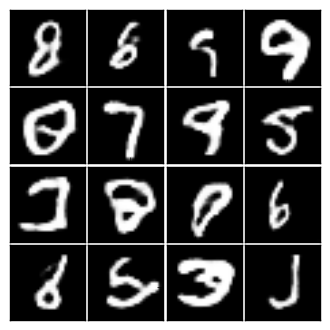

[31/500] D_loss: 1.2999 / G_loss: 0.7643


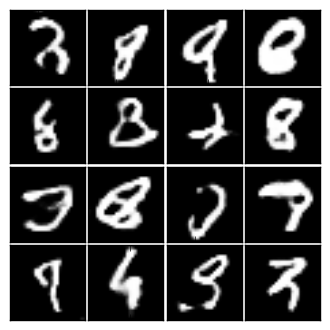

[32/500] D_loss: 1.3253 / G_loss: 0.6636


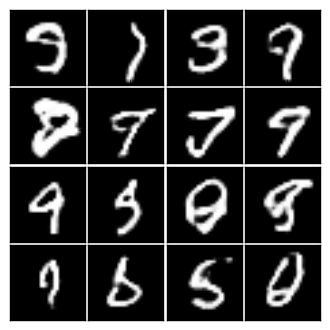

[33/500] D_loss: 1.3083 / G_loss: 0.6750


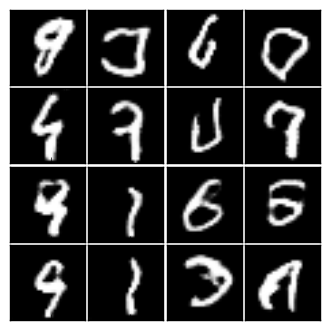

[34/500] D_loss: 1.3216 / G_loss: 0.9155


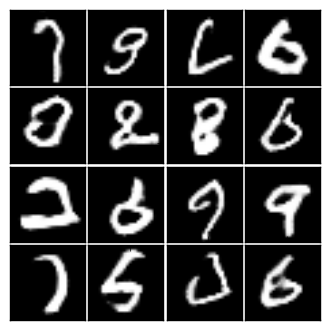

[35/500] D_loss: 1.3032 / G_loss: 1.0339


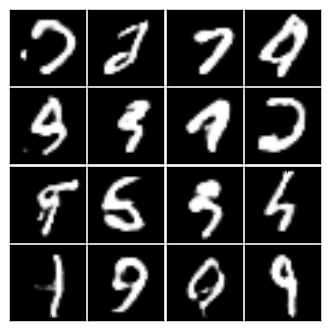

[36/500] D_loss: 1.3280 / G_loss: 0.8084


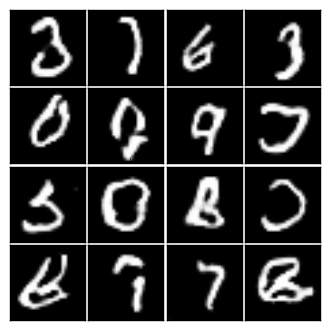

[37/500] D_loss: 1.4155 / G_loss: 0.8241


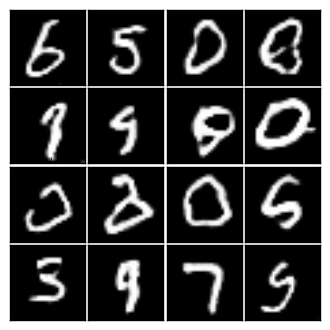

[38/500] D_loss: 1.4415 / G_loss: 0.5987


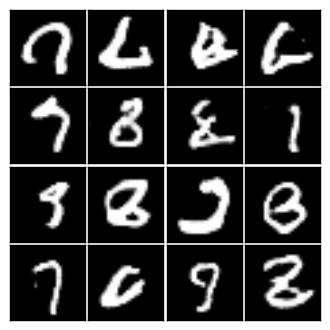

[39/500] D_loss: 1.3032 / G_loss: 0.7458


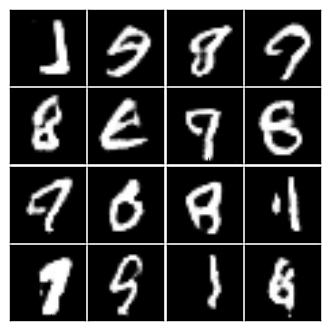

[40/500] D_loss: 1.2869 / G_loss: 0.9816


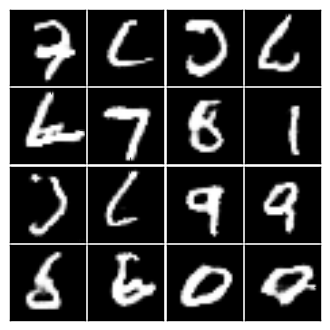

[41/500] D_loss: 1.3082 / G_loss: 0.8012


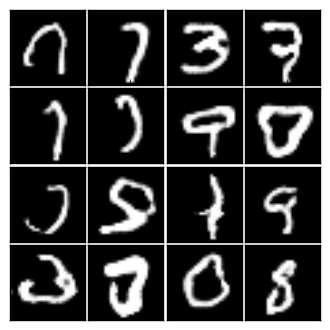

[42/500] D_loss: 1.3232 / G_loss: 0.9141


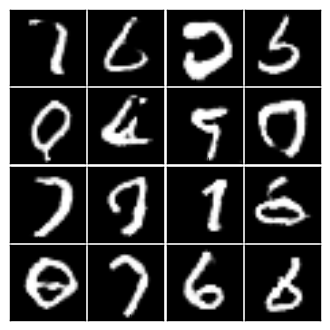

[43/500] D_loss: 1.3759 / G_loss: 1.3263


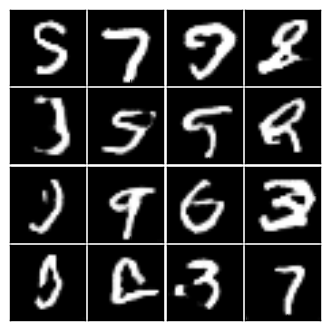

[44/500] D_loss: 1.3271 / G_loss: 0.8389


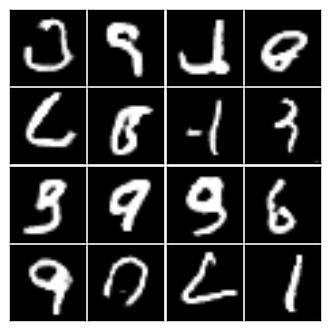

[45/500] D_loss: 1.2966 / G_loss: 0.7664


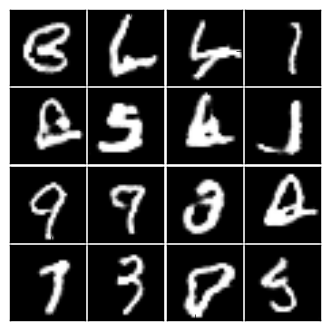

[46/500] D_loss: 1.3118 / G_loss: 1.1081


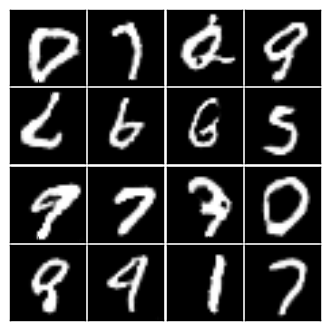

[47/500] D_loss: 1.2553 / G_loss: 0.8826


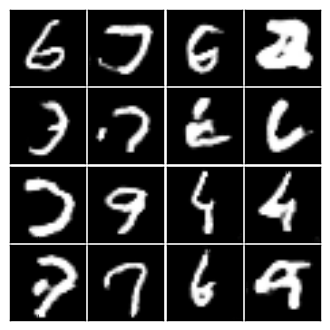

[48/500] D_loss: 1.3608 / G_loss: 1.1066


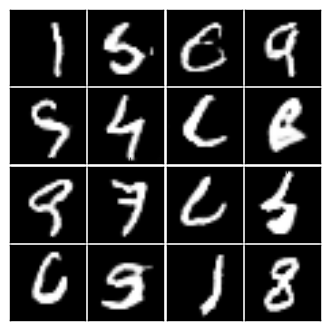

[49/500] D_loss: 1.3538 / G_loss: 1.1081


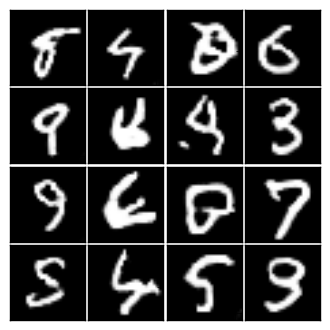

[50/500] D_loss: 1.3123 / G_loss: 0.7051


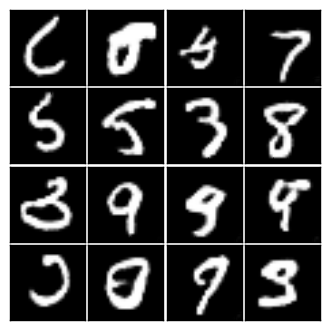

[51/500] D_loss: 1.4338 / G_loss: 0.7195


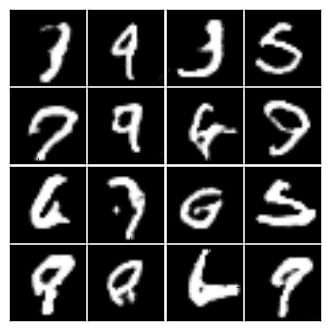

[52/500] D_loss: 1.3275 / G_loss: 0.7319


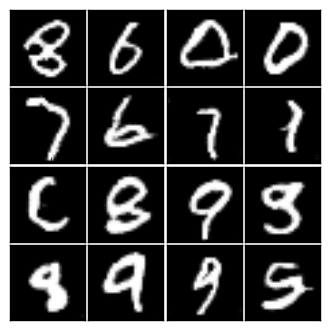

[53/500] D_loss: 1.3233 / G_loss: 0.7544


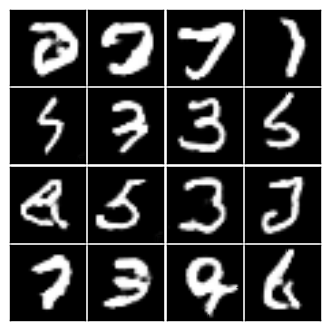

[54/500] D_loss: 1.4926 / G_loss: 0.9929


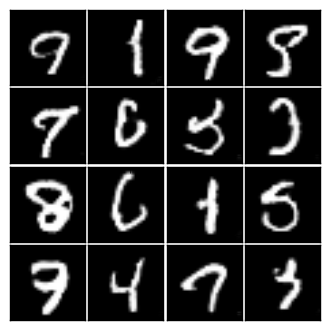

[55/500] D_loss: 1.4067 / G_loss: 0.6954


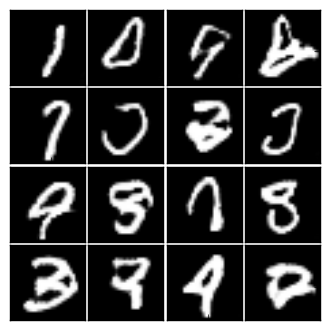

[56/500] D_loss: 1.3228 / G_loss: 0.9383


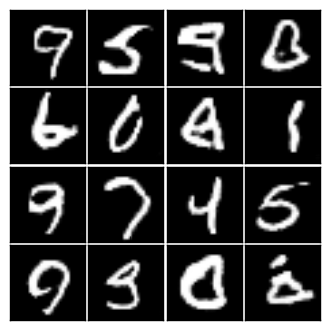

[57/500] D_loss: 1.4400 / G_loss: 1.2692


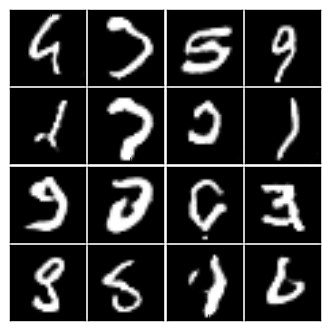

[58/500] D_loss: 1.3209 / G_loss: 0.8013


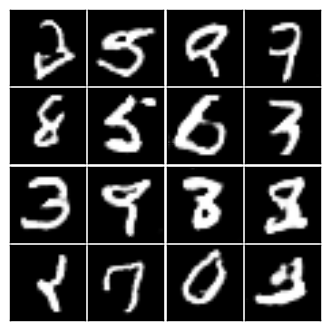

[59/500] D_loss: 1.3336 / G_loss: 0.8264


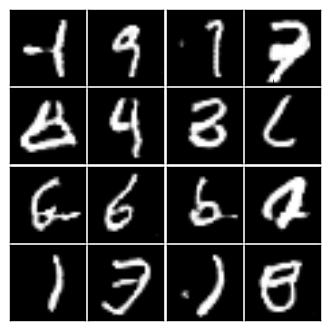

[60/500] D_loss: 1.4504 / G_loss: 1.0183


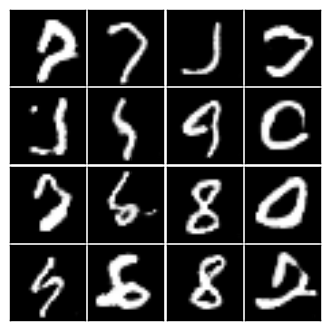

[61/500] D_loss: 1.3265 / G_loss: 0.8995


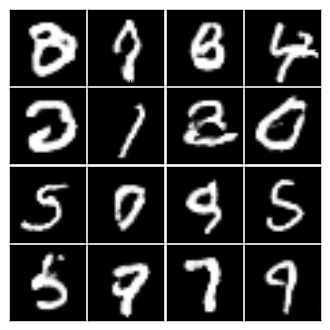

[62/500] D_loss: 1.4265 / G_loss: 0.7485


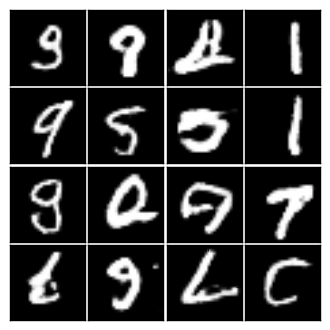

[63/500] D_loss: 1.3268 / G_loss: 0.7593


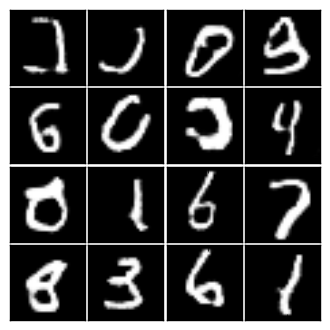

[64/500] D_loss: 1.3739 / G_loss: 0.8039


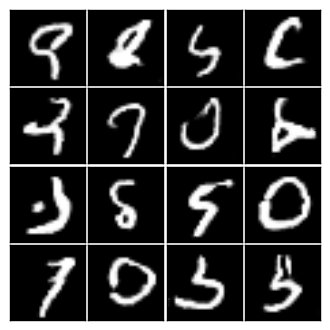

[65/500] D_loss: 1.3416 / G_loss: 0.9024


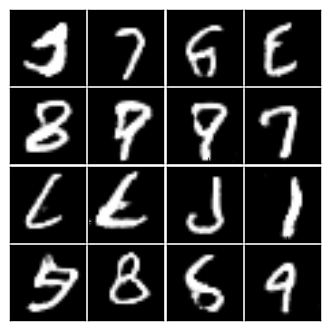

[66/500] D_loss: 1.3522 / G_loss: 0.8826


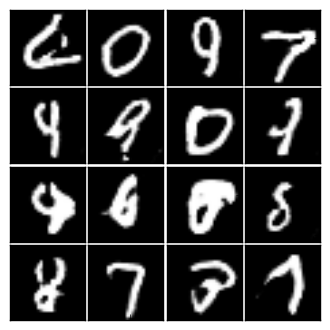

[67/500] D_loss: 1.3149 / G_loss: 0.8789


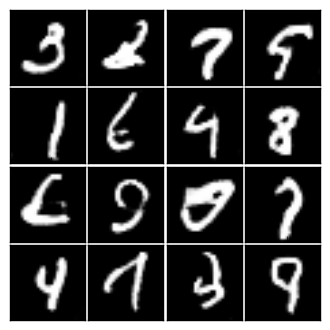

[68/500] D_loss: 1.3214 / G_loss: 0.9835


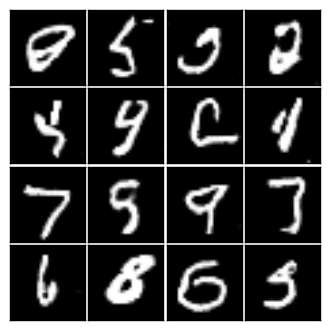

[69/500] D_loss: 1.4765 / G_loss: 0.6016


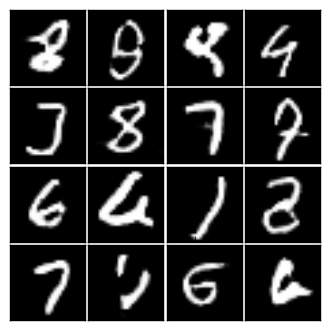

[70/500] D_loss: 1.3394 / G_loss: 1.1489


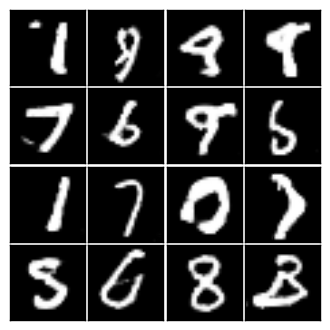

[71/500] D_loss: 1.3598 / G_loss: 0.7394


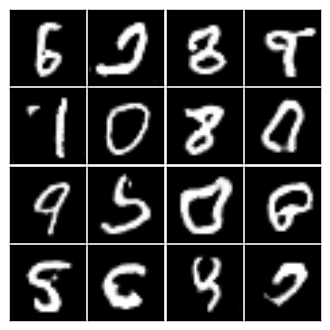

[72/500] D_loss: 1.4951 / G_loss: 0.8456


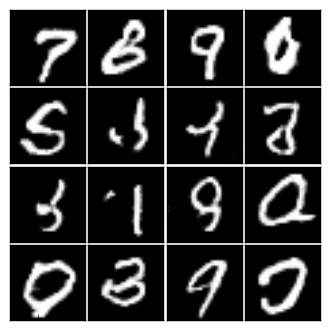

[73/500] D_loss: 1.3443 / G_loss: 0.9446


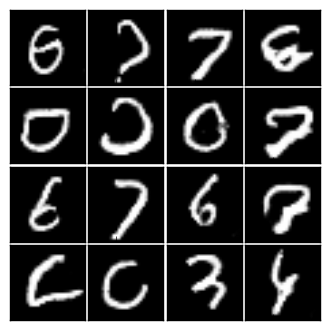

[74/500] D_loss: 1.4959 / G_loss: 0.9974


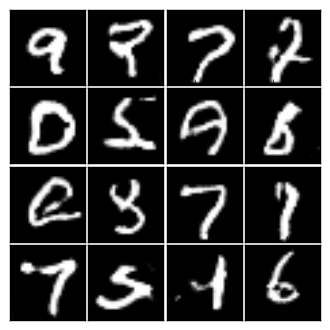

[75/500] D_loss: 1.3396 / G_loss: 0.7648


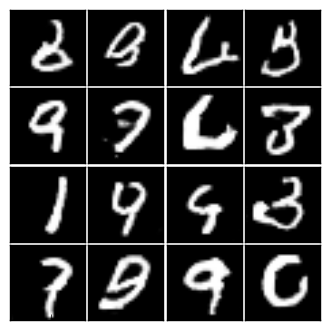

[76/500] D_loss: 1.3702 / G_loss: 1.1328


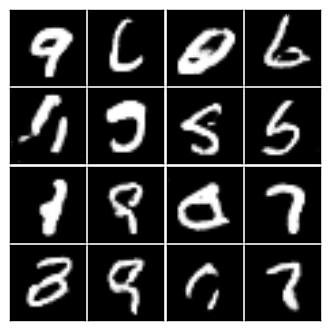

[77/500] D_loss: 1.4685 / G_loss: 0.7254


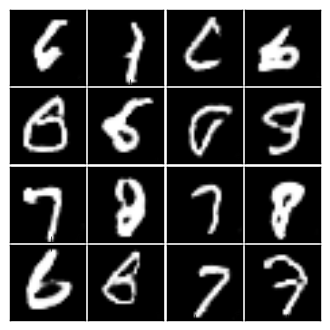

[78/500] D_loss: 1.3657 / G_loss: 0.9402


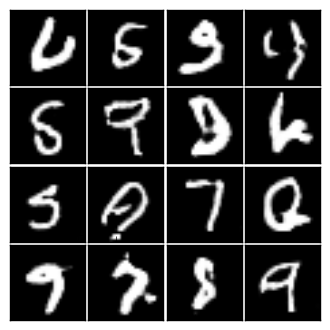

[79/500] D_loss: 1.3938 / G_loss: 0.7276


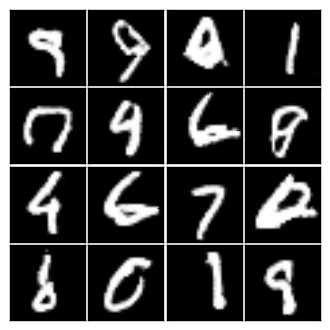

[80/500] D_loss: 1.3444 / G_loss: 0.7514


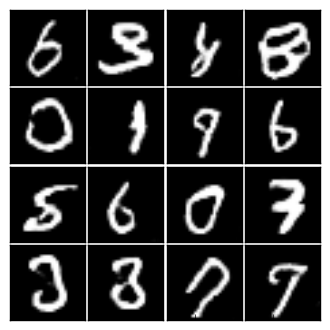

[81/500] D_loss: 1.4036 / G_loss: 0.7203


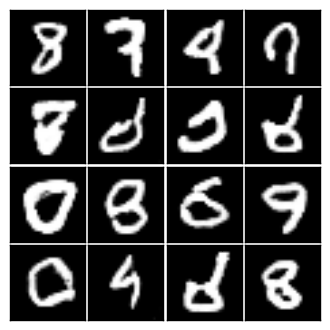

[82/500] D_loss: 1.4178 / G_loss: 0.8449


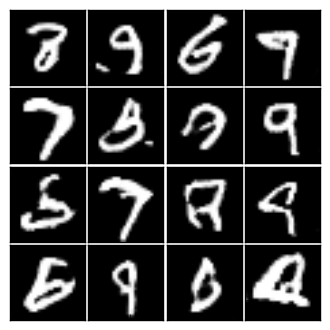

[83/500] D_loss: 1.3879 / G_loss: 0.7533


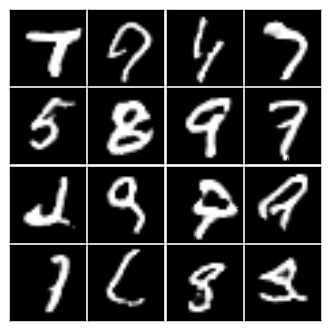

[84/500] D_loss: 1.3638 / G_loss: 0.7184


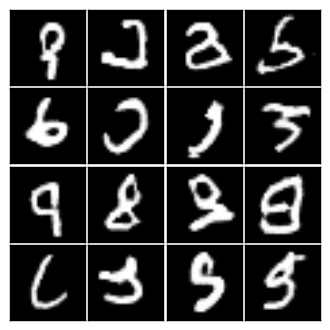

[85/500] D_loss: 1.4574 / G_loss: 1.0589


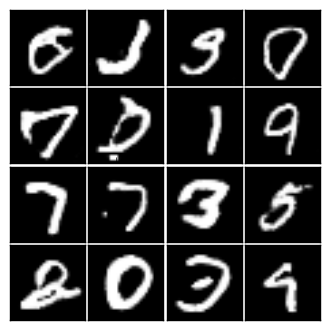

[86/500] D_loss: 1.6078 / G_loss: 0.7177


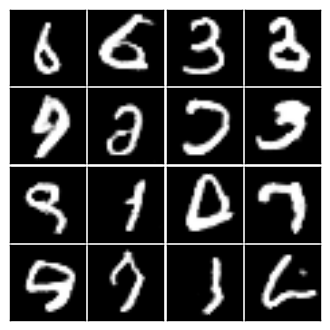

[87/500] D_loss: 1.3896 / G_loss: 1.2234


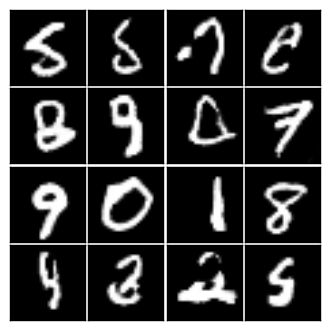

[88/500] D_loss: 1.3953 / G_loss: 1.2923


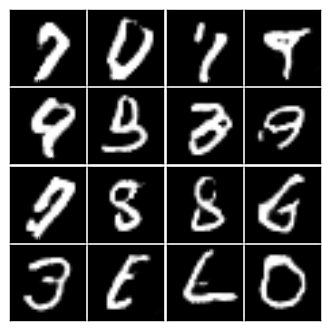

[89/500] D_loss: 1.6402 / G_loss: 0.6703


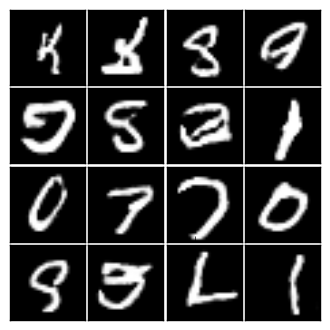

[90/500] D_loss: 1.4284 / G_loss: 0.6190


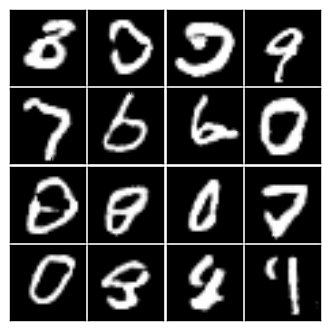

[91/500] D_loss: 1.3445 / G_loss: 0.8305


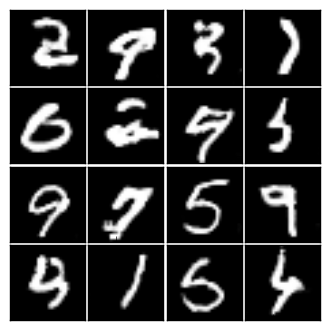

[92/500] D_loss: 1.3313 / G_loss: 0.8762


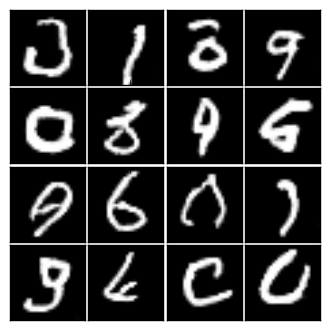

[93/500] D_loss: 1.5231 / G_loss: 0.7932


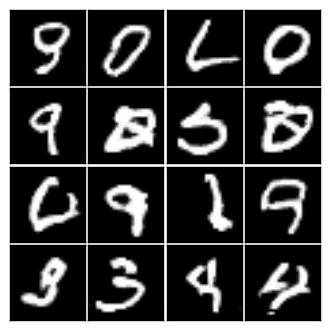

[94/500] D_loss: 1.5403 / G_loss: 0.8820


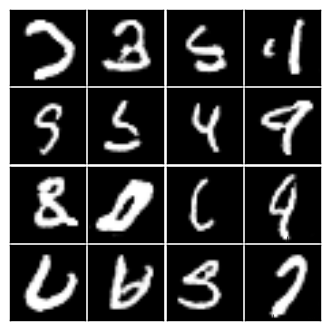

[95/500] D_loss: 1.4679 / G_loss: 1.1506


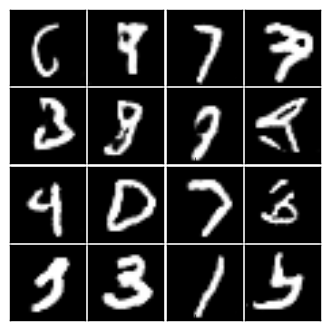

[96/500] D_loss: 1.5414 / G_loss: 0.7740


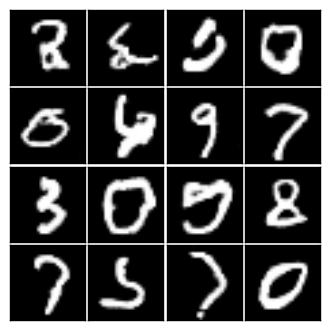

[97/500] D_loss: 1.3856 / G_loss: 0.8605


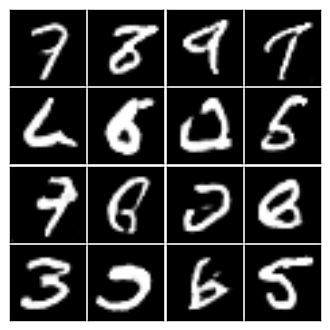

[98/500] D_loss: 1.3925 / G_loss: 0.8890


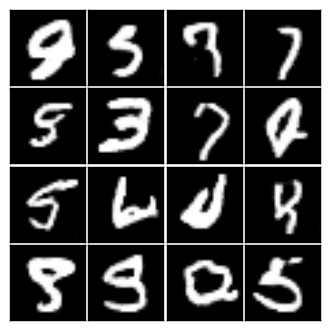

[99/500] D_loss: 1.4511 / G_loss: 1.2620


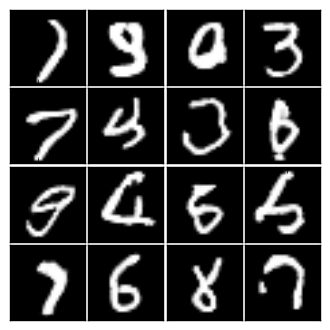

[100/500] D_loss: 1.4243 / G_loss: 0.8809


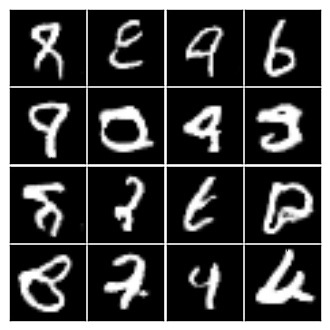

[101/500] D_loss: 1.4863 / G_loss: 0.7109


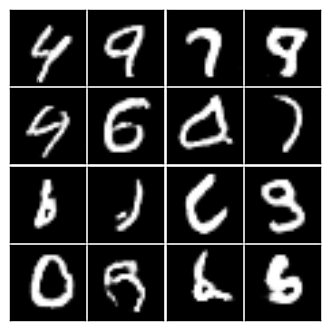

[102/500] D_loss: 1.4249 / G_loss: 1.0185


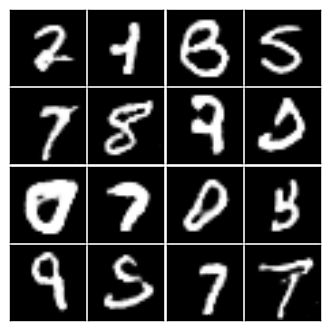

[103/500] D_loss: 1.3577 / G_loss: 0.7803


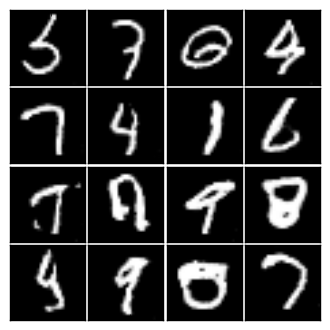

[104/500] D_loss: 1.3574 / G_loss: 1.1147


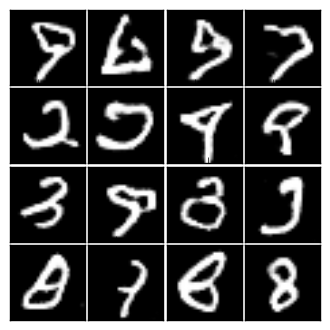

[105/500] D_loss: 1.5004 / G_loss: 0.7219


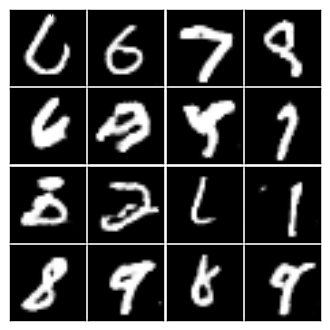

[106/500] D_loss: 1.3895 / G_loss: 0.7224


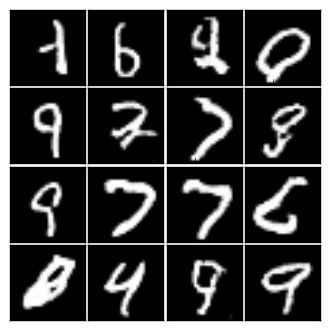

[107/500] D_loss: 1.3560 / G_loss: 0.8363


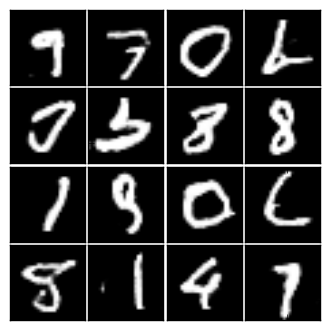

[108/500] D_loss: 1.4182 / G_loss: 0.5602


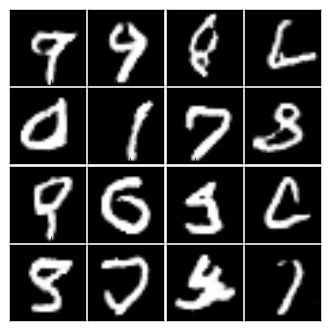

[109/500] D_loss: 1.4836 / G_loss: 0.6299


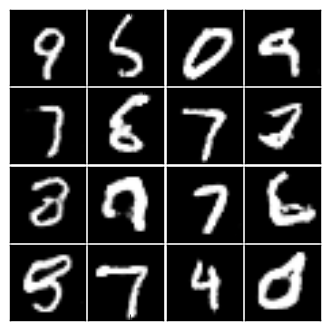

[110/500] D_loss: 1.4801 / G_loss: 1.2527


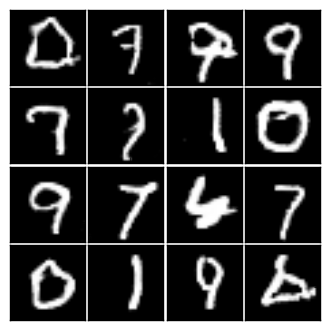

[111/500] D_loss: 1.4515 / G_loss: 0.5566


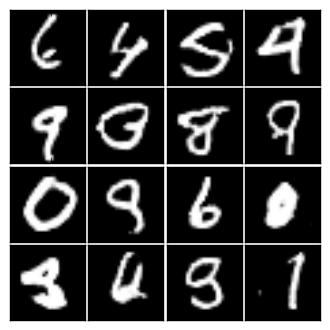

[112/500] D_loss: 1.3614 / G_loss: 0.7485


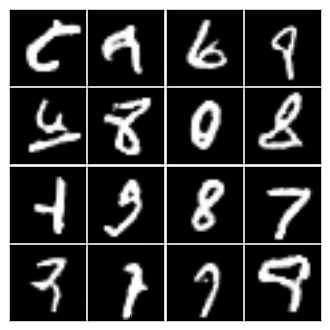

[113/500] D_loss: 1.5464 / G_loss: 0.5393


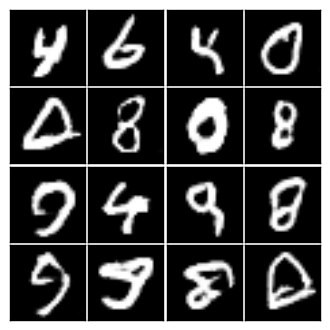

[114/500] D_loss: 1.3326 / G_loss: 0.8323


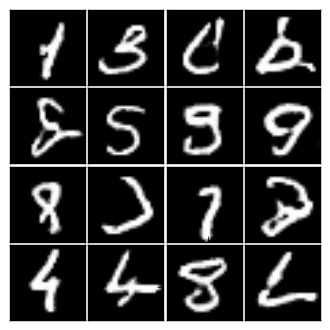

[115/500] D_loss: 1.3112 / G_loss: 0.9717


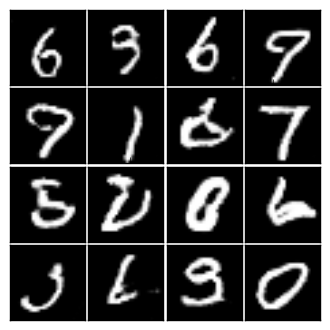

[116/500] D_loss: 1.3403 / G_loss: 0.9207


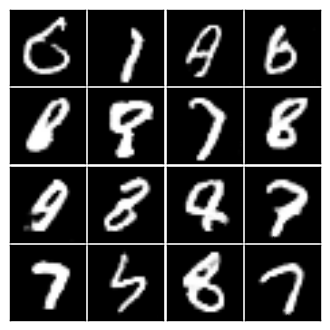

[117/500] D_loss: 1.3353 / G_loss: 0.6979


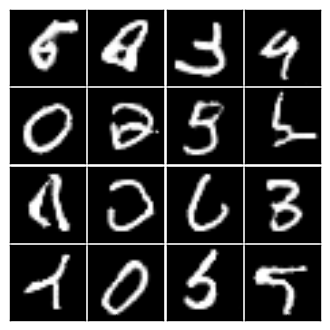

[118/500] D_loss: 1.3817 / G_loss: 1.0905


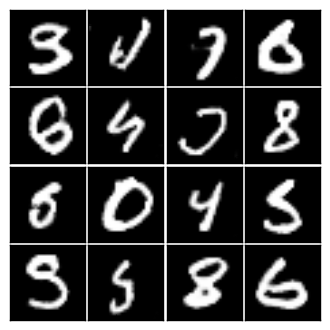

[119/500] D_loss: 1.3812 / G_loss: 0.7157


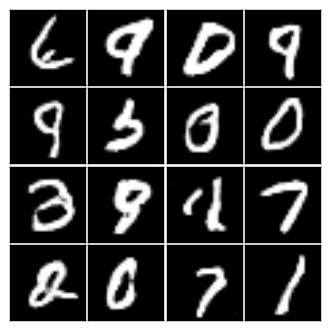

[120/500] D_loss: 1.4191 / G_loss: 0.9247


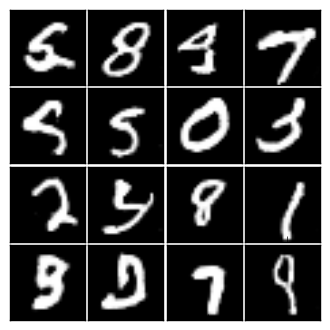

[121/500] D_loss: 1.3867 / G_loss: 0.8260


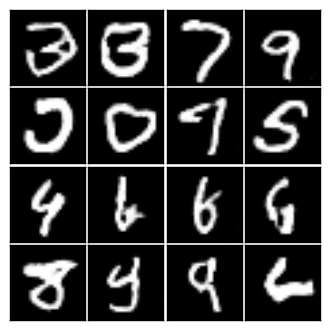

[122/500] D_loss: 1.3531 / G_loss: 0.8517


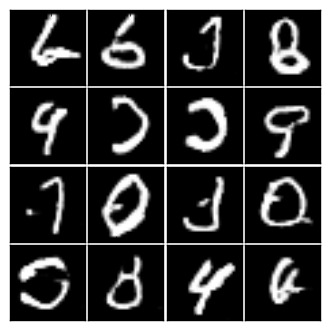

[123/500] D_loss: 1.4015 / G_loss: 0.7476


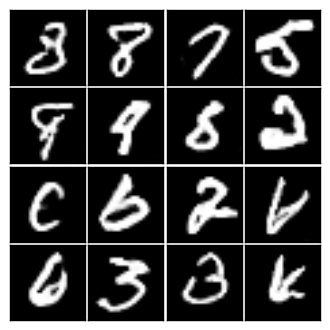

[124/500] D_loss: 1.3860 / G_loss: 0.7003


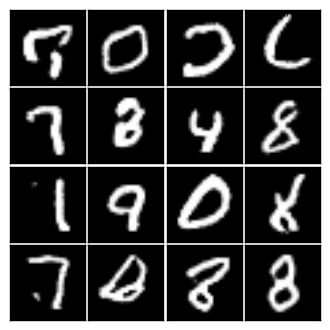

[125/500] D_loss: 1.3555 / G_loss: 0.7896


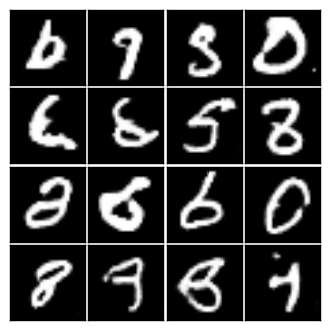

[126/500] D_loss: 1.4429 / G_loss: 0.8854


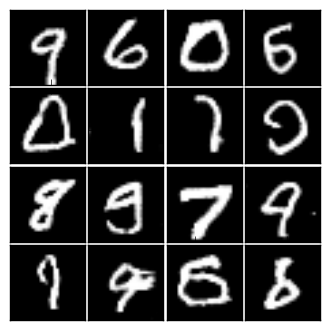

[127/500] D_loss: 1.3971 / G_loss: 1.1102


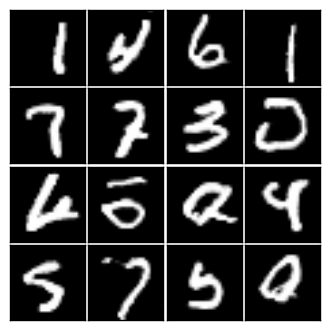

[128/500] D_loss: 1.4677 / G_loss: 0.7105


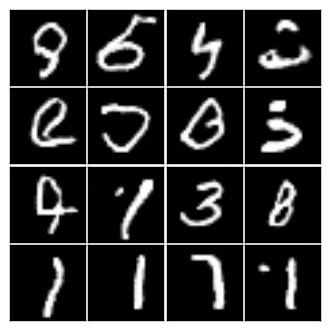

[129/500] D_loss: 1.3927 / G_loss: 0.7572


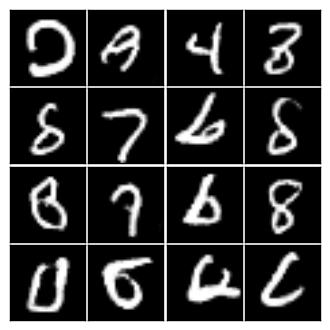

[130/500] D_loss: 1.4733 / G_loss: 0.7094


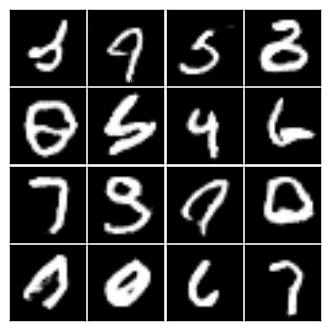

[131/500] D_loss: 1.4671 / G_loss: 0.7055


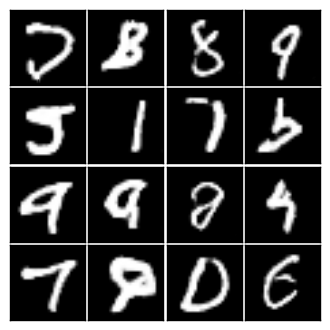

[132/500] D_loss: 1.5744 / G_loss: 0.7516


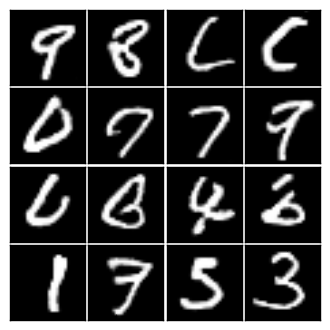

[133/500] D_loss: 1.4990 / G_loss: 1.2353


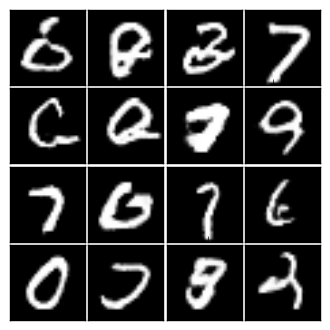

[134/500] D_loss: 1.4277 / G_loss: 0.5780


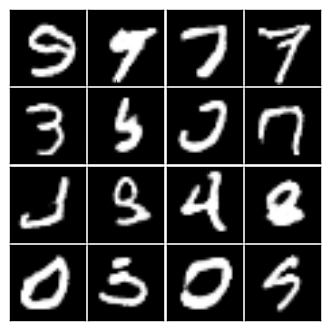

[135/500] D_loss: 1.3326 / G_loss: 0.8596


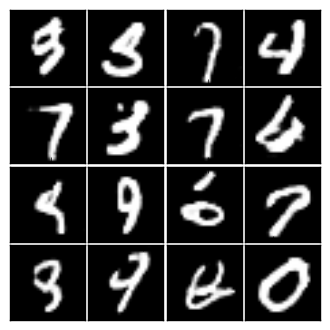

[136/500] D_loss: 1.5832 / G_loss: 0.7126


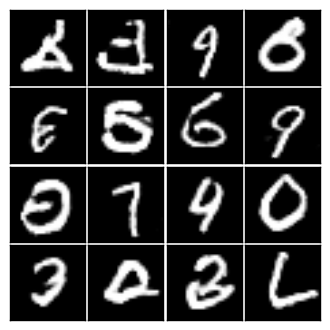

[137/500] D_loss: 1.4740 / G_loss: 1.1501


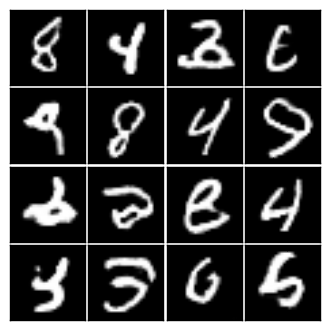

[138/500] D_loss: 1.4857 / G_loss: 0.6615


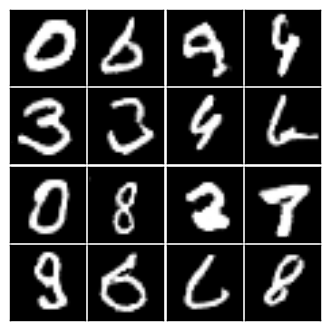

[139/500] D_loss: 1.4312 / G_loss: 0.6349


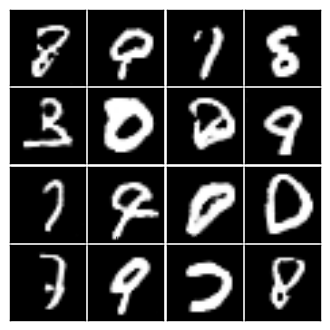

[140/500] D_loss: 1.3751 / G_loss: 0.7979


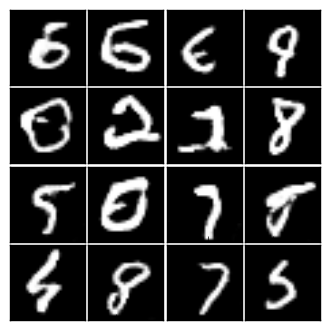

[141/500] D_loss: 1.5346 / G_loss: 0.6127


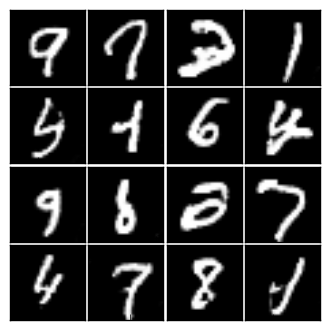

[142/500] D_loss: 1.3417 / G_loss: 0.8954


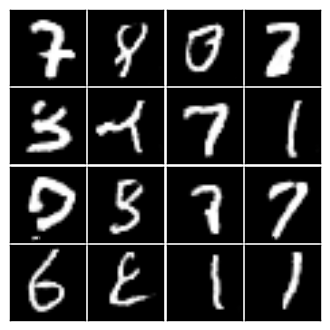

[143/500] D_loss: 1.4977 / G_loss: 0.5854


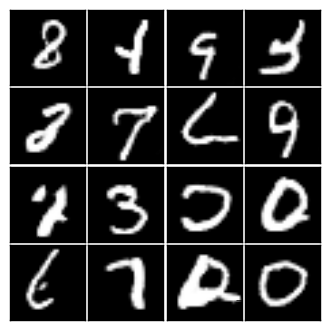

[144/500] D_loss: 1.5444 / G_loss: 0.6484


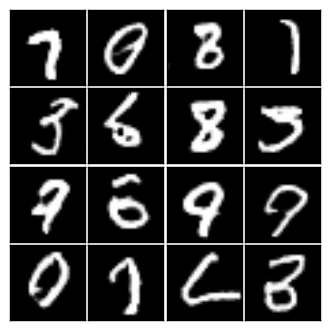

[145/500] D_loss: 1.4347 / G_loss: 0.6987


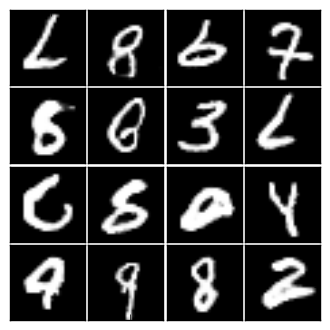

[146/500] D_loss: 1.3255 / G_loss: 0.8375


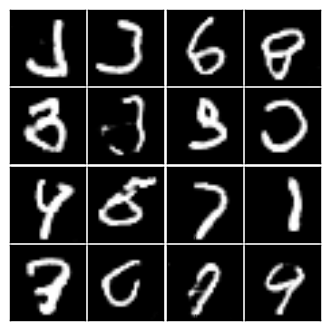

[147/500] D_loss: 1.6043 / G_loss: 0.7959


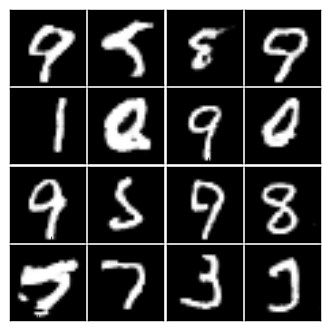

[148/500] D_loss: 1.5253 / G_loss: 0.9346


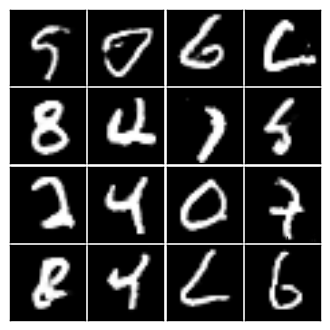

[149/500] D_loss: 1.3247 / G_loss: 0.9027


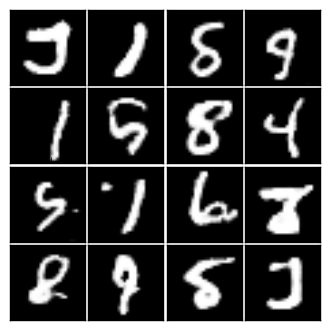

[150/500] D_loss: 1.4399 / G_loss: 0.9928


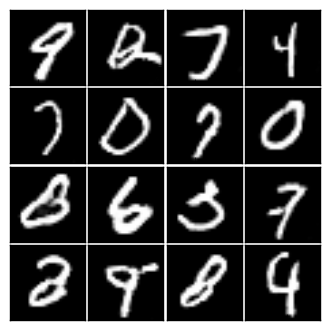

[151/500] D_loss: 1.3571 / G_loss: 0.9100


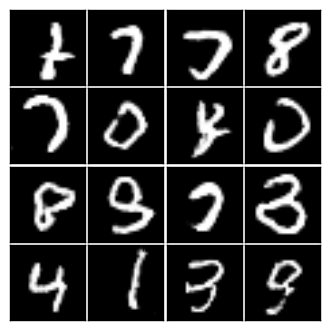

[152/500] D_loss: 1.6530 / G_loss: 0.6441


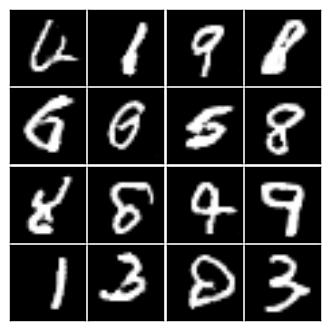

[153/500] D_loss: 1.3619 / G_loss: 0.8018


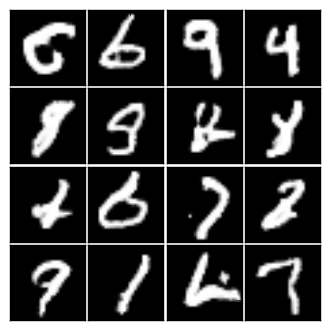

[154/500] D_loss: 1.3433 / G_loss: 1.1583


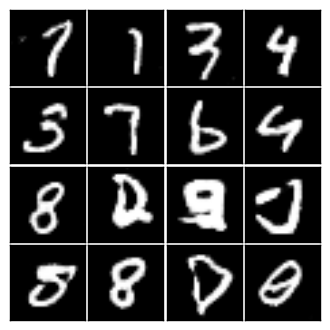

[155/500] D_loss: 1.5127 / G_loss: 1.3871


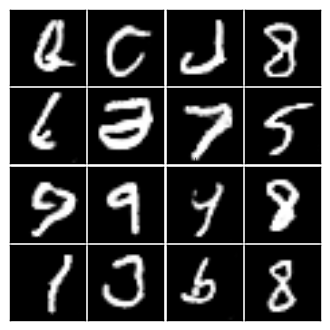

[156/500] D_loss: 1.3393 / G_loss: 0.9649


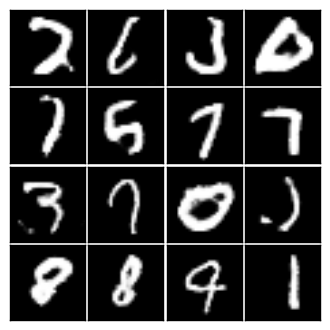

[157/500] D_loss: 1.3684 / G_loss: 0.8862


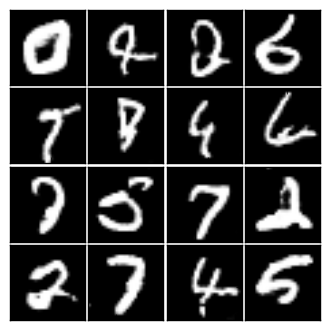

[158/500] D_loss: 1.4052 / G_loss: 1.0604


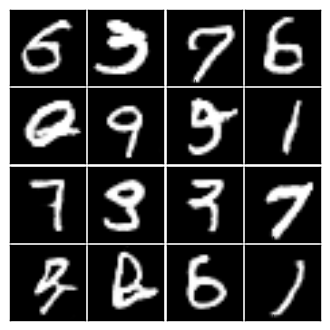

[159/500] D_loss: 1.4621 / G_loss: 0.8368


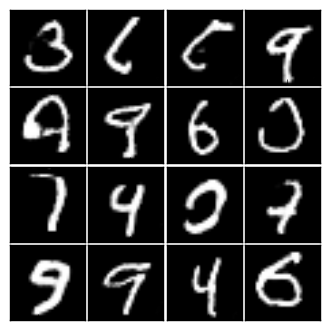

[160/500] D_loss: 1.4094 / G_loss: 0.6927


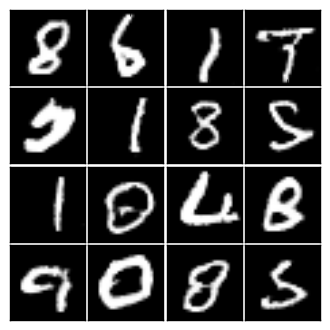

[161/500] D_loss: 1.4483 / G_loss: 0.7065


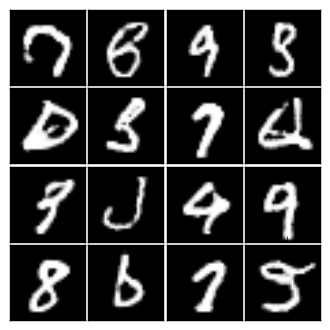

[162/500] D_loss: 1.4212 / G_loss: 0.7600


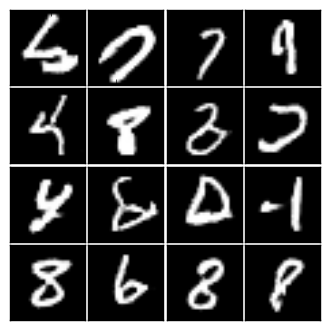

[163/500] D_loss: 1.4276 / G_loss: 0.7496


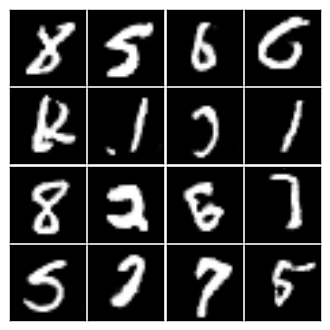

[164/500] D_loss: 1.4555 / G_loss: 0.6112


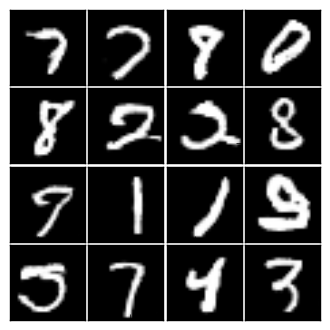

[165/500] D_loss: 1.3361 / G_loss: 0.8765


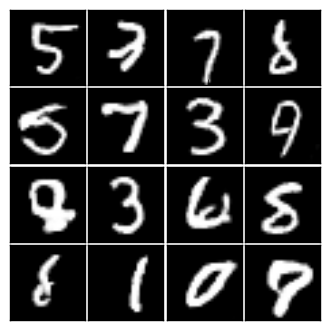

[166/500] D_loss: 1.4352 / G_loss: 1.1362


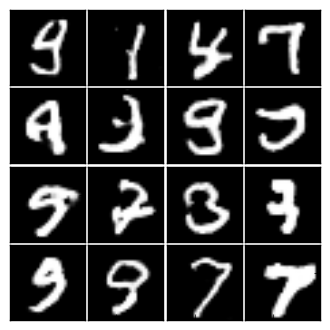

[167/500] D_loss: 1.3383 / G_loss: 0.7314


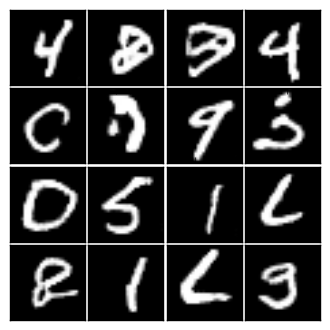

[168/500] D_loss: 1.4903 / G_loss: 0.6600


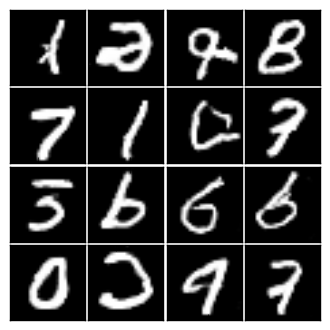

[169/500] D_loss: 1.3693 / G_loss: 0.9636


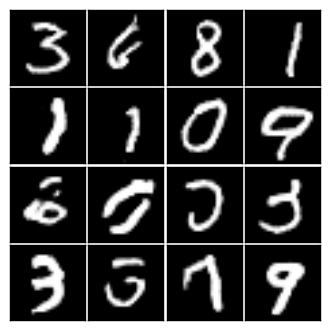

[170/500] D_loss: 1.4421 / G_loss: 0.6757


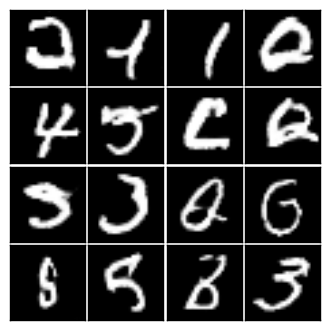

[171/500] D_loss: 1.3287 / G_loss: 0.8661


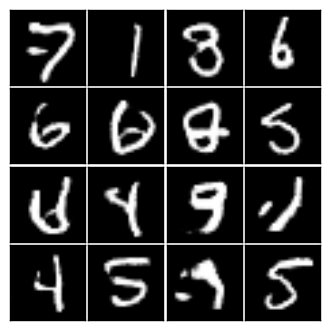

[172/500] D_loss: 1.4265 / G_loss: 0.7655


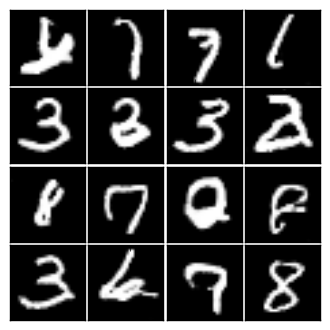

[173/500] D_loss: 1.4924 / G_loss: 1.0819


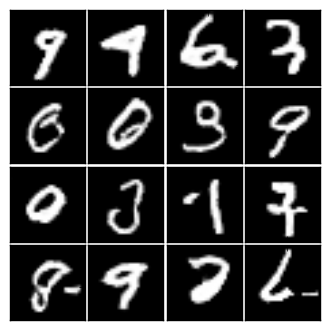

[174/500] D_loss: 1.4122 / G_loss: 0.6647


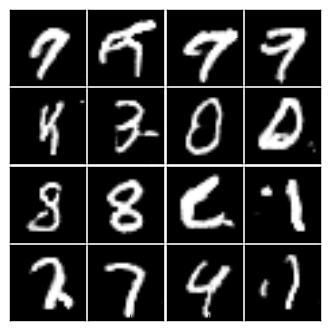

[175/500] D_loss: 1.5119 / G_loss: 0.8994


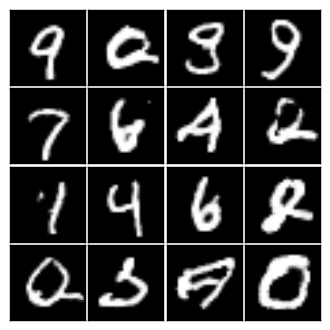

[176/500] D_loss: 1.3677 / G_loss: 0.9351


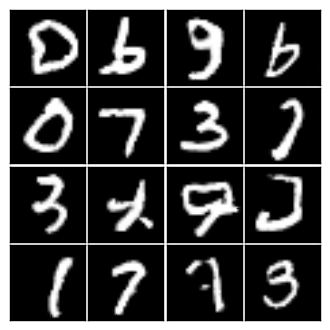

[177/500] D_loss: 1.4123 / G_loss: 0.8709


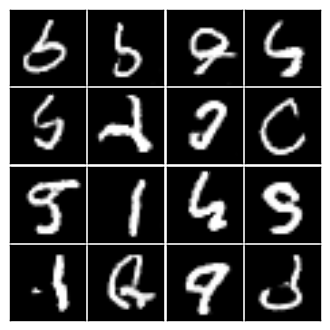

[178/500] D_loss: 1.4101 / G_loss: 0.6794


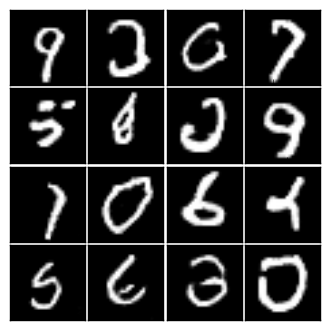

[179/500] D_loss: 1.4063 / G_loss: 0.8521


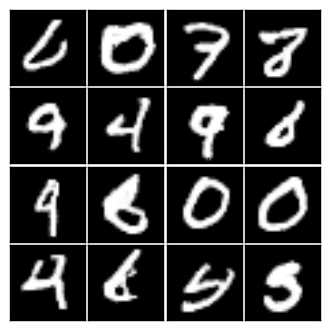

[180/500] D_loss: 1.5041 / G_loss: 0.6793


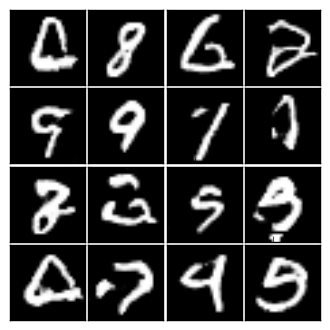

[181/500] D_loss: 1.4379 / G_loss: 0.6532


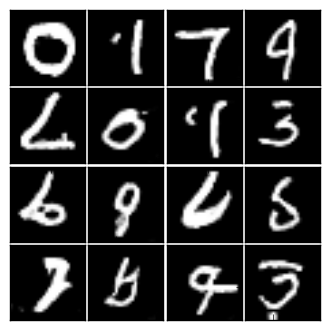

[182/500] D_loss: 1.4525 / G_loss: 0.8104


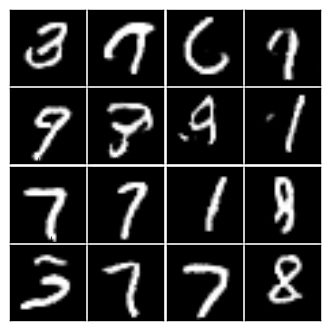

[183/500] D_loss: 1.4014 / G_loss: 0.6470


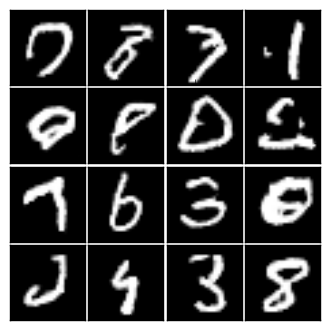

[184/500] D_loss: 1.5319 / G_loss: 0.5894


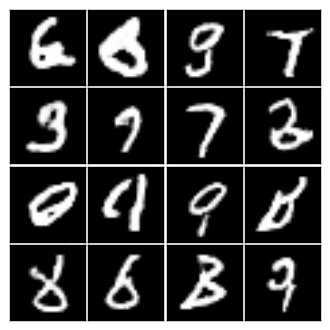

[185/500] D_loss: 1.3521 / G_loss: 1.0252


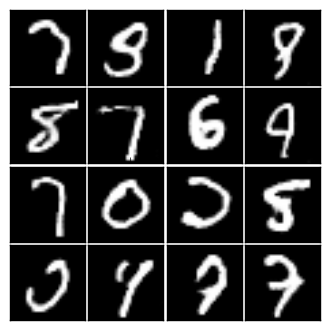

[186/500] D_loss: 1.4254 / G_loss: 1.0693


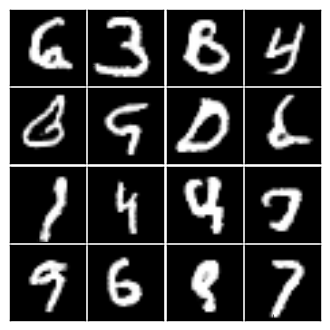

[187/500] D_loss: 1.5197 / G_loss: 0.5510


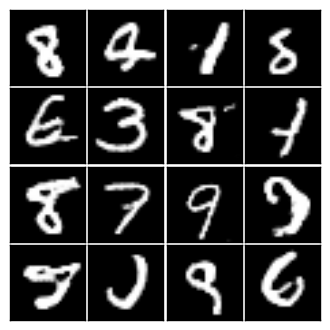

[188/500] D_loss: 1.5253 / G_loss: 0.7971


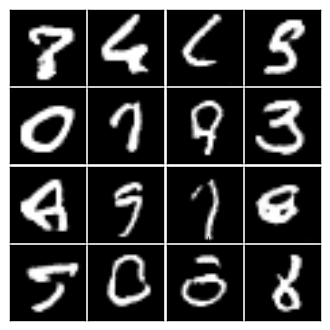

[189/500] D_loss: 1.4484 / G_loss: 0.9363


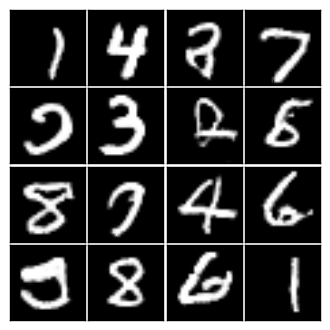

[190/500] D_loss: 1.4893 / G_loss: 1.0718


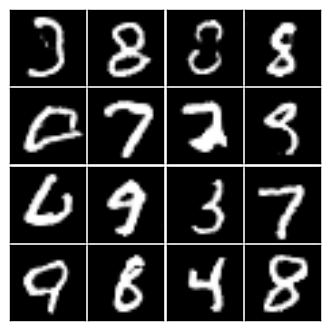

[191/500] D_loss: 1.4001 / G_loss: 0.9184


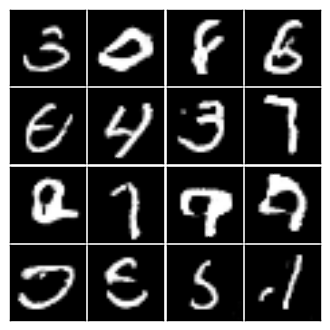

[192/500] D_loss: 1.5596 / G_loss: 0.8905


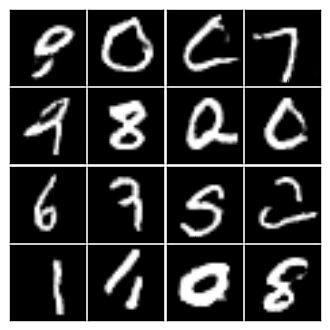

[193/500] D_loss: 1.4081 / G_loss: 0.7522


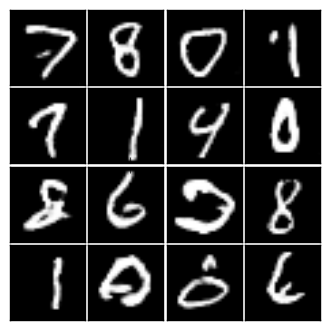

[194/500] D_loss: 1.4703 / G_loss: 0.6122


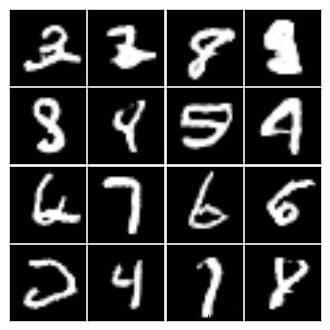

[195/500] D_loss: 1.4426 / G_loss: 0.6178


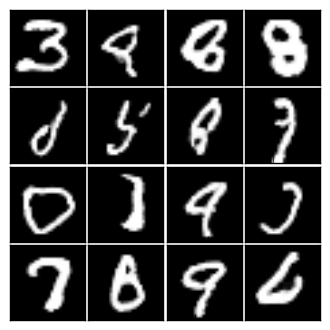

[196/500] D_loss: 1.4411 / G_loss: 1.0514


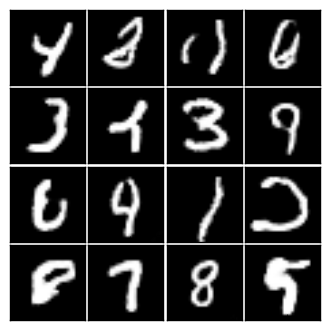

[197/500] D_loss: 1.6521 / G_loss: 1.2465


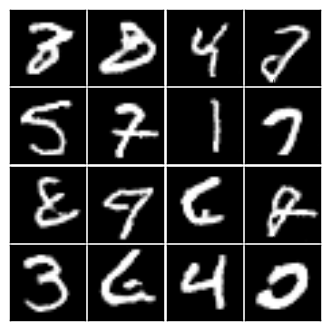

[198/500] D_loss: 1.4869 / G_loss: 0.5260


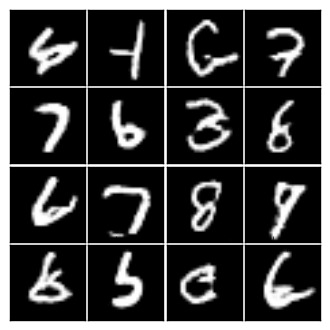

[199/500] D_loss: 1.3527 / G_loss: 0.9089


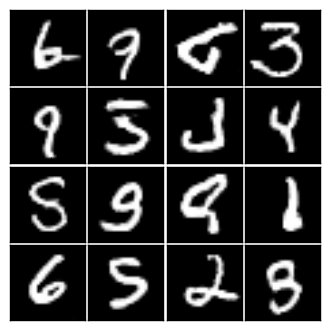

[200/500] D_loss: 1.4053 / G_loss: 1.0178


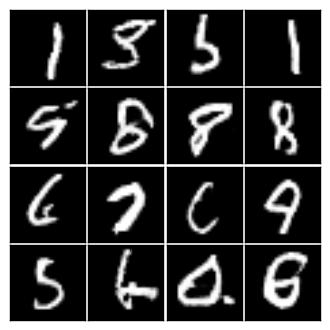

[201/500] D_loss: 1.6693 / G_loss: 0.7692


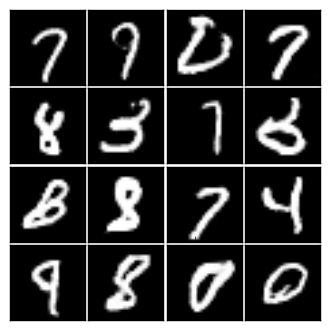

[202/500] D_loss: 1.4849 / G_loss: 0.6697


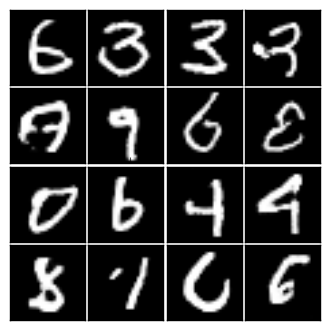

[203/500] D_loss: 1.5159 / G_loss: 0.7588


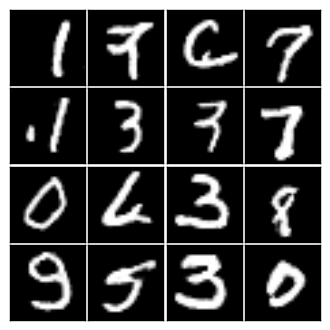

[204/500] D_loss: 1.3993 / G_loss: 0.8510


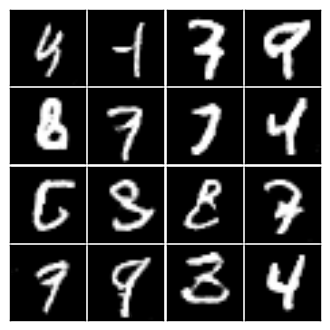

[205/500] D_loss: 1.3124 / G_loss: 0.8516


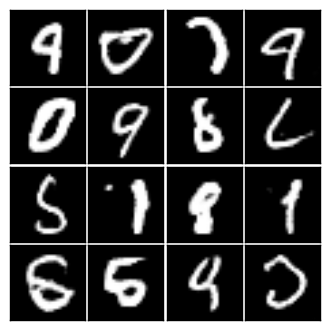

[206/500] D_loss: 1.3718 / G_loss: 0.6419


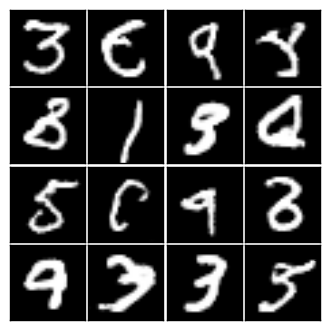

[207/500] D_loss: 1.3306 / G_loss: 0.8869


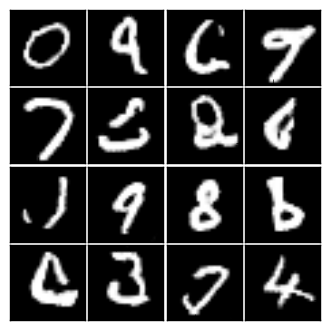

[208/500] D_loss: 1.3669 / G_loss: 1.0576


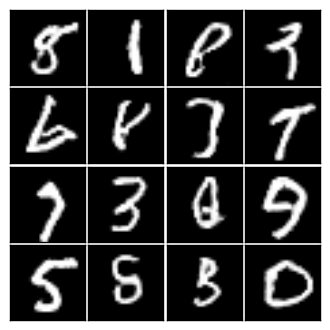

[209/500] D_loss: 1.6392 / G_loss: 0.4943


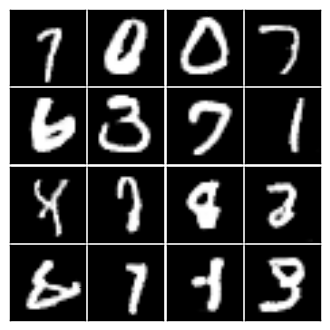

[210/500] D_loss: 1.3873 / G_loss: 1.0674


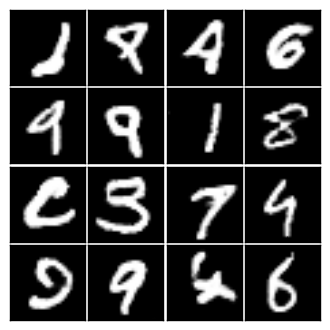

[211/500] D_loss: 1.4366 / G_loss: 0.6254


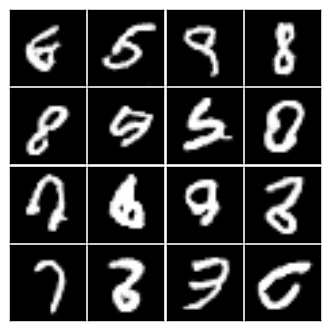

[212/500] D_loss: 1.3860 / G_loss: 0.7924


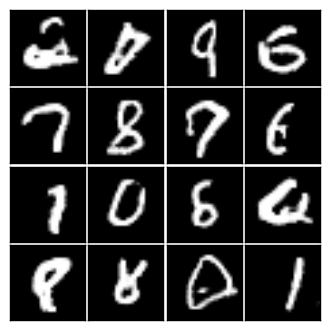

[213/500] D_loss: 1.4327 / G_loss: 0.7249


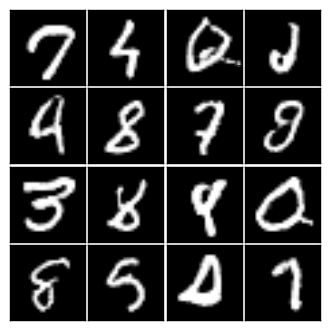

[214/500] D_loss: 1.6527 / G_loss: 0.4113


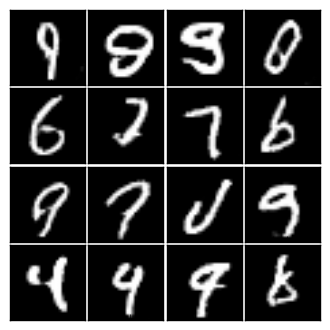

[215/500] D_loss: 1.5098 / G_loss: 0.6405


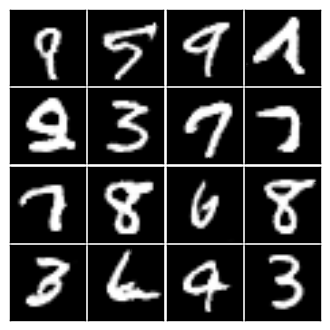

[216/500] D_loss: 1.3494 / G_loss: 0.7475


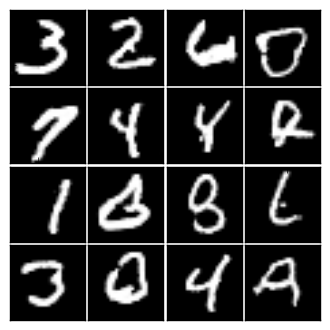

[217/500] D_loss: 1.5571 / G_loss: 0.5059


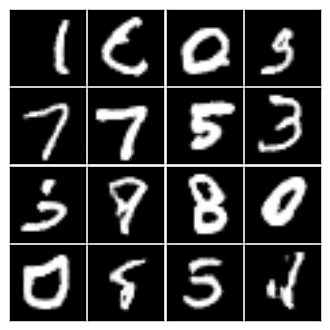

[218/500] D_loss: 1.3822 / G_loss: 0.7757


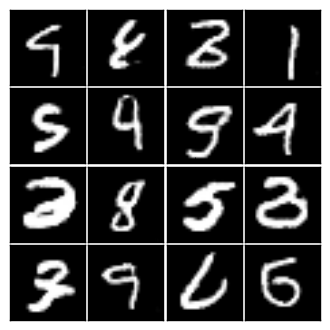

[219/500] D_loss: 1.4545 / G_loss: 0.5994


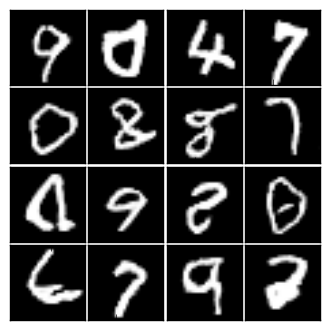

[220/500] D_loss: 1.3991 / G_loss: 0.9173


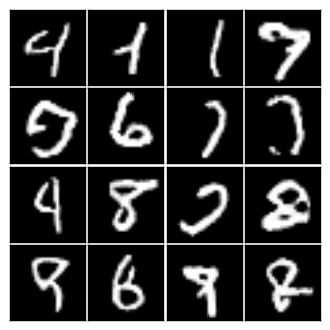

[221/500] D_loss: 1.5047 / G_loss: 0.5153


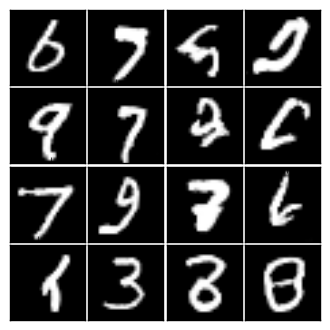

[222/500] D_loss: 1.6521 / G_loss: 0.9173


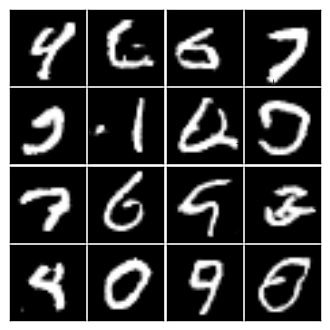

[223/500] D_loss: 1.4528 / G_loss: 0.8181


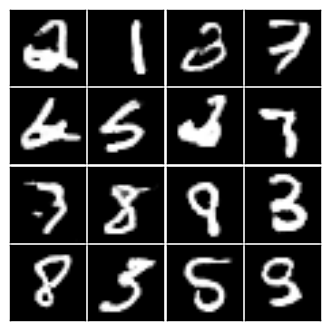

[224/500] D_loss: 1.4158 / G_loss: 0.8674


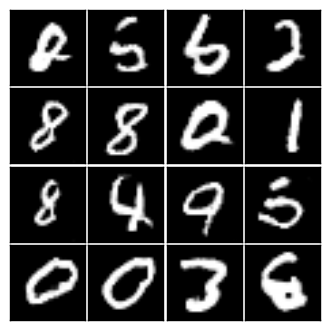

[225/500] D_loss: 1.3643 / G_loss: 1.0097


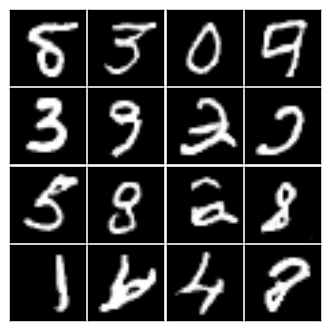

[226/500] D_loss: 1.3950 / G_loss: 0.7936


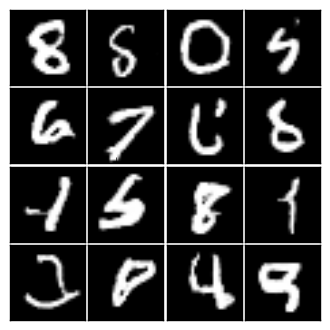

[227/500] D_loss: 1.3991 / G_loss: 0.8782


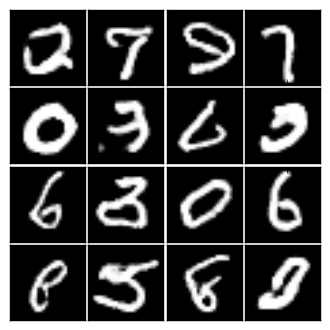

[228/500] D_loss: 1.4205 / G_loss: 0.7373


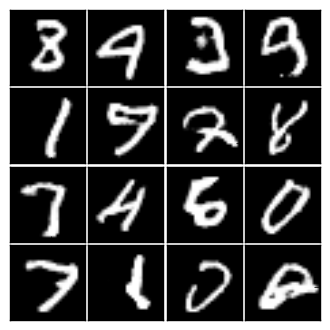

[229/500] D_loss: 1.3607 / G_loss: 0.8825


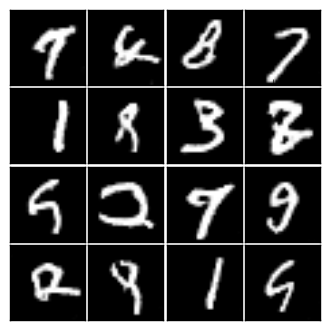

[230/500] D_loss: 1.4462 / G_loss: 1.3527


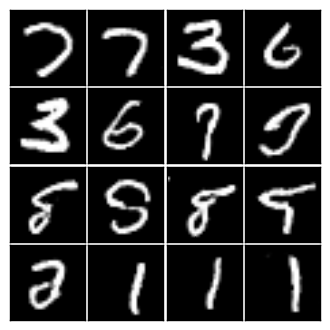

[231/500] D_loss: 1.4039 / G_loss: 0.9858


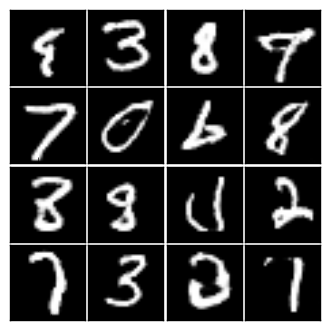

[232/500] D_loss: 1.4614 / G_loss: 0.6082


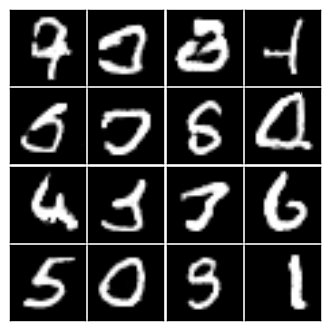

[233/500] D_loss: 1.4864 / G_loss: 0.5260


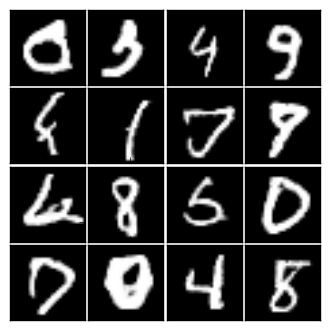

[234/500] D_loss: 1.3450 / G_loss: 0.7917


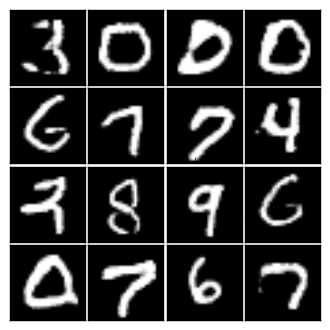

[235/500] D_loss: 1.3779 / G_loss: 0.9459


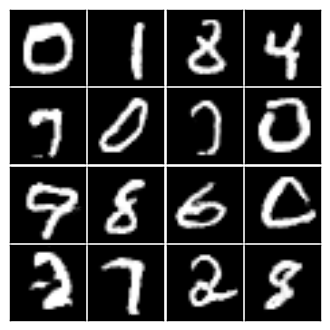

[236/500] D_loss: 1.5208 / G_loss: 1.4749


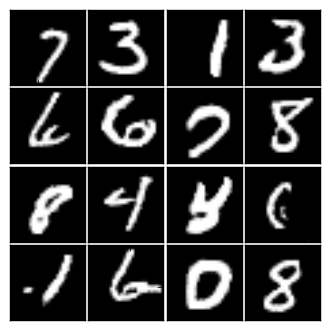

[237/500] D_loss: 1.4372 / G_loss: 1.2882


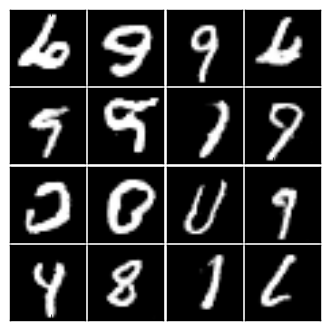

[238/500] D_loss: 1.4409 / G_loss: 0.5396


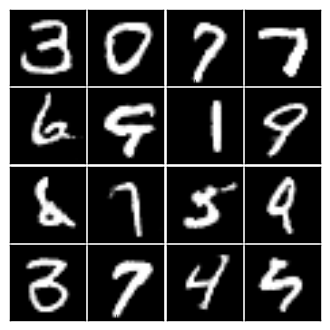

[239/500] D_loss: 1.3838 / G_loss: 0.7323


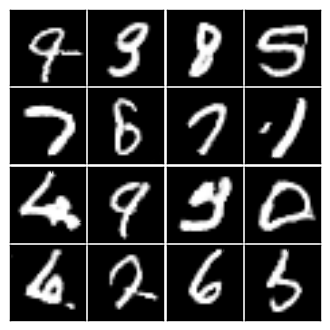

[240/500] D_loss: 1.4941 / G_loss: 0.7548


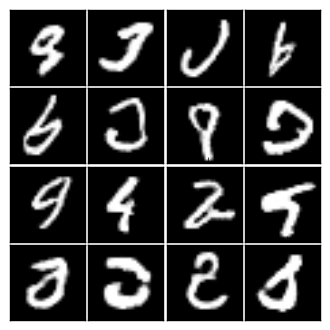

[241/500] D_loss: 1.4131 / G_loss: 0.7053


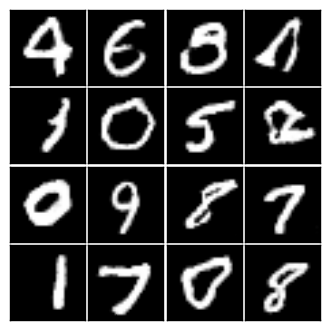

[242/500] D_loss: 1.3736 / G_loss: 0.9609


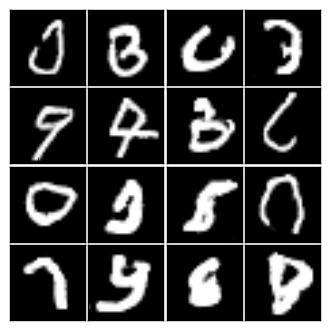

[243/500] D_loss: 1.3921 / G_loss: 0.8924


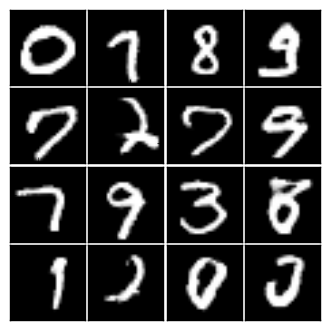

[244/500] D_loss: 1.4851 / G_loss: 0.6314


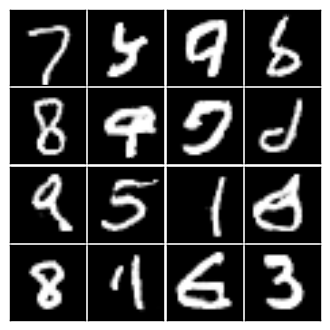

[245/500] D_loss: 1.3696 / G_loss: 0.8794


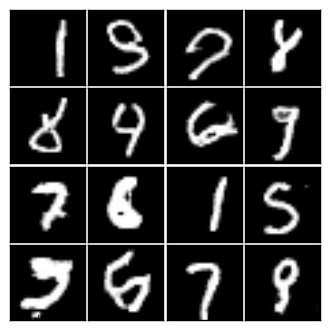

[246/500] D_loss: 1.3078 / G_loss: 0.9004


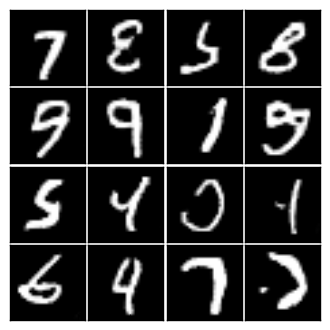

[247/500] D_loss: 1.3543 / G_loss: 0.8563


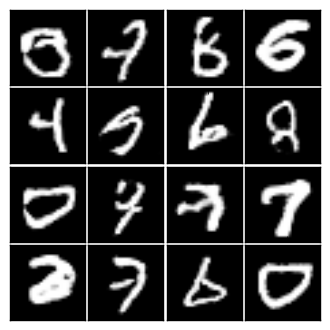

[248/500] D_loss: 1.3247 / G_loss: 0.9431


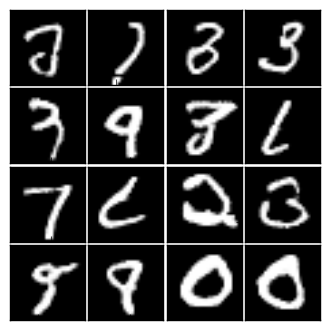

[249/500] D_loss: 1.4097 / G_loss: 0.6780


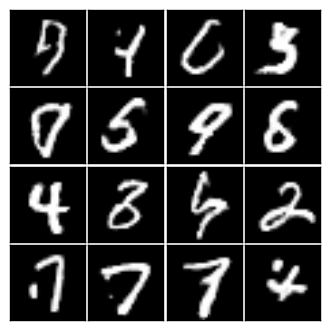

[250/500] D_loss: 1.4743 / G_loss: 0.6523


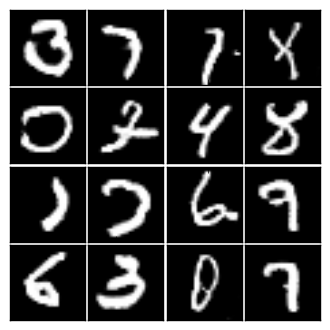

[251/500] D_loss: 1.4503 / G_loss: 0.7993


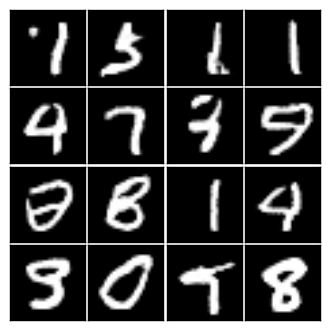

[252/500] D_loss: 1.3964 / G_loss: 0.6436


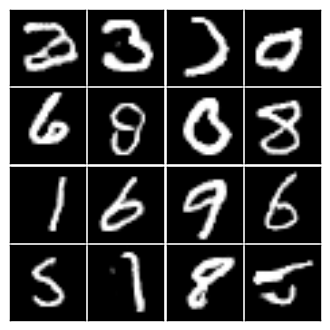

[253/500] D_loss: 1.3790 / G_loss: 0.7910


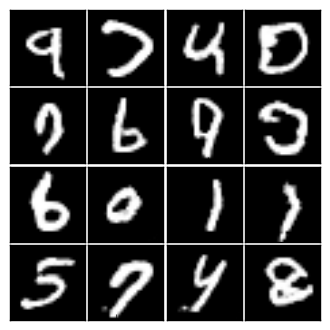

[254/500] D_loss: 1.5004 / G_loss: 0.5926


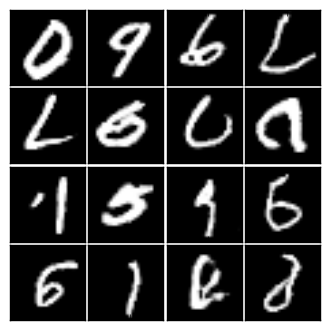

[255/500] D_loss: 1.3615 / G_loss: 1.0054


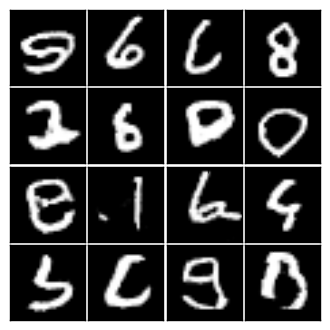

[256/500] D_loss: 1.4305 / G_loss: 0.6362


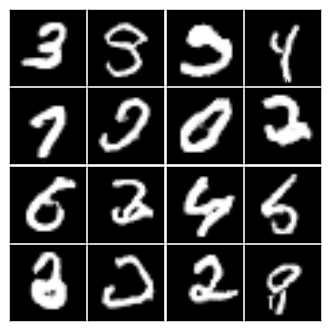

[257/500] D_loss: 1.3745 / G_loss: 0.8880


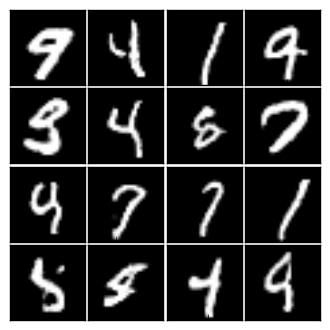

[258/500] D_loss: 1.4501 / G_loss: 0.7042


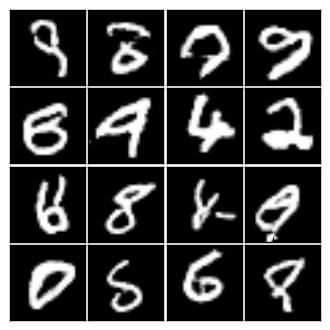

[259/500] D_loss: 1.5142 / G_loss: 0.8872


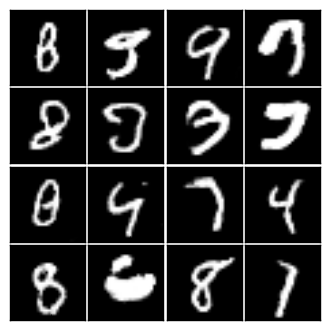

[260/500] D_loss: 1.2770 / G_loss: 1.1031


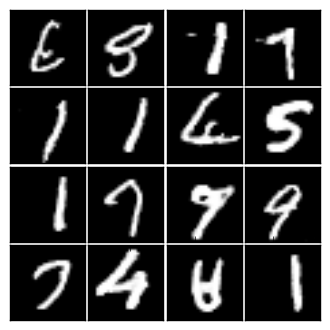

[261/500] D_loss: 1.3619 / G_loss: 0.8457


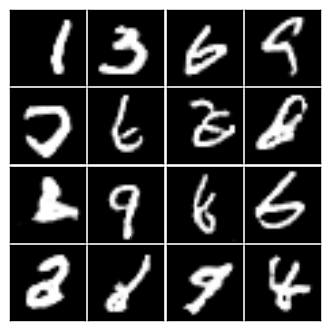

[262/500] D_loss: 1.4498 / G_loss: 0.6023


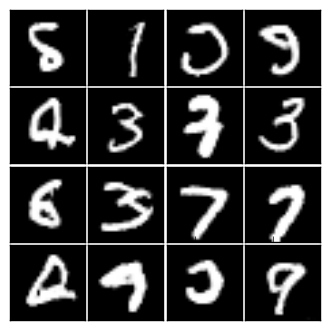

[263/500] D_loss: 1.4025 / G_loss: 0.7643


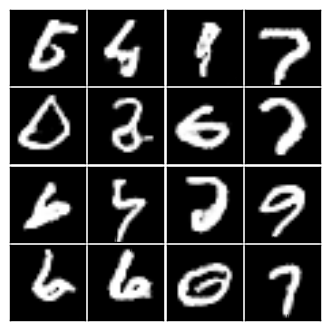

[264/500] D_loss: 1.4445 / G_loss: 0.7219


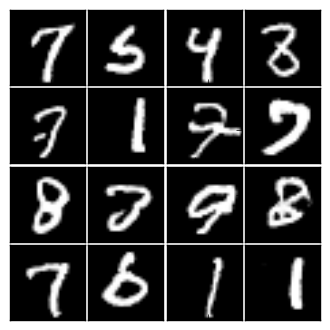

[265/500] D_loss: 1.4443 / G_loss: 0.6033


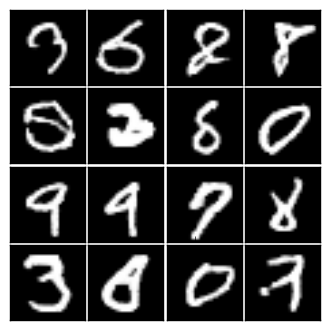

[266/500] D_loss: 1.4542 / G_loss: 0.6210


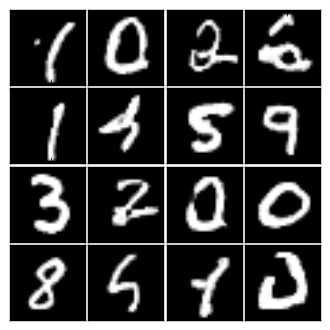

[267/500] D_loss: 1.4067 / G_loss: 0.7745


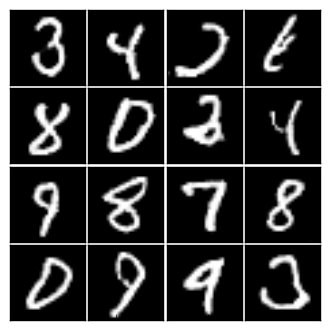

[268/500] D_loss: 1.4328 / G_loss: 0.8672


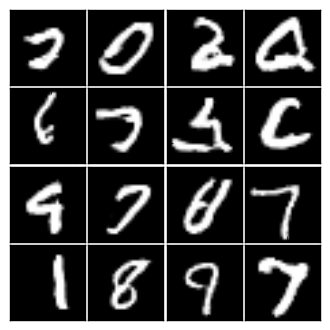

[269/500] D_loss: 1.4212 / G_loss: 0.8507


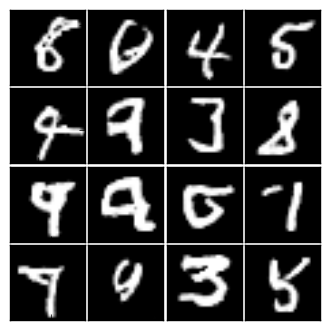

[270/500] D_loss: 1.3855 / G_loss: 1.1198


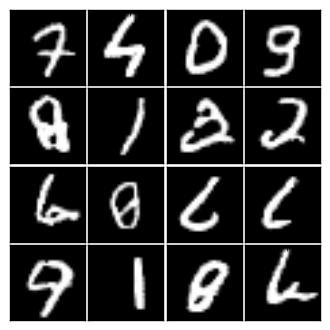

[271/500] D_loss: 1.3726 / G_loss: 0.8487


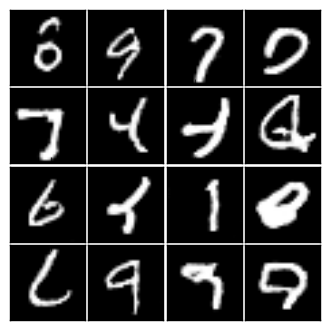

[272/500] D_loss: 1.4254 / G_loss: 0.8233


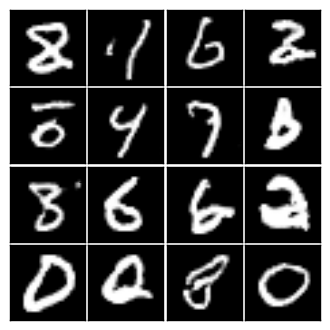

[273/500] D_loss: 1.4262 / G_loss: 0.6176


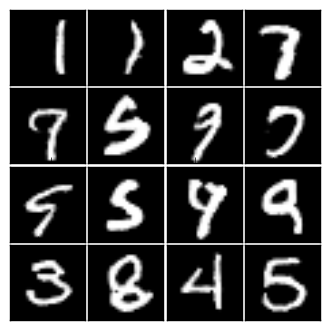

[274/500] D_loss: 1.4901 / G_loss: 0.5453


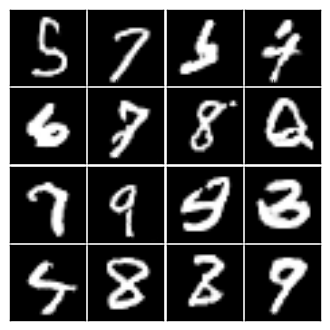

[275/500] D_loss: 1.4380 / G_loss: 0.6320


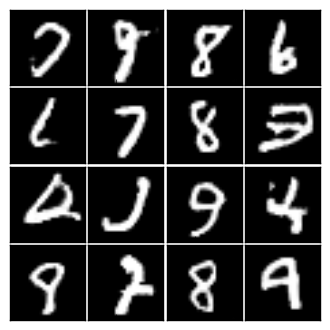

[276/500] D_loss: 1.5240 / G_loss: 1.3504


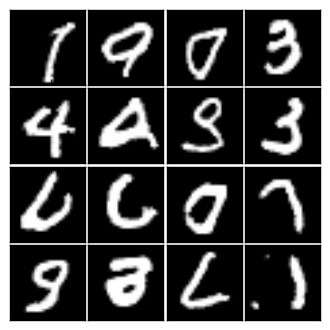

[277/500] D_loss: 1.4245 / G_loss: 0.8952


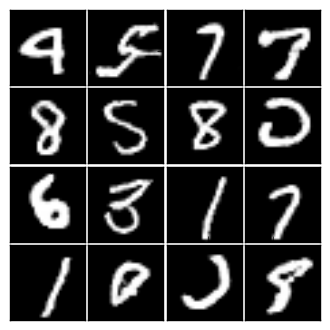

[278/500] D_loss: 1.3691 / G_loss: 0.6922


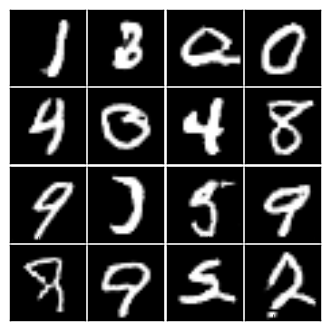

[279/500] D_loss: 1.6485 / G_loss: 1.2026


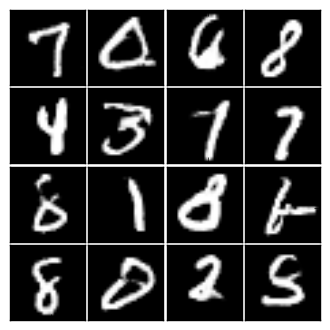

[280/500] D_loss: 1.3618 / G_loss: 0.8828


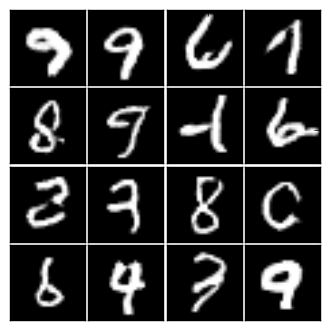

[281/500] D_loss: 1.3724 / G_loss: 0.8699


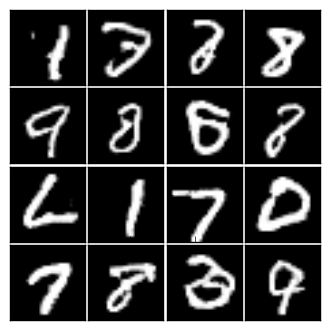

[282/500] D_loss: 1.3854 / G_loss: 0.8400


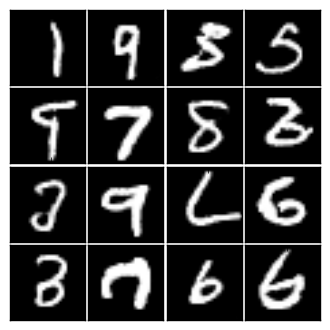

[283/500] D_loss: 1.7192 / G_loss: 0.3811


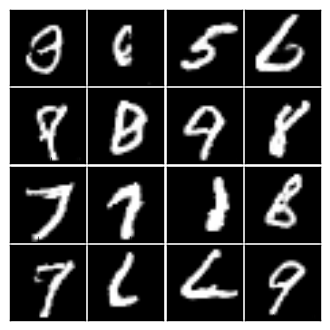

[284/500] D_loss: 1.3380 / G_loss: 0.8188


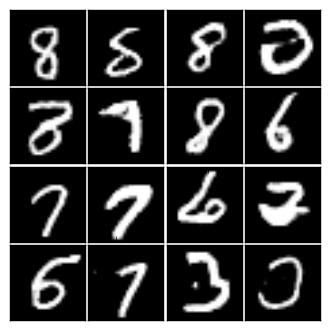

[285/500] D_loss: 1.3004 / G_loss: 1.1453


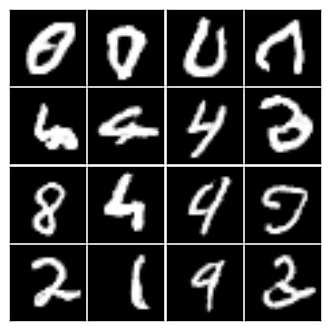

[286/500] D_loss: 1.4379 / G_loss: 0.8276


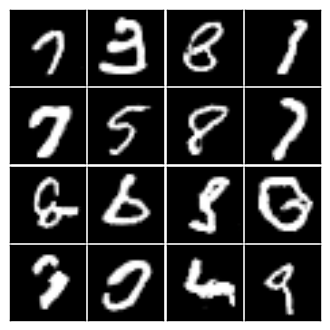

[287/500] D_loss: 1.3827 / G_loss: 1.1477


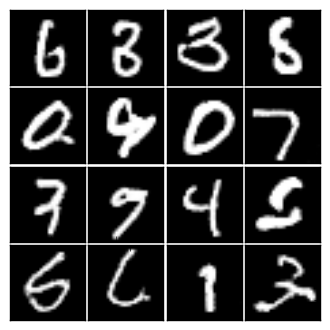

[288/500] D_loss: 1.4901 / G_loss: 1.3065


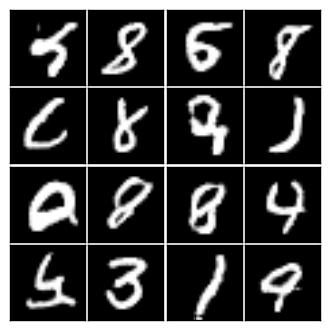

[289/500] D_loss: 1.4180 / G_loss: 0.9129


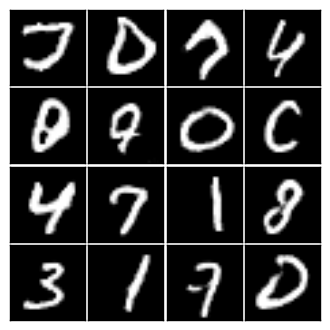

[290/500] D_loss: 1.3588 / G_loss: 0.9149


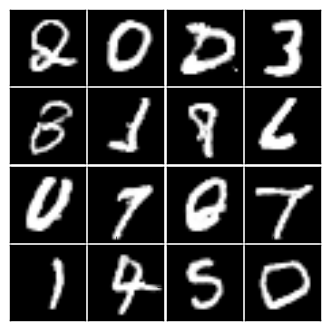

[291/500] D_loss: 1.4502 / G_loss: 0.6622


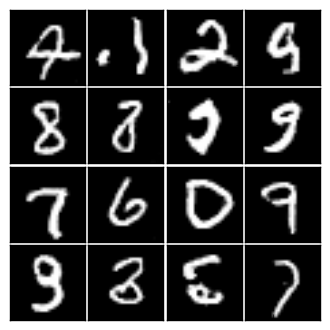

[292/500] D_loss: 1.3362 / G_loss: 1.0115


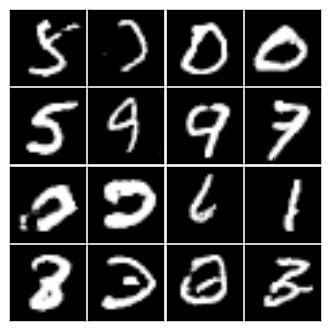

[293/500] D_loss: 1.4334 / G_loss: 1.2286


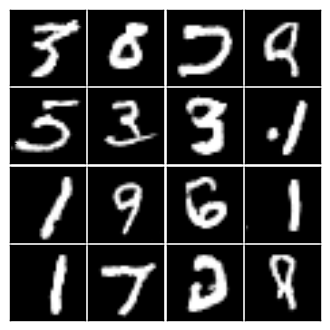

[294/500] D_loss: 1.5285 / G_loss: 1.2684


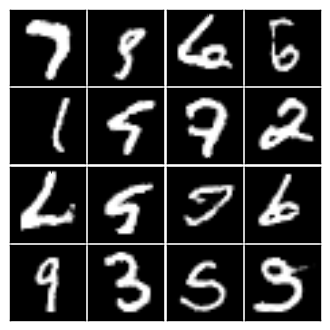

[295/500] D_loss: 1.5248 / G_loss: 0.5666


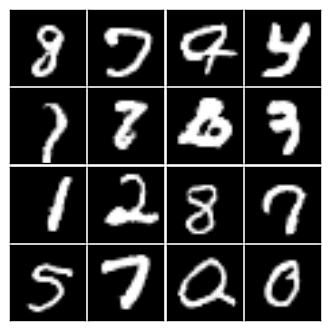

[296/500] D_loss: 1.4058 / G_loss: 0.7062


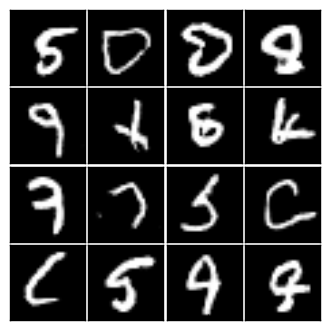

[297/500] D_loss: 1.4541 / G_loss: 0.6202


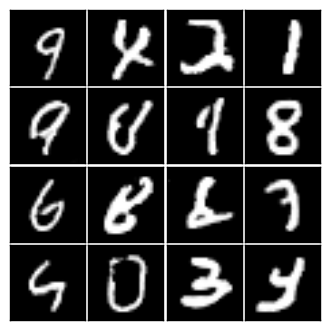

[298/500] D_loss: 1.3659 / G_loss: 0.9151


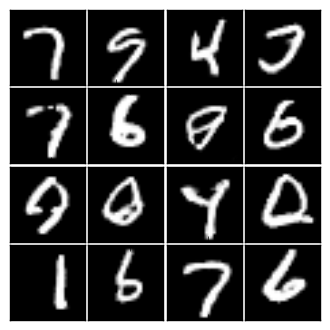

[299/500] D_loss: 1.3448 / G_loss: 0.7973


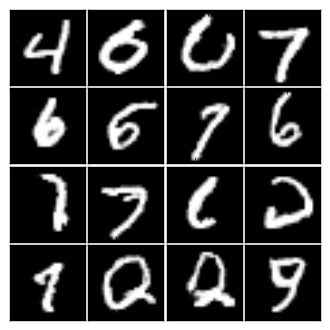

[300/500] D_loss: 1.4412 / G_loss: 1.0591


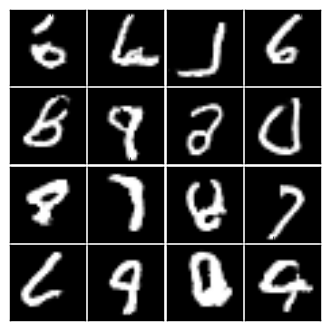

[301/500] D_loss: 1.3615 / G_loss: 0.7612


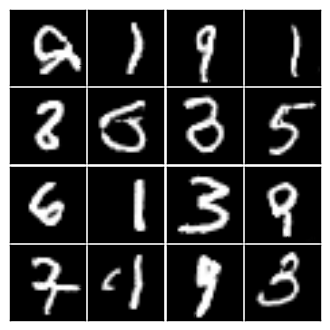

[302/500] D_loss: 1.3937 / G_loss: 0.9784


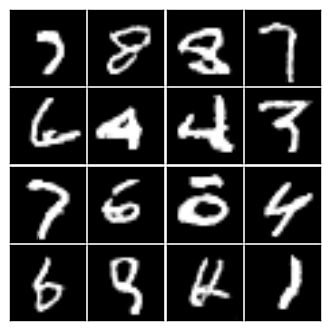

[303/500] D_loss: 1.4283 / G_loss: 0.6140


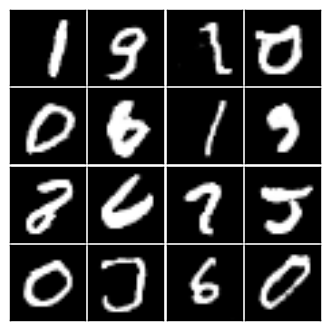

[304/500] D_loss: 1.3545 / G_loss: 0.9920


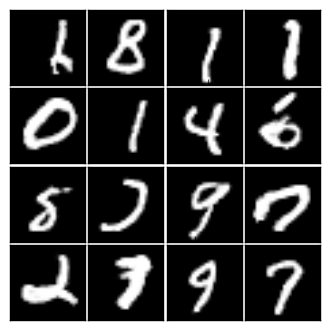

[305/500] D_loss: 1.3706 / G_loss: 0.8506


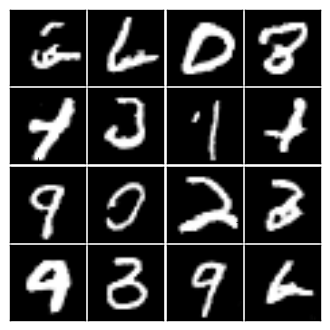

[306/500] D_loss: 1.4384 / G_loss: 0.8108


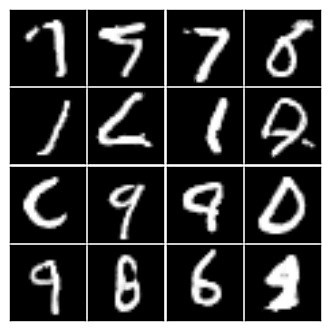

[307/500] D_loss: 1.4396 / G_loss: 0.9432


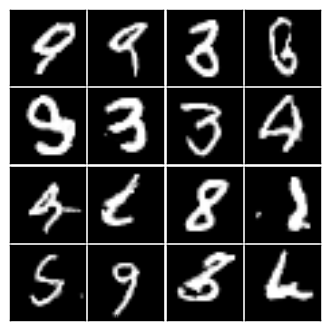

[308/500] D_loss: 1.3943 / G_loss: 0.7785


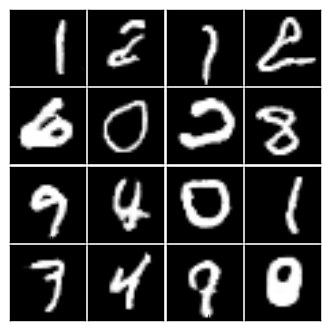

[309/500] D_loss: 1.3445 / G_loss: 0.8496


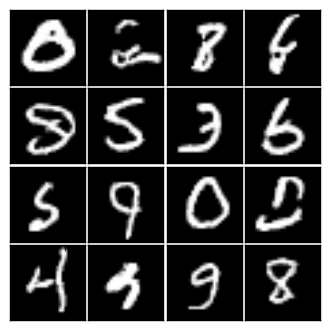

[310/500] D_loss: 1.3480 / G_loss: 0.7763


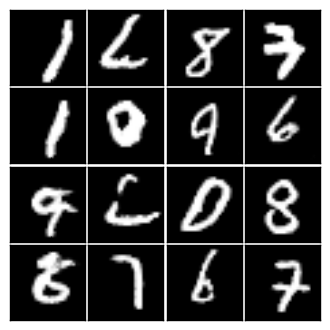

[311/500] D_loss: 1.3713 / G_loss: 0.9105


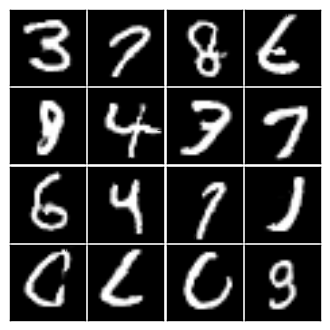

[312/500] D_loss: 1.3778 / G_loss: 0.7107


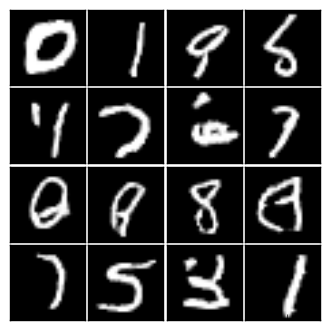

[313/500] D_loss: 1.3843 / G_loss: 0.9063


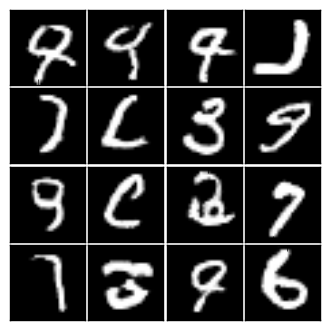

[314/500] D_loss: 1.3938 / G_loss: 0.6235


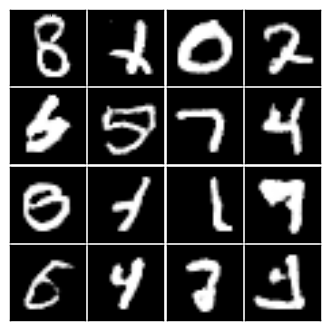

[315/500] D_loss: 1.3484 / G_loss: 0.7693


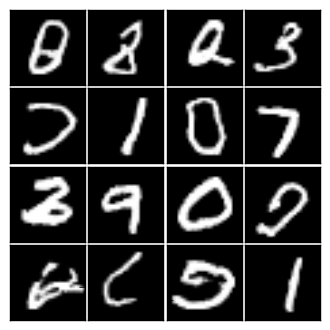

[316/500] D_loss: 1.3829 / G_loss: 0.6610


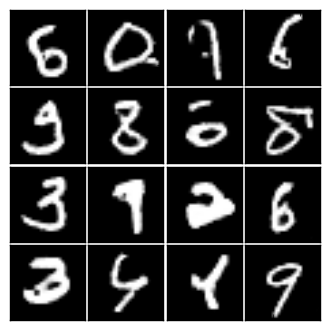

[317/500] D_loss: 1.3859 / G_loss: 0.9863


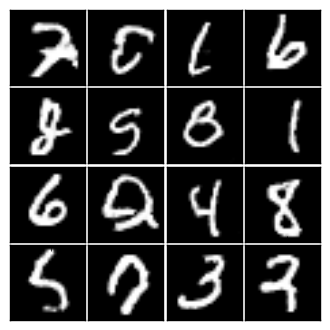

[318/500] D_loss: 1.3812 / G_loss: 0.7396


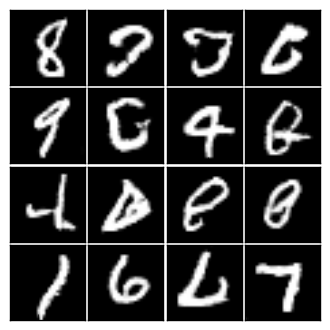

[319/500] D_loss: 1.3889 / G_loss: 0.6555


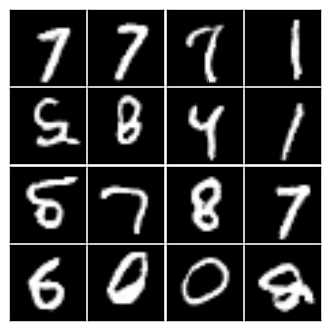

[320/500] D_loss: 1.3591 / G_loss: 0.9587


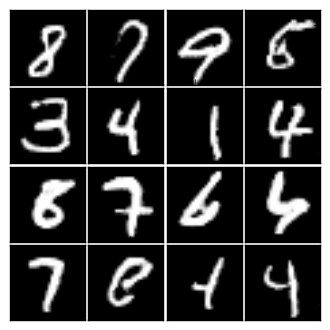

[321/500] D_loss: 1.3559 / G_loss: 0.7963


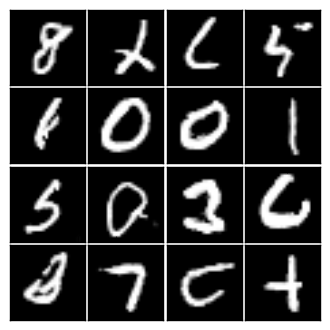

[322/500] D_loss: 1.3605 / G_loss: 0.8925


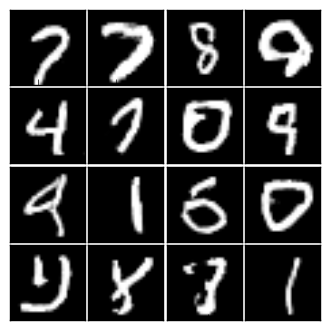

[323/500] D_loss: 1.4036 / G_loss: 0.9232


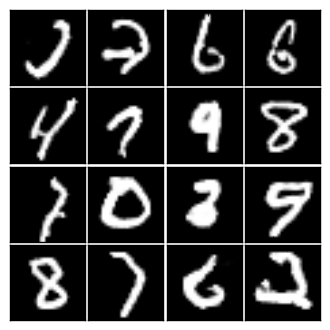

[324/500] D_loss: 1.4786 / G_loss: 0.5915


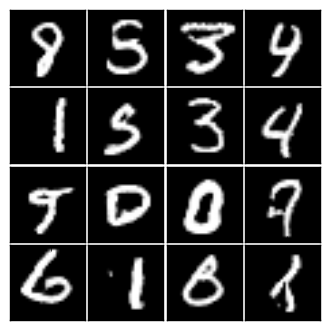

[325/500] D_loss: 1.4588 / G_loss: 0.8626


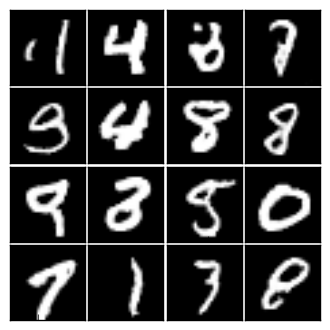

[326/500] D_loss: 1.4043 / G_loss: 0.8826


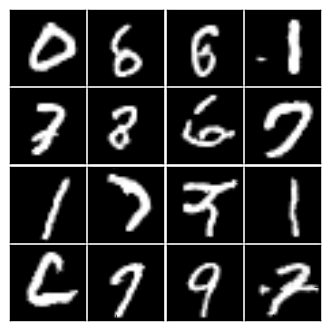

[327/500] D_loss: 1.5070 / G_loss: 0.5460


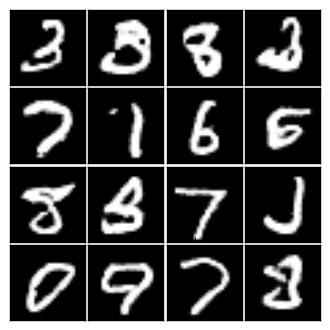

[328/500] D_loss: 1.4528 / G_loss: 0.8632


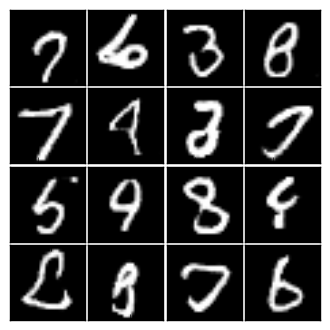

[329/500] D_loss: 1.4906 / G_loss: 0.6439


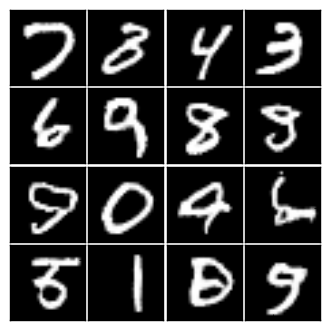

[330/500] D_loss: 1.3736 / G_loss: 0.6813


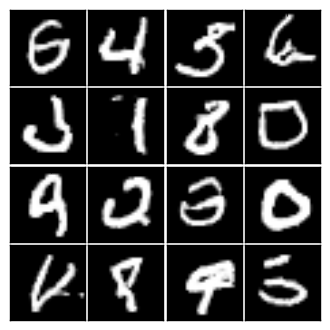

[331/500] D_loss: 1.4739 / G_loss: 0.7437


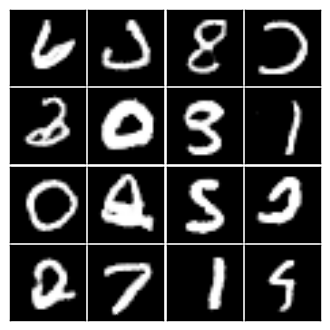

[332/500] D_loss: 1.3607 / G_loss: 0.8108


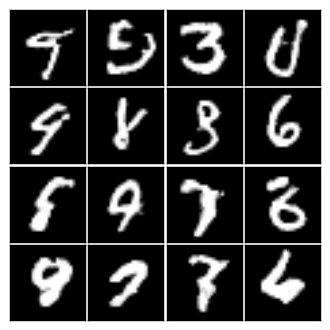

[333/500] D_loss: 1.4710 / G_loss: 0.6237


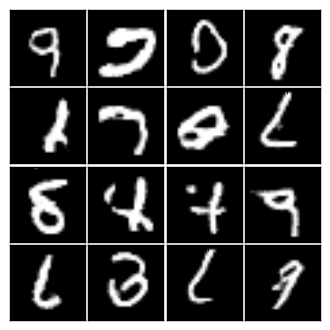

[334/500] D_loss: 1.4610 / G_loss: 0.6125


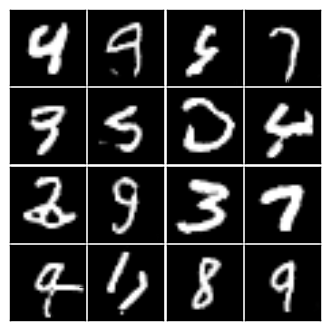

[335/500] D_loss: 1.5115 / G_loss: 0.9782


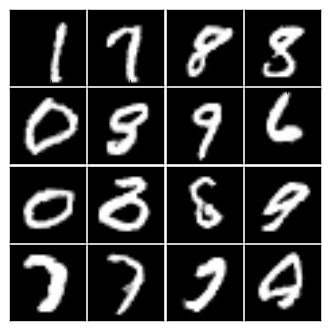

[336/500] D_loss: 1.3851 / G_loss: 0.6674


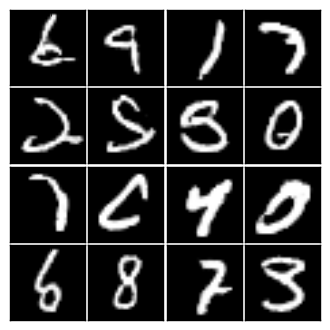

[337/500] D_loss: 1.3875 / G_loss: 0.8454


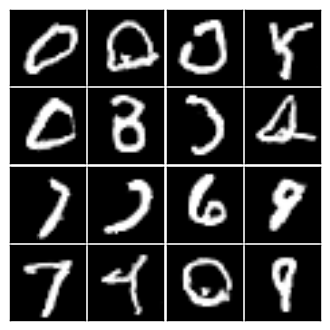

[338/500] D_loss: 1.4305 / G_loss: 0.6809


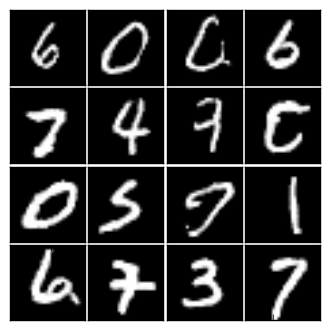

[339/500] D_loss: 1.3981 / G_loss: 0.7019


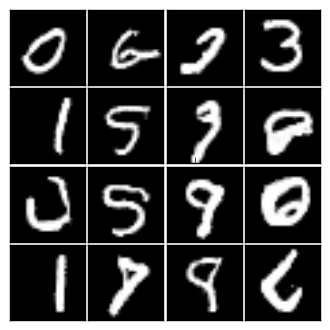

[340/500] D_loss: 1.4089 / G_loss: 0.6928


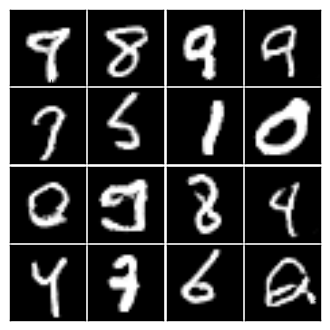

[341/500] D_loss: 1.4916 / G_loss: 0.9055


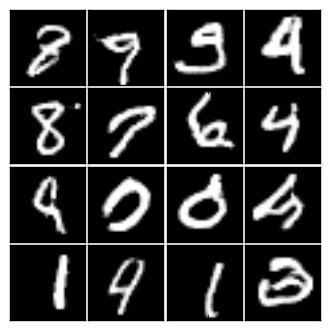

[342/500] D_loss: 1.3866 / G_loss: 0.9186


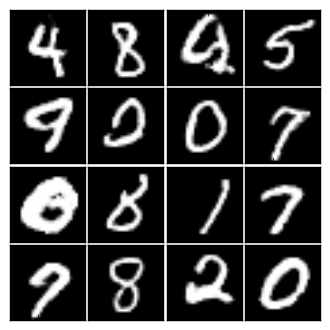

[343/500] D_loss: 1.4528 / G_loss: 0.7393


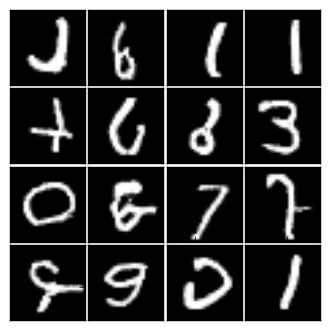

[344/500] D_loss: 1.4020 / G_loss: 0.7631


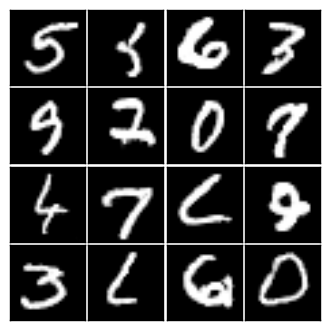

[345/500] D_loss: 1.3808 / G_loss: 0.8313


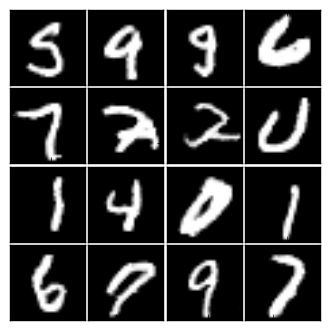

[346/500] D_loss: 1.4081 / G_loss: 0.9330


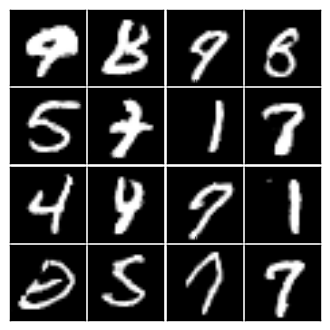

[347/500] D_loss: 1.3862 / G_loss: 0.7935


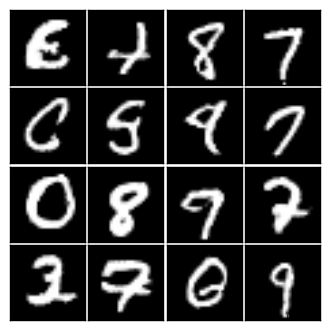

[348/500] D_loss: 1.4772 / G_loss: 0.5704


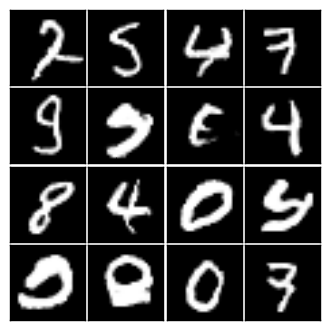

[349/500] D_loss: 1.5924 / G_loss: 0.9512


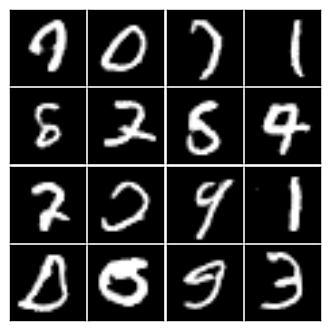

[350/500] D_loss: 1.4004 / G_loss: 0.8826


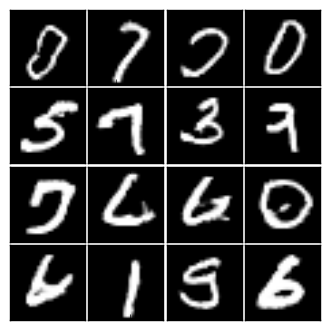

[351/500] D_loss: 1.3969 / G_loss: 0.8216


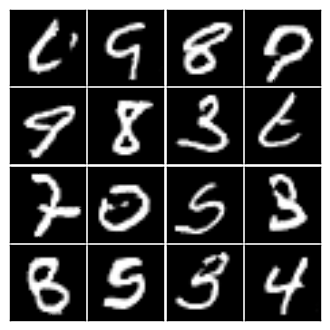

[352/500] D_loss: 1.4354 / G_loss: 0.7369


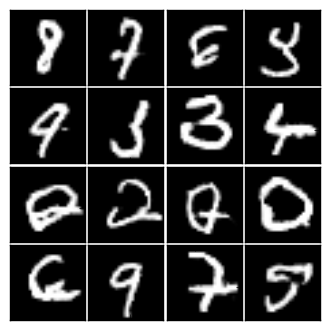

[353/500] D_loss: 1.5533 / G_loss: 1.2628


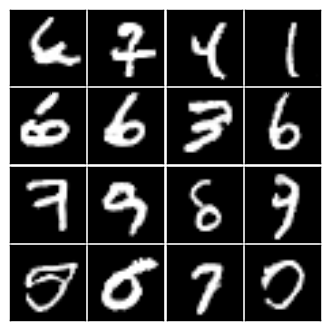

[354/500] D_loss: 1.4606 / G_loss: 0.8425


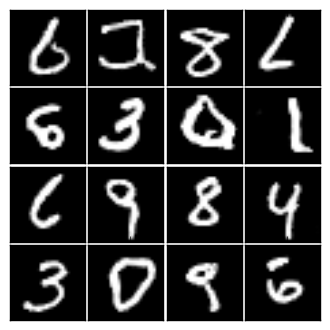

[355/500] D_loss: 1.3644 / G_loss: 0.7429


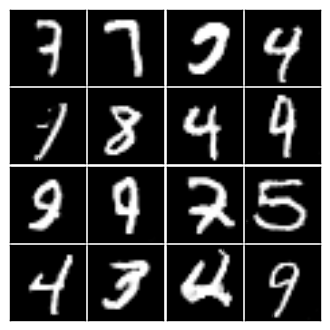

[356/500] D_loss: 1.4222 / G_loss: 0.6267


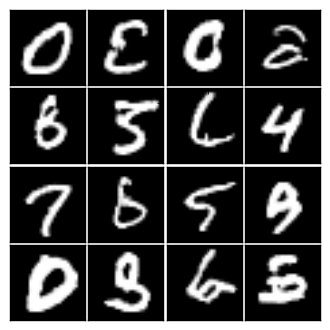

[357/500] D_loss: 1.3917 / G_loss: 0.8106


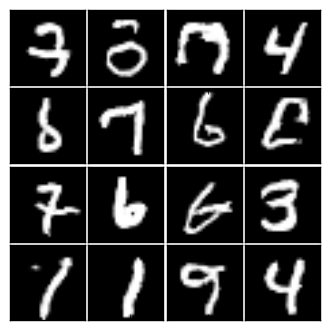

[358/500] D_loss: 1.4009 / G_loss: 0.7680


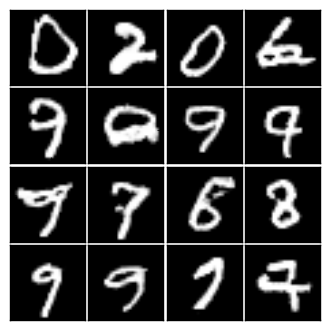

[359/500] D_loss: 1.3909 / G_loss: 0.8530


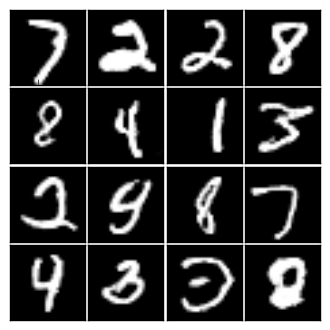

[360/500] D_loss: 1.4048 / G_loss: 0.6764


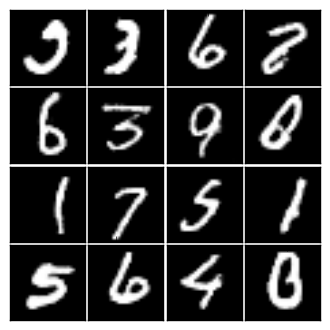

[361/500] D_loss: 1.3968 / G_loss: 0.8607


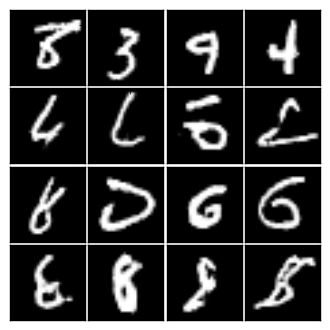

[362/500] D_loss: 1.5377 / G_loss: 1.2866


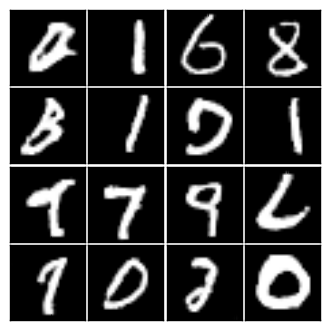

[363/500] D_loss: 1.3958 / G_loss: 0.6603


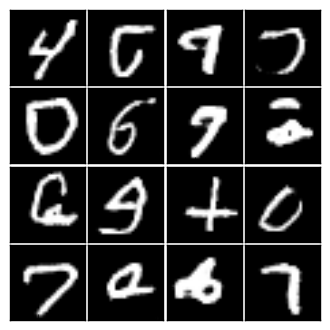

[364/500] D_loss: 1.5773 / G_loss: 0.4508


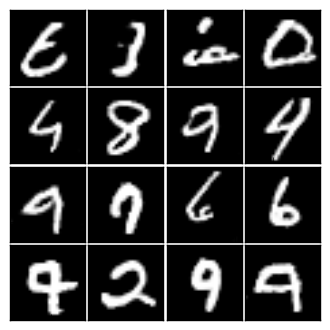

[365/500] D_loss: 1.3506 / G_loss: 0.8366


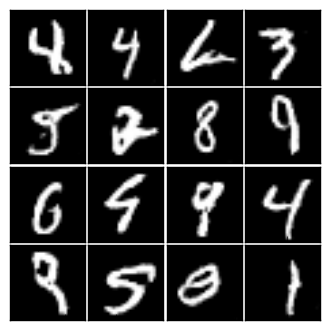

[366/500] D_loss: 1.4248 / G_loss: 1.0851


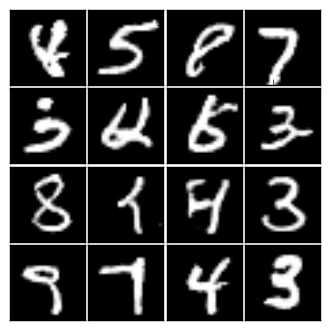

[367/500] D_loss: 1.4524 / G_loss: 1.0118


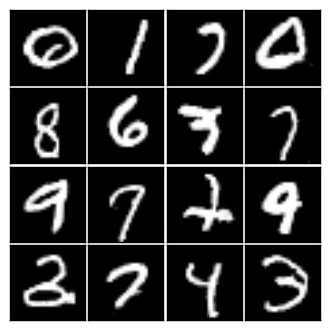

[368/500] D_loss: 1.3775 / G_loss: 0.8157


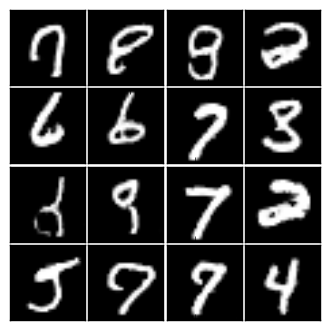

[369/500] D_loss: 1.4438 / G_loss: 0.6091


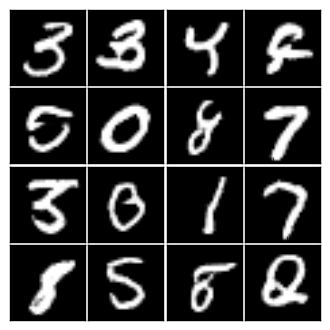

[370/500] D_loss: 1.3771 / G_loss: 0.7168


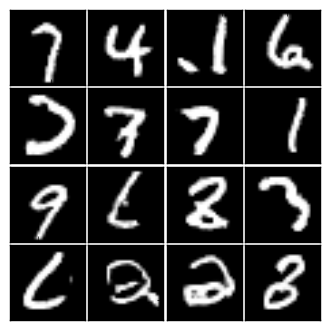

[371/500] D_loss: 1.3873 / G_loss: 0.7935


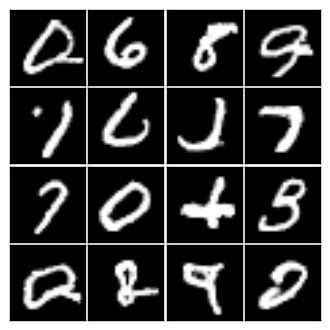

[372/500] D_loss: 1.3799 / G_loss: 0.7308


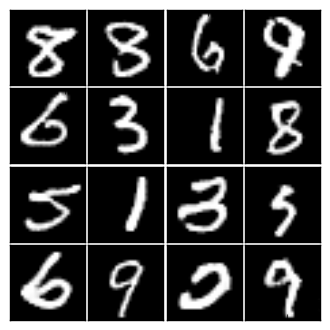

[373/500] D_loss: 1.3908 / G_loss: 0.9768


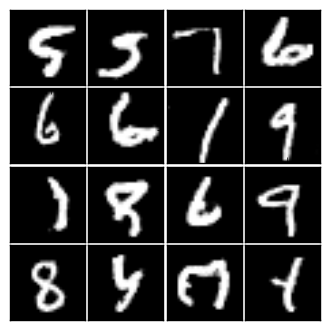

[374/500] D_loss: 1.4608 / G_loss: 0.7306


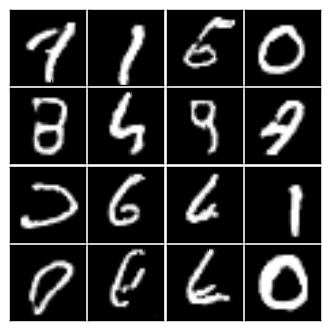

[375/500] D_loss: 1.3706 / G_loss: 0.9251


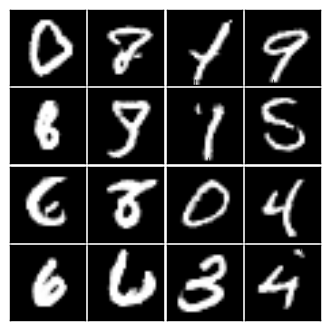

[376/500] D_loss: 1.4091 / G_loss: 0.7574


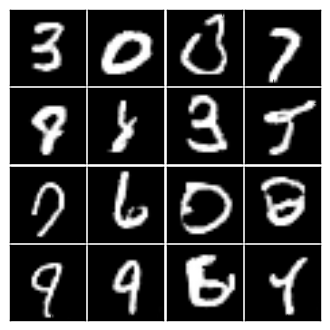

[377/500] D_loss: 1.3744 / G_loss: 0.8107


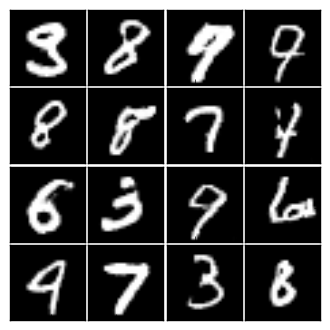

[378/500] D_loss: 1.5727 / G_loss: 0.5167


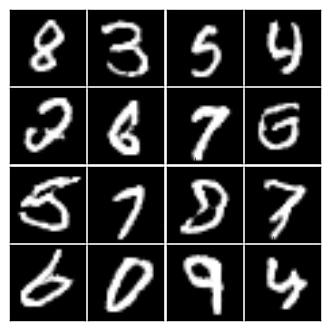

[379/500] D_loss: 1.4026 / G_loss: 0.7529


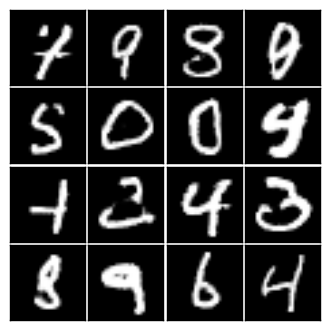

[380/500] D_loss: 1.4423 / G_loss: 0.6695


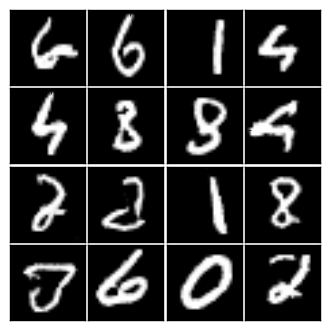

[381/500] D_loss: 1.4083 / G_loss: 0.8290


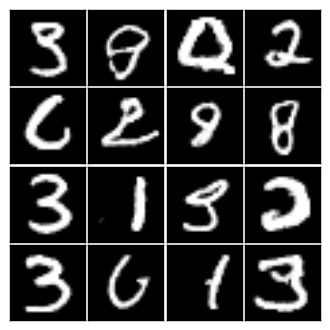

[382/500] D_loss: 1.4452 / G_loss: 1.0829


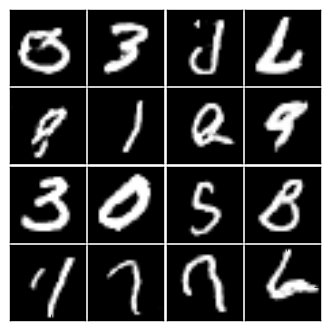

[383/500] D_loss: 1.3786 / G_loss: 0.7845


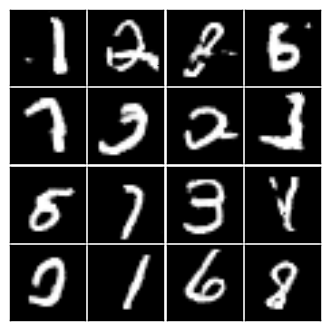

[384/500] D_loss: 1.3814 / G_loss: 0.9613


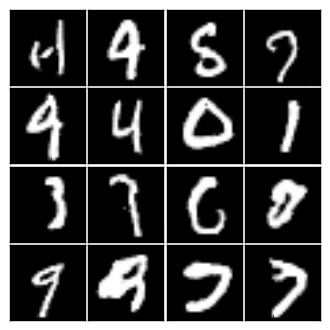

[385/500] D_loss: 1.3855 / G_loss: 0.9331


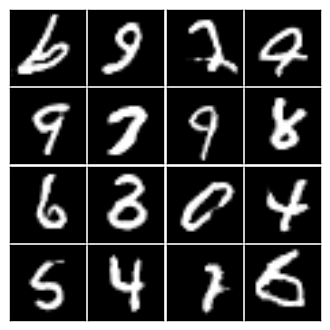

[386/500] D_loss: 1.3929 / G_loss: 1.0153


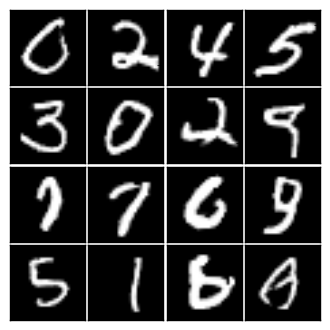

[387/500] D_loss: 1.3455 / G_loss: 0.8225


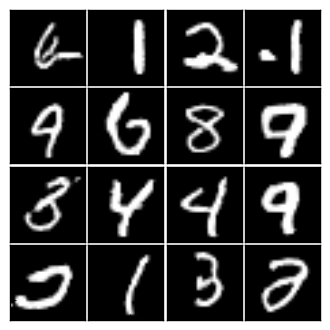

[388/500] D_loss: 1.3845 / G_loss: 0.7127


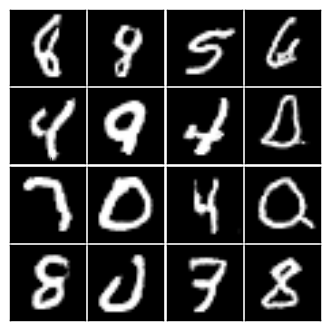

[389/500] D_loss: 1.3617 / G_loss: 0.8268


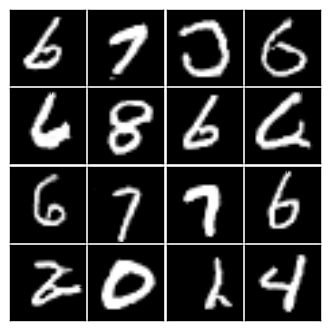

[390/500] D_loss: 1.3450 / G_loss: 0.8083


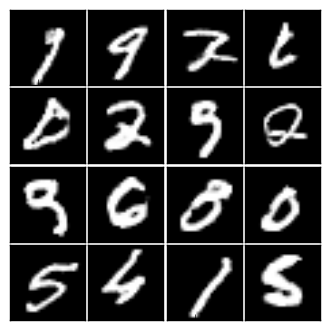

[391/500] D_loss: 1.3580 / G_loss: 0.6851


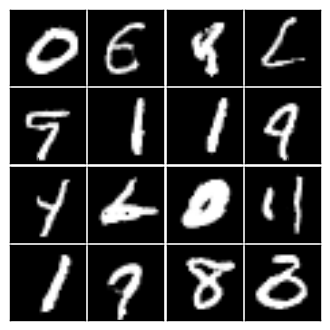

[392/500] D_loss: 1.4161 / G_loss: 1.0303


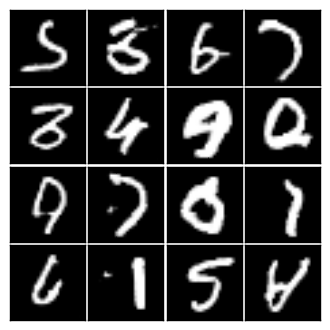

[393/500] D_loss: 1.4622 / G_loss: 0.5515


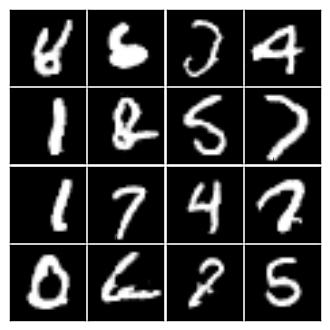

[394/500] D_loss: 1.4112 / G_loss: 0.6609


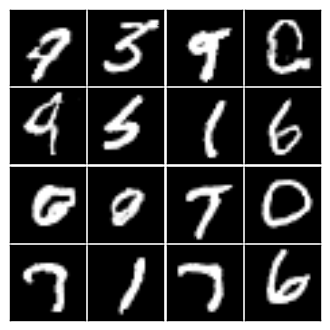

[395/500] D_loss: 1.4161 / G_loss: 0.7734


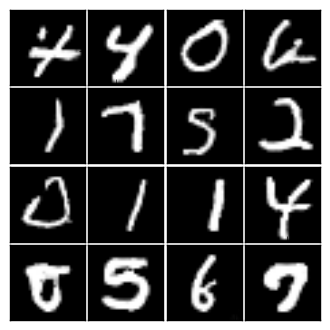

[396/500] D_loss: 1.3905 / G_loss: 0.7996


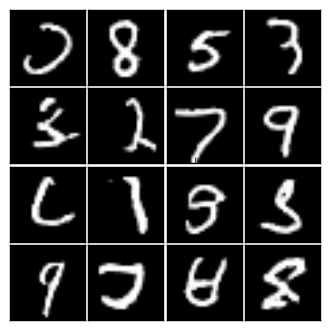

[397/500] D_loss: 1.3881 / G_loss: 0.9690


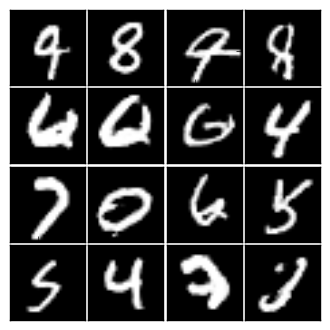

[398/500] D_loss: 1.3782 / G_loss: 0.6886


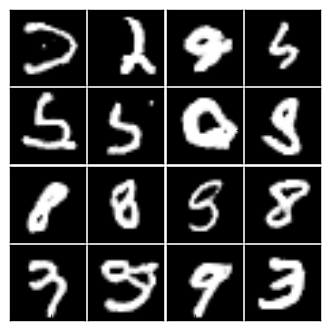

[399/500] D_loss: 1.3500 / G_loss: 0.7199


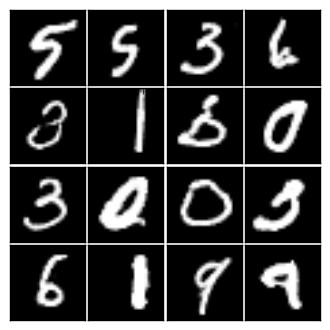

[400/500] D_loss: 1.3943 / G_loss: 0.8704


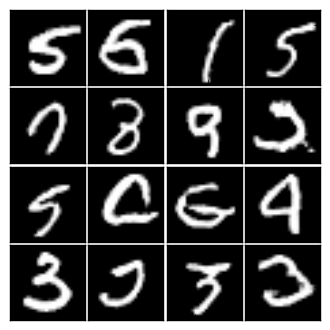

[401/500] D_loss: 1.4481 / G_loss: 0.6136


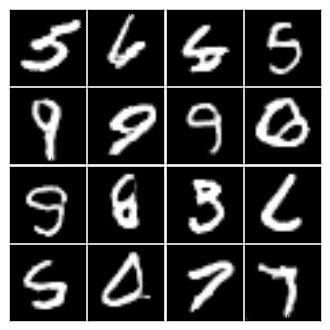

[402/500] D_loss: 1.4792 / G_loss: 0.6557


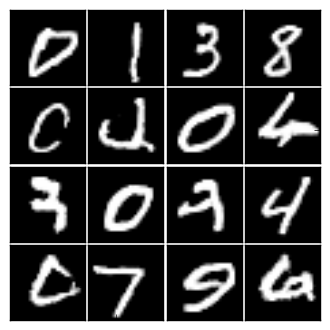

[403/500] D_loss: 1.4154 / G_loss: 1.0728


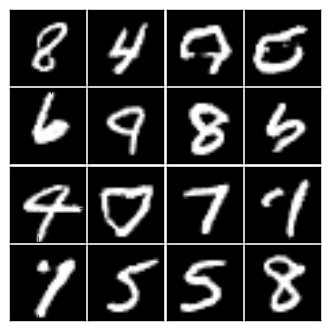

[404/500] D_loss: 1.4258 / G_loss: 0.8483


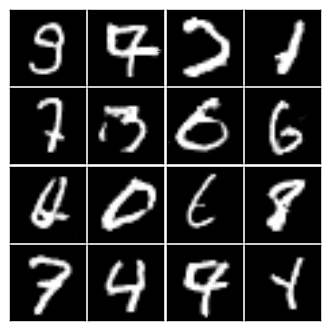

[405/500] D_loss: 1.4016 / G_loss: 0.7260


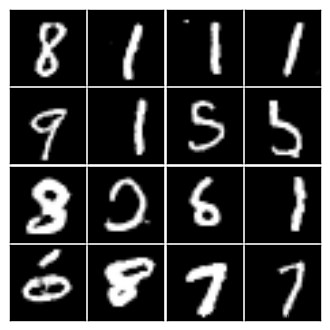

[406/500] D_loss: 1.4477 / G_loss: 0.6658


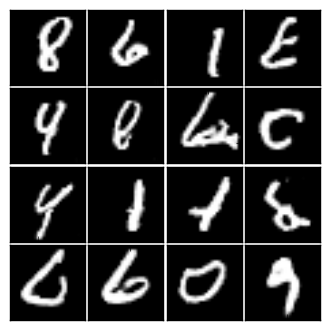

[407/500] D_loss: 1.4106 / G_loss: 1.0565


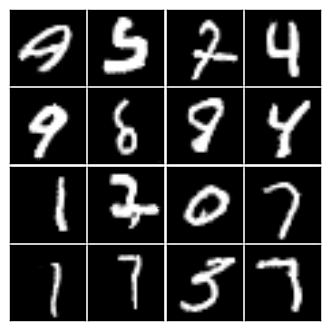

[408/500] D_loss: 1.5127 / G_loss: 1.1603


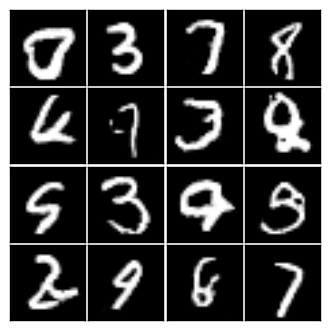

[409/500] D_loss: 1.3862 / G_loss: 0.7001


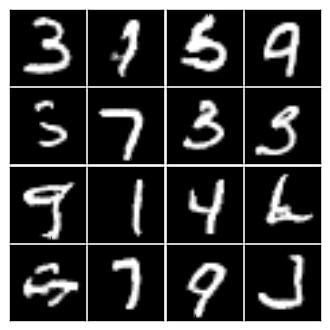

[410/500] D_loss: 1.4303 / G_loss: 0.6513


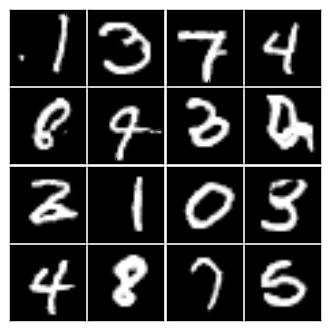

[411/500] D_loss: 1.4477 / G_loss: 0.7383


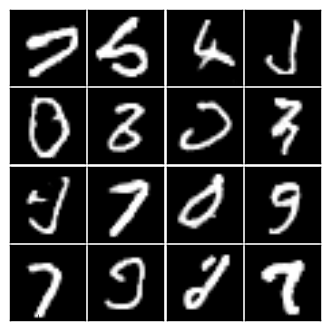

[412/500] D_loss: 1.3988 / G_loss: 1.0055


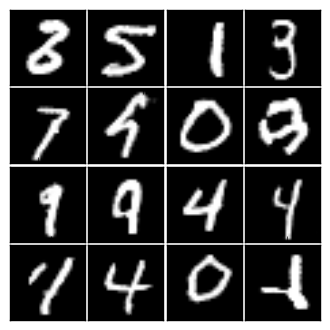

[413/500] D_loss: 1.4240 / G_loss: 0.9087


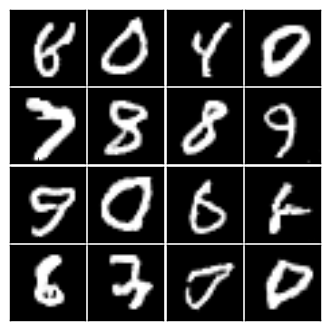

[414/500] D_loss: 1.3701 / G_loss: 0.7379


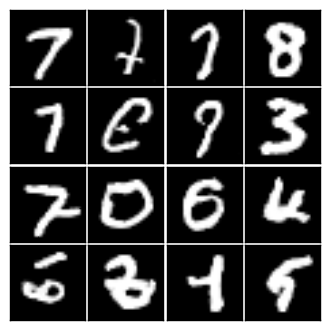

[415/500] D_loss: 1.3829 / G_loss: 1.0161


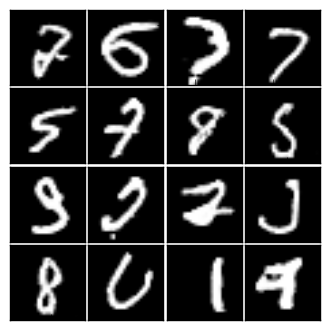

[416/500] D_loss: 1.3953 / G_loss: 0.7709


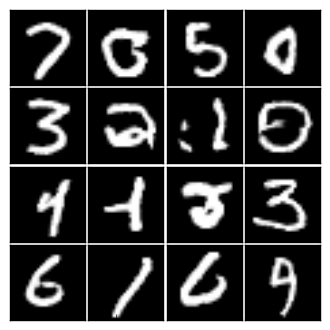

[417/500] D_loss: 1.4791 / G_loss: 1.1914


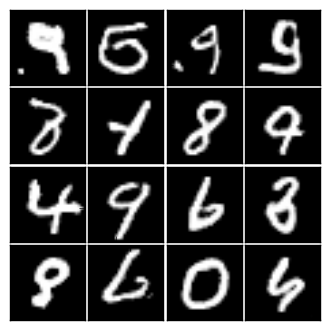

[418/500] D_loss: 1.3857 / G_loss: 0.8721


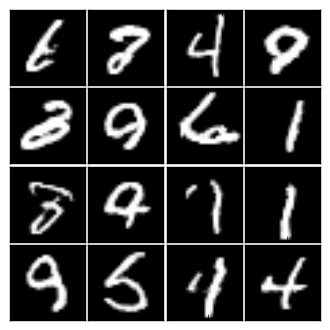

[419/500] D_loss: 1.4030 / G_loss: 0.7192


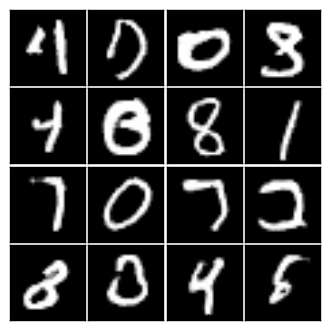

[420/500] D_loss: 1.4053 / G_loss: 0.9454


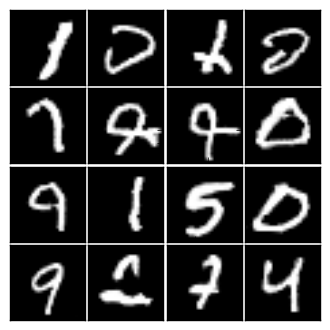

[421/500] D_loss: 1.4209 / G_loss: 0.7818


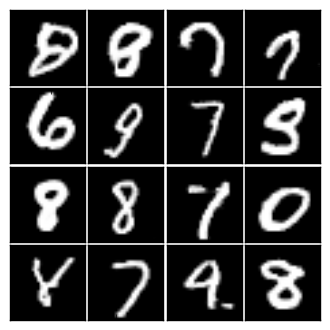

[422/500] D_loss: 1.4224 / G_loss: 1.0341


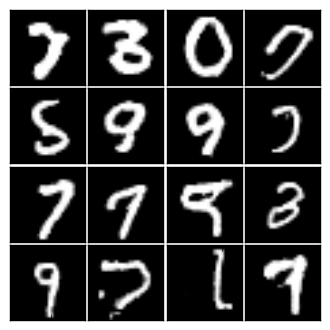

[423/500] D_loss: 1.3985 / G_loss: 0.9327


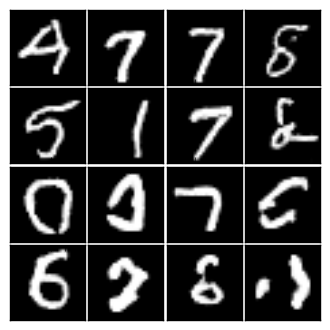

[424/500] D_loss: 1.3840 / G_loss: 0.8814


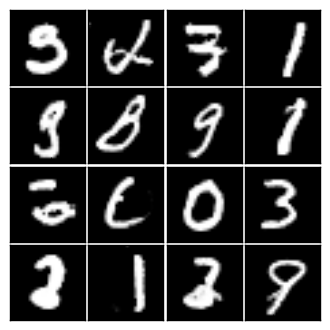

[425/500] D_loss: 1.4383 / G_loss: 0.6632


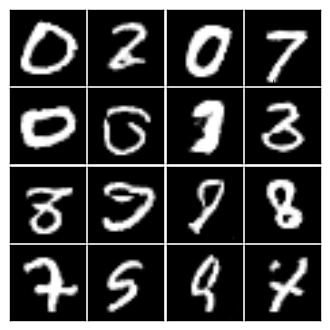

[426/500] D_loss: 1.4719 / G_loss: 0.8008


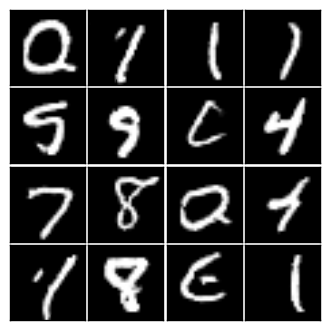

[427/500] D_loss: 1.4196 / G_loss: 0.8391


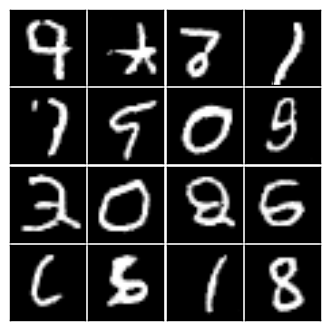

[428/500] D_loss: 1.4130 / G_loss: 0.9841


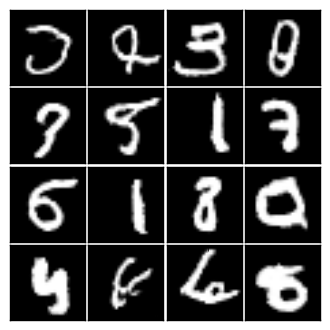

[429/500] D_loss: 1.3963 / G_loss: 0.8788


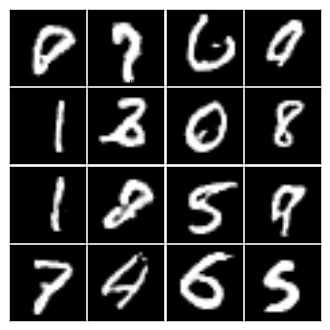

[430/500] D_loss: 1.3899 / G_loss: 0.7003


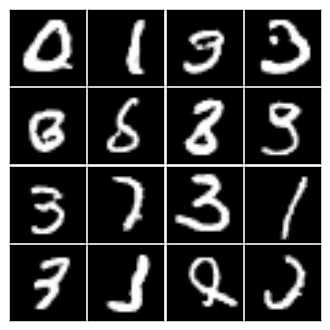

[431/500] D_loss: 1.3575 / G_loss: 0.9258


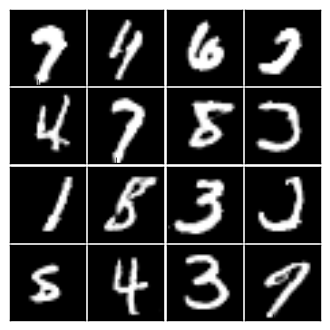

[432/500] D_loss: 1.4623 / G_loss: 0.6405


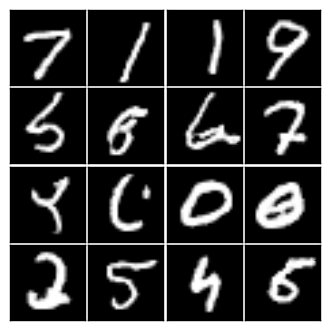

[433/500] D_loss: 1.3991 / G_loss: 0.7261


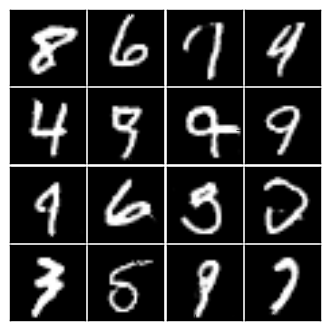

[434/500] D_loss: 1.4134 / G_loss: 0.7518


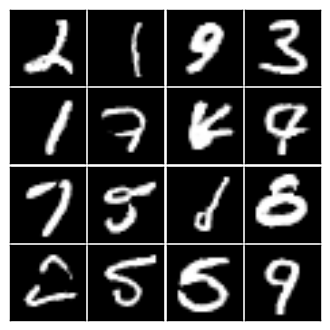

[435/500] D_loss: 1.4560 / G_loss: 0.7040


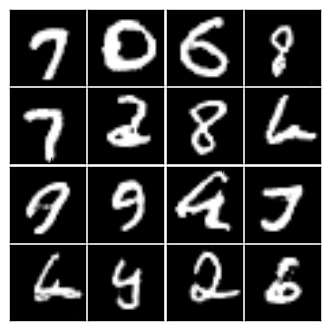

[436/500] D_loss: 1.3927 / G_loss: 0.8272


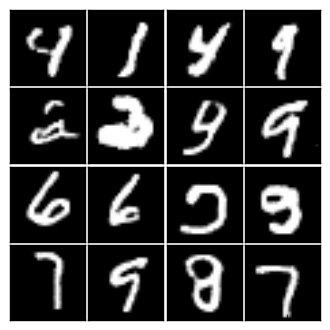

[437/500] D_loss: 1.3824 / G_loss: 0.9226


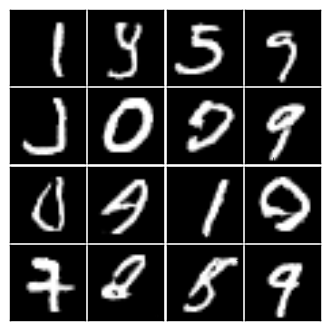

[438/500] D_loss: 1.4117 / G_loss: 0.6665


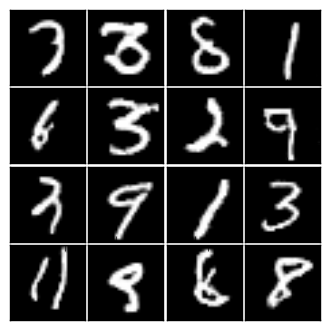

[439/500] D_loss: 1.4446 / G_loss: 0.5857


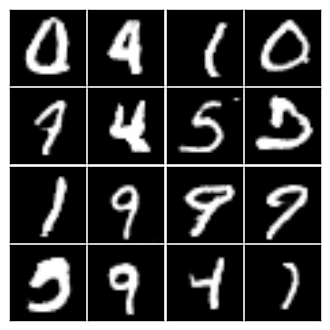

[440/500] D_loss: 1.4332 / G_loss: 0.5816


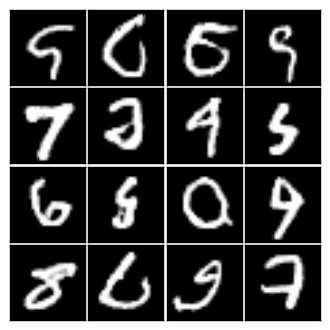

[441/500] D_loss: 1.5343 / G_loss: 0.7050


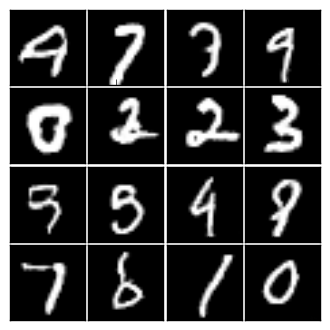

[442/500] D_loss: 1.5143 / G_loss: 0.9071


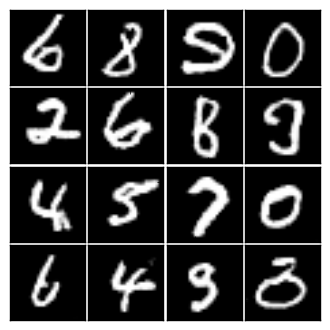

[443/500] D_loss: 1.5783 / G_loss: 1.0224


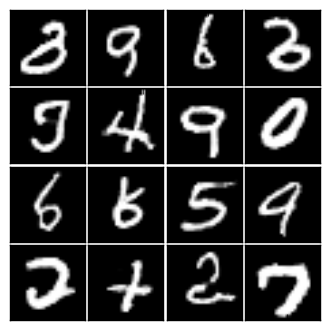

[444/500] D_loss: 1.3921 / G_loss: 0.8565


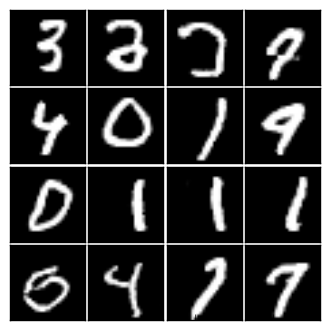

[445/500] D_loss: 1.4306 / G_loss: 0.7386


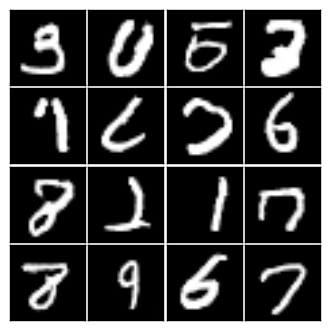

[446/500] D_loss: 1.4382 / G_loss: 0.7002


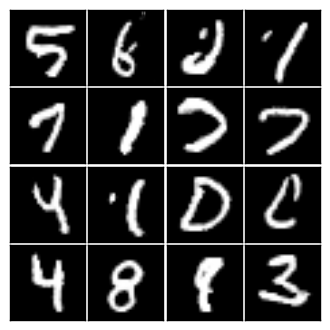

[447/500] D_loss: 1.3571 / G_loss: 0.7991


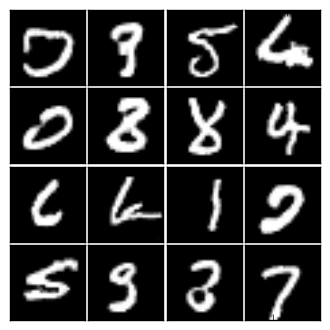

[448/500] D_loss: 1.4806 / G_loss: 0.6329


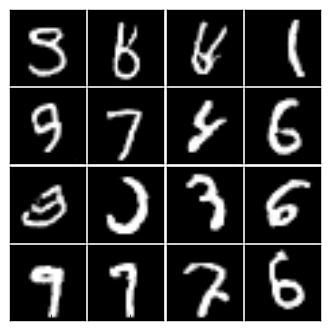

[449/500] D_loss: 1.4423 / G_loss: 1.0523


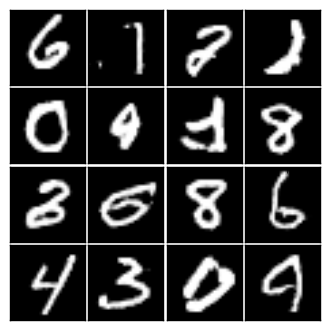

[450/500] D_loss: 1.5596 / G_loss: 1.0704


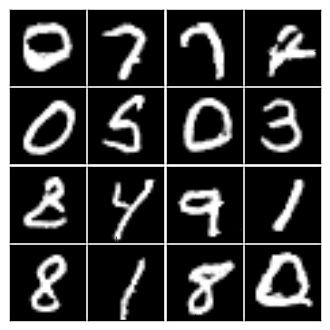

[451/500] D_loss: 1.4890 / G_loss: 0.8489


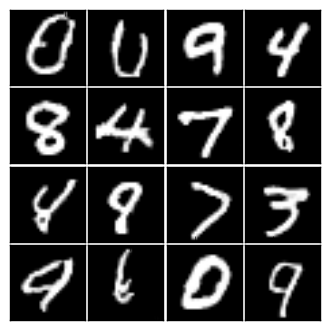

[452/500] D_loss: 1.4808 / G_loss: 0.9245


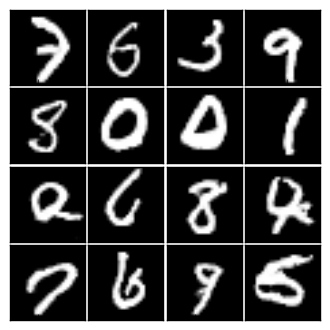

[453/500] D_loss: 1.4569 / G_loss: 0.6908


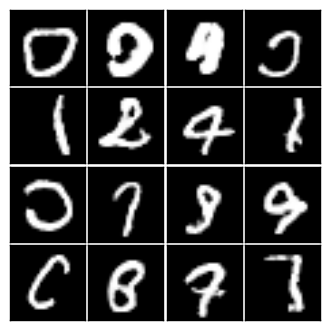

[454/500] D_loss: 1.4113 / G_loss: 0.8924


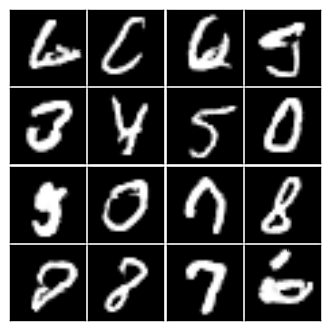

[455/500] D_loss: 1.4678 / G_loss: 0.6515


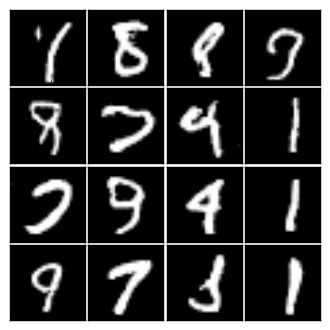

[456/500] D_loss: 1.4922 / G_loss: 0.6322


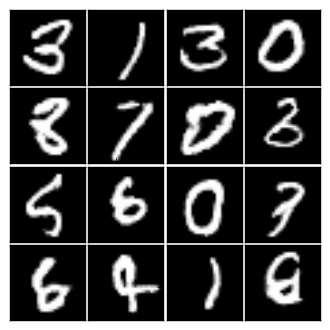

[457/500] D_loss: 1.5502 / G_loss: 0.4861


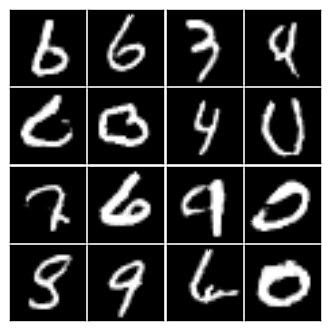

[458/500] D_loss: 1.4991 / G_loss: 0.5247


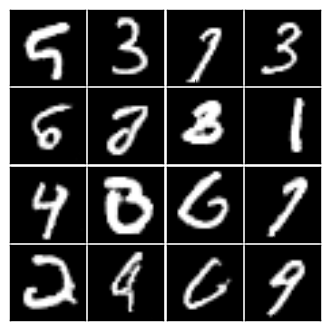

[459/500] D_loss: 1.4123 / G_loss: 0.7795


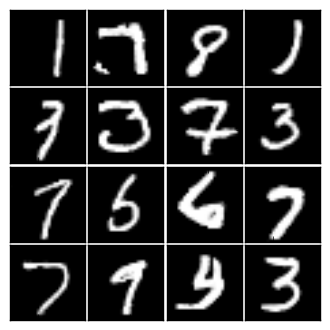

[460/500] D_loss: 1.3602 / G_loss: 0.8556


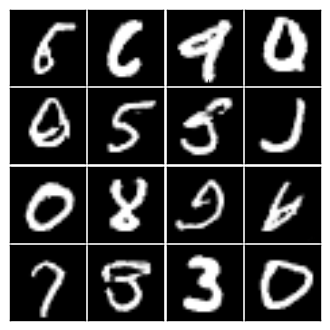

[461/500] D_loss: 1.5058 / G_loss: 0.5628


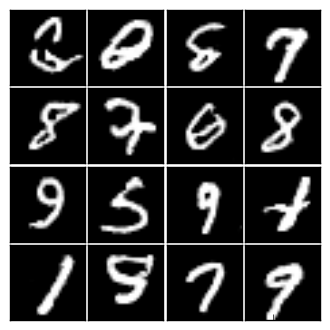

[462/500] D_loss: 1.4091 / G_loss: 0.7198


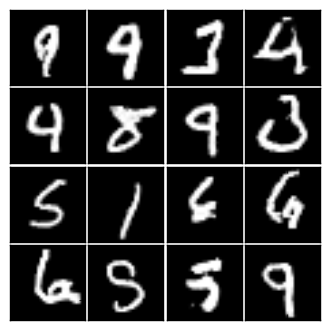

[463/500] D_loss: 1.6070 / G_loss: 1.3904


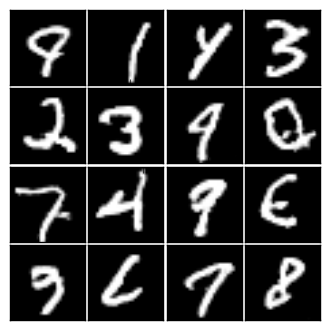

[464/500] D_loss: 1.5087 / G_loss: 1.1714


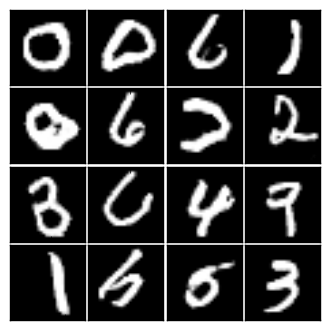

[465/500] D_loss: 1.6262 / G_loss: 1.2709


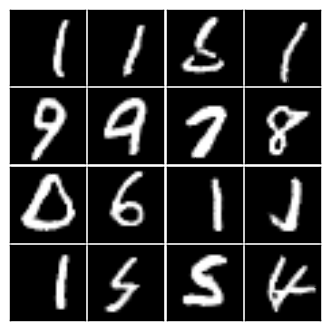

[466/500] D_loss: 1.4563 / G_loss: 0.7843


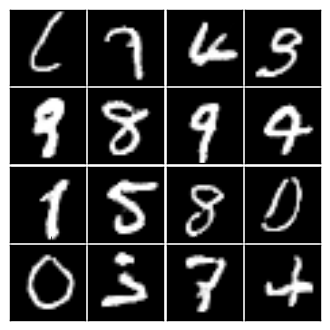

[467/500] D_loss: 1.4766 / G_loss: 0.5922


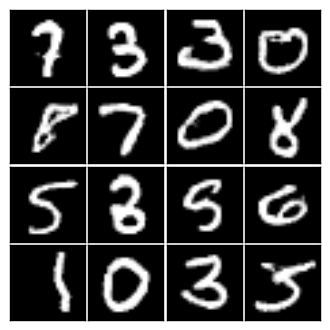

[468/500] D_loss: 1.3553 / G_loss: 0.7705


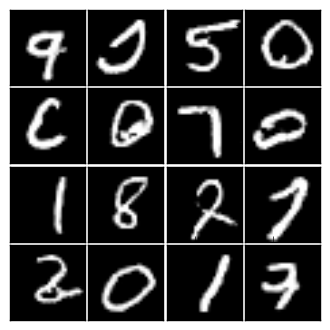

[469/500] D_loss: 1.6184 / G_loss: 1.1183


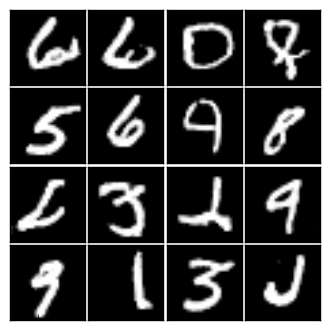

[470/500] D_loss: 1.5019 / G_loss: 1.1220


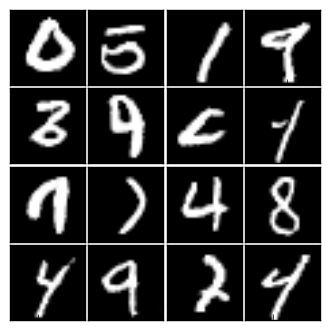

[471/500] D_loss: 1.4278 / G_loss: 0.6476


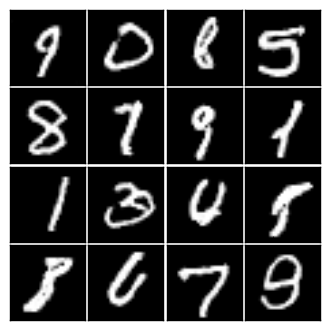

[472/500] D_loss: 1.4009 / G_loss: 0.9280


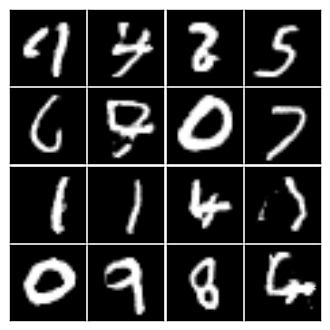

[473/500] D_loss: 1.4716 / G_loss: 0.5661


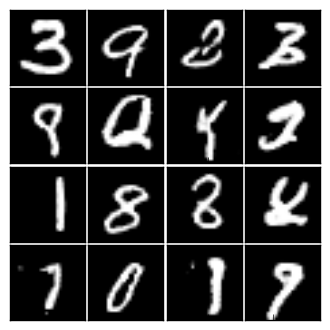

[474/500] D_loss: 1.5666 / G_loss: 0.4630


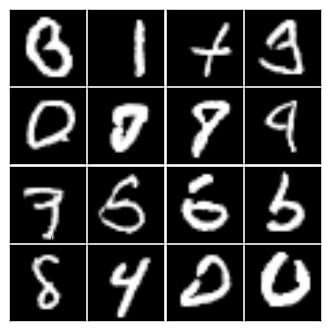

[475/500] D_loss: 1.4289 / G_loss: 0.6581


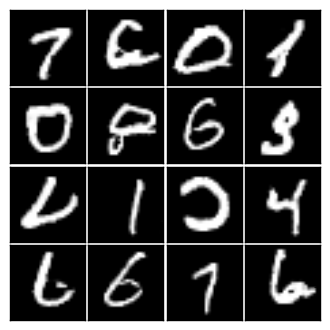

[476/500] D_loss: 1.3676 / G_loss: 0.8556


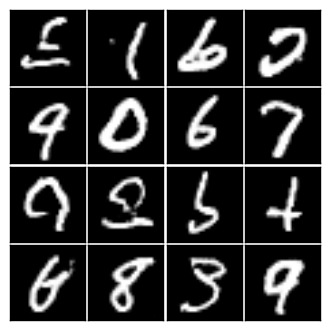

[477/500] D_loss: 1.5070 / G_loss: 1.1179


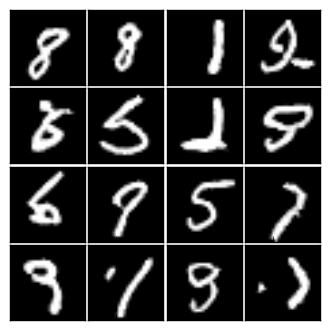

[478/500] D_loss: 1.3850 / G_loss: 0.8614


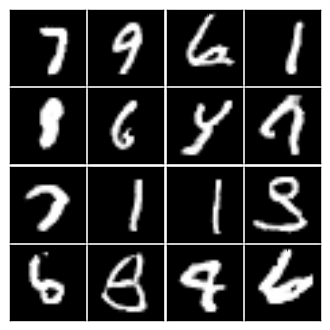

[479/500] D_loss: 1.3913 / G_loss: 0.7567


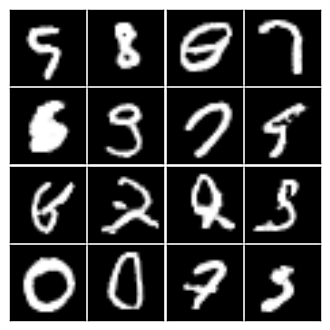

[480/500] D_loss: 1.4637 / G_loss: 0.6708


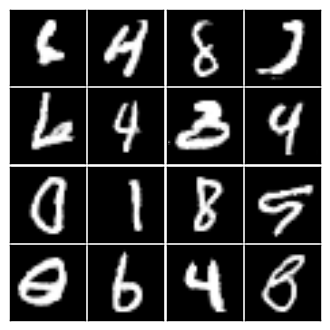

[481/500] D_loss: 1.4695 / G_loss: 0.7234


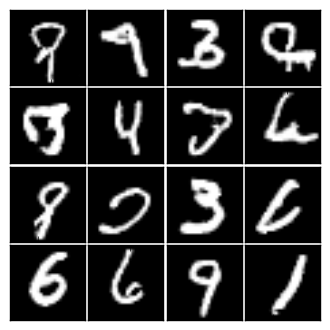

[482/500] D_loss: 1.4069 / G_loss: 1.0456


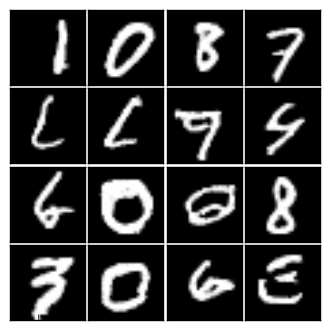

[483/500] D_loss: 1.3945 / G_loss: 0.7961


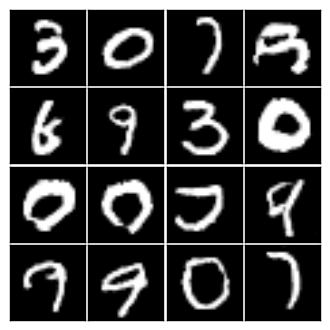

[484/500] D_loss: 1.4440 / G_loss: 0.6853


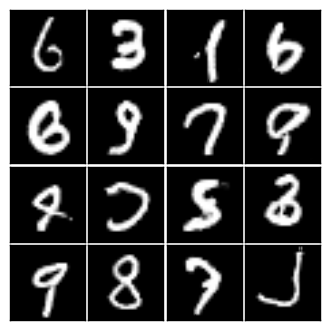

[485/500] D_loss: 1.6307 / G_loss: 1.4347


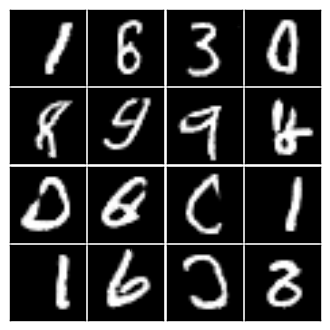

[486/500] D_loss: 1.4140 / G_loss: 0.6692


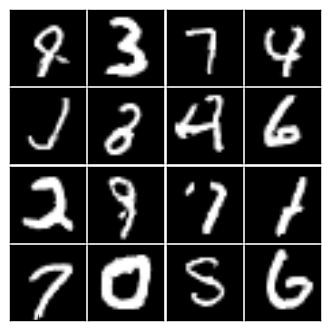

[487/500] D_loss: 1.4353 / G_loss: 0.7338


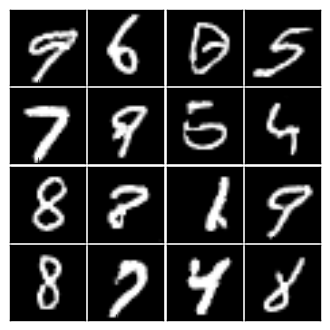

[488/500] D_loss: 1.3710 / G_loss: 0.7366


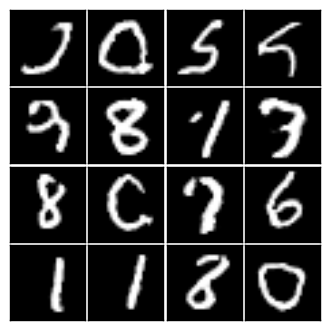

[489/500] D_loss: 1.4724 / G_loss: 0.8516


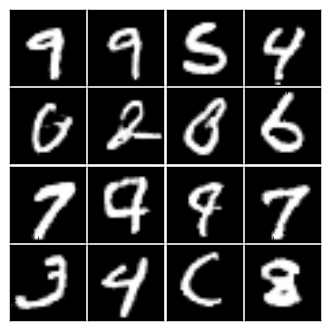

[490/500] D_loss: 1.5346 / G_loss: 0.9369


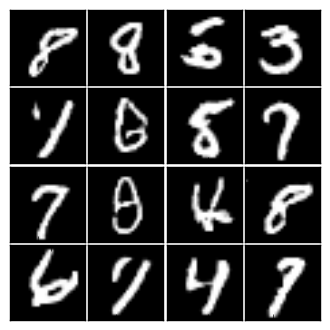

[491/500] D_loss: 1.5323 / G_loss: 0.5704


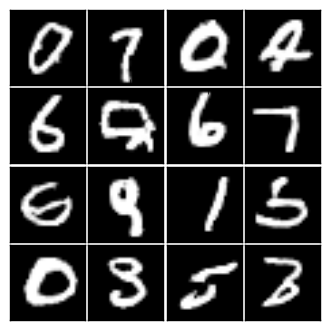

[492/500] D_loss: 1.4410 / G_loss: 0.6273


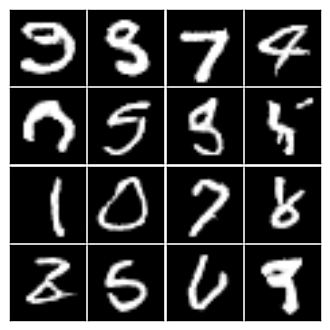

[493/500] D_loss: 1.5252 / G_loss: 0.6117


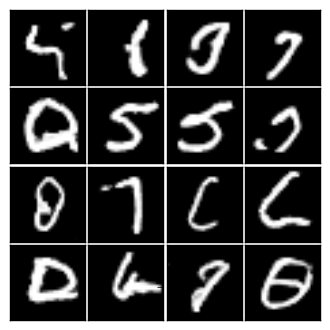

[494/500] D_loss: 1.3878 / G_loss: 0.7428


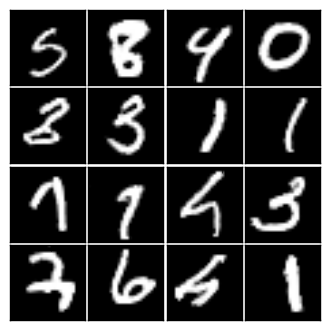

[495/500] D_loss: 1.5314 / G_loss: 1.2735


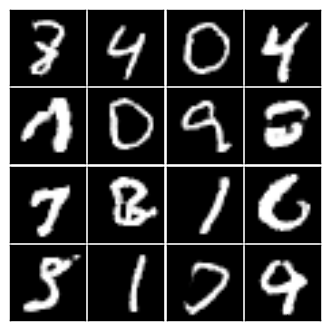

[496/500] D_loss: 1.4163 / G_loss: 0.6722


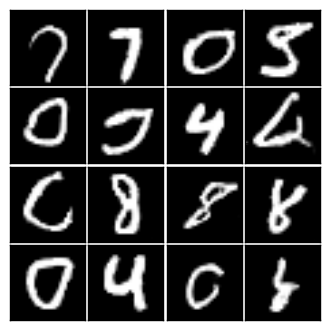

[497/500] D_loss: 1.5774 / G_loss: 0.4351


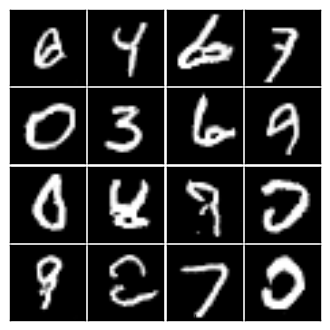

[498/500] D_loss: 1.5304 / G_loss: 0.8044


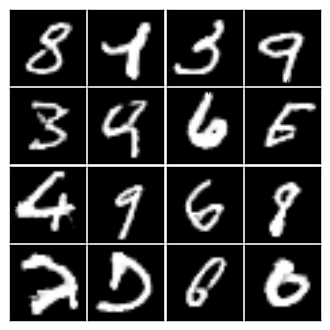

[499/500] D_loss: 1.3974 / G_loss: 0.8147


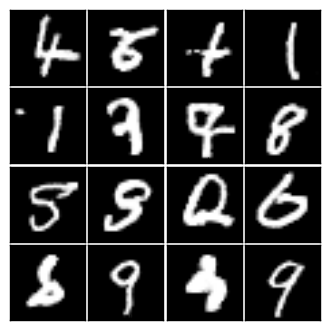

[500/500] D_loss: 1.4037 / G_loss: 0.7774


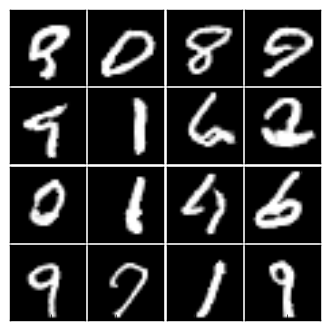

In [11]:
epoch_n = 500
batch_size = 64
N = mnist.train.num_examples

sess = tf.Session()
sess.run(tf.global_variables_initializer())

for epoch in range(epoch_n):
    for _ in range(N // batch_size):
        X_batch, Y_batch = mnist.train.next_batch(batch_size)

        # 'Z' 가 겹쳐도 상관 없을것 같다.
        feeds = {X: X_batch, Z: Z_sampler(batch_size, 100), training: True}
        _ = sess.run(D_solver, feeds)
        _ = sess.run(G_solver, feeds)
    
    # progress check
    # 1. loss check
    feeds[training] = False
    D_loss_cur = sess.run(D_loss, feeds)
    G_loss_cur = sess.run(G_loss, feeds)
    print("[{}/{}] D_loss: {:.4f} / G_loss: {:.4f}".format(epoch+1, epoch_n, D_loss_cur, G_loss_cur))
    
    # 2. sampling
    samples = sess.run(G_sample, {Z: Z_sampler(16, 100), training: False})
    fig = plot(samples)
    plt.show()

## for Others

In [ ]:
def Discriminator(self, input_dim, label_fn, name="Discriminator", num_hidden=4, activation_fn=lrelu, 
                 optimizer=tf.train.AdamOptimizer, lr=0.0002, reuse=False):
    with tf.variable_scope(name):
        self.X = tf.placeholder(tf.float32, [None, input_dim], name="X")
#             self.y = tf.placeholder(tf.float32, [None], name="y")
        self.training = tf.placeholder(tf.bool, name="training")

        # 이거쫌 문제가 있는듯. 이렇게 MNIST 한테 depedent 한게.
        net = tf.reshape(self.X, [-1, 28, 28, 1])
        n_filters = 64
        for i in range(num_hidden):
            with tf.variable_scope('D_layer{}'.format(i)):
                net = tf.layers.conv2d(inputs=net, filters=n_filters, kernel_size=[5, 5],
                                      strides=2, padding='SAME', use_bias=False, reuse=reuse)
                if i != num_hidden-1:
                    net = tf.layers.batch_normalization(net, training=self.training, reuse=reuse)
                net = activation_fn(net)

                n_filters *= 2

        # mnist
        # h0: 14x14x64
        # h1: 7x7x128
        # h2: 4x4x256
        # h3: 2x2x512

        net = tf.contrib.layers.flatten(net) # flatten
        logits = tf.layers.dense(net, 1, reuse=reuse) # FC layer, output_dim=1 
        labels = label_fn(logits)
        
#         self.loss = tf.nn.sigmoid_cross_entropy_with_logits(logits=logits, labels=labels)
#         self.loss = tf.reduce_mean(self.loss, name='loss') # reduce mean for batch

#         update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS, scope=name)
#         with tf.control_dependencies(update_ops):
#             self.train_op = optimizer(lr).minimize(self.loss)

#         sigmoid = tf.nn.sigmoid(self.logits, name='sigmoid')
#         self.accuracy = tf.equal(tf.round(sigmoid), labels)
#         self.accuracy = tf.reduce_mean(tf.cast(self.accuracy, tf.float42))

In [ ]:
# Generator 는 좀더 직관적으로 만들어보자.
class Generator:
    def __init__(self, z_dim=100):
        with tf.variable_scope("Generator"):
            self.Z = tf.placeholder(tf.float32, [None, z_dim], name="Z")
            self.training = tf.placeholder(tf.bool, name="training")

            with tf.variable_scope("project and reshape")
                net = tf.layers.dense(self.Z, 1024*4*4)
                net = tf.reshape(net, [-1, 4, 4, 1024])
            with tf.variable_scope("G_conv_1"):
                net = tf.layers.conv2d_transpose(net, 512, [5, 5], strides=2, padding='SAME', use_bias=False)
                net = tf.layers.batch_normalization(net, training=self.training)
                net = tf.nn.relu(net)
            with tf.variable_scope("G_conv_2"):
                net = tf.layers.conv2d_transpose(net, 256, [5, 5], strides=2, padding='SAME', use_bias=False)
                net = tf.layers.batch_normalization(net, training=self.training)
                net = tf.nn.relu(net)
            with tf.variable_scope("G_conv_3"):
                net = tf.layers.conv2d_transpose(net, 128, [5, 5], strides=2, padding='SAME', use_bias=False)
                net = tf.layers.batch_normalization(net, training=self.training)
                net = tf.nn.relu(net)
            with tf.variable_scope("G_conv_4"): # output layer
                net = tf.layers.conv2d_transpose(net, 3, [5, 5], strides=2, padding='SAME', use_bias=False)
                net = tf.nn.tanh(net)
            
            self.loss = 
                